In [1]:
# a=['id_sitio',
# 'corte_evento',
# 'Daily_Date',
# 'VolUnCorrected',
# 'VolCorrected',
# 'Pressure',
# 'Temperature',
# 'MaxPressure',
# 'MaxPressureTime',
# 'MinPressure',
# 'MinPressureTime',
# 'MaxFlow',
# 'maxFlowTime',
# 'MinFlow',
# 'MinFlowTime',
# 'MaxTemp',
# 'maxTempTime',
# 'MinTemp',
# 'MinTempTime',
# 'id_RTU']

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import datetime

In [3]:
def mytabla(data):
    nulls = pd.DataFrame(data.isnull().sum()/data.shape[0]*100, columns=['% de datos nulos'])
    ceros = pd.DataFrame((data==0).sum()/data.shape[0]*100, columns=['% de ceros'])
    tipo = pd.DataFrame(data.dtypes,columns=['Tipo de datos'])
    val = pd.DataFrame(data.nunique(),columns=['# de valores diferentes'])
    mis_val_table = pd.concat([nulls, ceros,tipo, val], axis=1)
    return mis_val_table

In [4]:
name = r"Diarios Cali 2014-2020.csv"

data =pd.read_csv(name,sep=',',error_bad_lines=False, warn_bad_lines= False,index_col=False,header=0, low_memory=False)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65298 entries, 0 to 65297
Data columns (total 8 columns):
id_sitio          65298 non-null int64
corte_evento      65298 non-null int64
Daily_Date        65298 non-null object
VolUnCorrected    65298 non-null float64
VolCorrected      65298 non-null float64
Pressure          65195 non-null float64
Temperature       65195 non-null float64
id_RTU            65195 non-null float64
dtypes: float64(5), int64(2), object(1)
memory usage: 4.0+ MB


In [6]:
data.head()


,id_sitio,corte_evento,Daily_Date,VolUnCorrected,VolCorrected,Pressure,Temperature,id_RTU
0,151,0,2014-01-01 23:59:59.000,1152.00,20260.21,243.31,26.78,17.0
1,151,0,2014-01-02 23:59:59.000,1385.99,23756.79,237.20,26.91,17.0
2,151,0,2014-01-03 23:59:59.000,1468.00,24852.37,234.31,26.98,17.0
3,151,0,2014-01-04 23:59:59.000,1444.00,24500.26,234.91,27.05,17.0
4,151,0,2014-01-04 23:59:59.000,1444.00,24500.26,234.91,27.05,17.0


In [7]:
# mytabla(data)

In [9]:
# data['MaxPressure'].value_counts()

In [10]:
def eliminar_coma(x):
    x=str(x).replace(',','.')
    return x

In [13]:

data['VolUnCorrected']=data['VolUnCorrected'].apply(eliminar_coma)
data['VolCorrected']=data['VolCorrected'].apply(eliminar_coma)
data['Pressure']=data['Pressure'].apply(eliminar_coma)
data['Temperature']=data['Temperature'].apply(eliminar_coma)


convert = {'id_sitio':'object',
          'VolUnCorrected':float,
          'VolCorrected':float,
          'Pressure':float,
          'Temperature':float,
          'id_RTU':'object'}
data = data.astype(convert)

## desde este punto se puede entender mejor lo que hay en la BD

In [14]:
data.shape

(65298, 8)

In [15]:
# data.dtypes

In [16]:
mytabla(data)

,% de datos nulos,% de ceros,Tipo de datos,# de valores diferentes
id_sitio,0.000000,0.000000,object,28
corte_evento,0.000000,100.000000,int64,1
Daily_Date,0.000000,0.000000,object,2453
VolUnCorrected,0.000000,4.465680,float64,46844
VolCorrected,0.000000,4.614230,float64,61450
Pressure,0.157738,0.278722,float64,9022
Temperature,0.157738,0.261876,float64,2478
id_RTU,0.157738,0.000000,object,26


In [17]:
numer = data.select_dtypes([float])
objeto= data.select_dtypes(['object'])

In [18]:
# numer.describe()

In [21]:
# objeto.describe()

In [22]:
data.duplicated().sum()

76

In [23]:
data.drop_duplicates(inplace=True)

In [24]:
data.columns

Index(['id_sitio', 'corte_evento', 'Daily_Date', 'VolUnCorrected',
       'VolCorrected', 'Pressure', 'Temperature', 'id_RTU'],
      dtype='object')

C:\Users\jibar\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


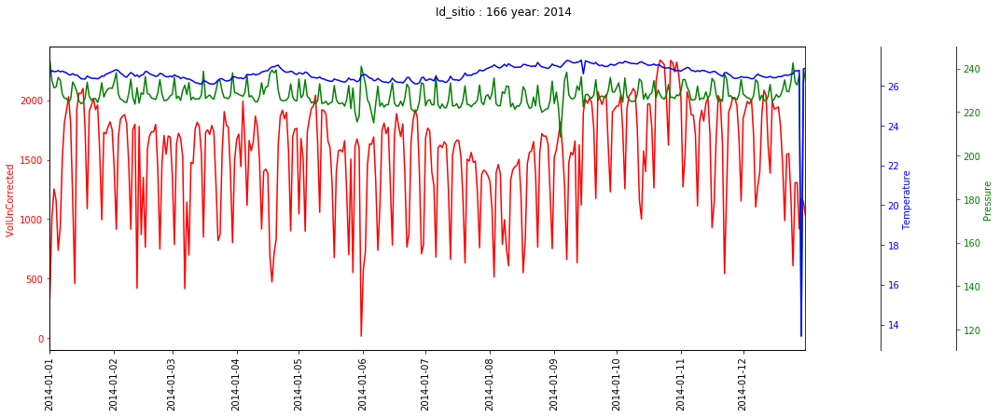

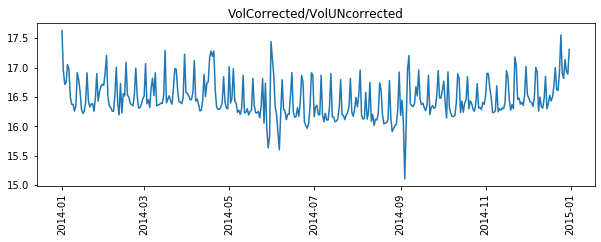

In [25]:
id_rtu =166
data['Daily_Date']   = pd.to_datetime(data['Daily_Date'])
data['Day'] =data['Daily_Date'].dt.date
data['Year'] =data['Daily_Date'].dt.year
def todo_en(id_sitio=166, year = 2014):
    p = (data[data['id_sitio']==id_sitio]).copy() 

    p.sort_values(by='Day', inplace=True)

    p.set_index('Daily_Date', inplace=True)





    variable = ('VolUnCorrected','Pressure','Temperature')
#     for i in p['Year'].unique():
    
    y = (p[p['Year']==year]).copy()
    fig, ax = plt.subplots(figsize = (18,6))

    # Twin the x-axis twice to make independent y-axes.
    axes = [ax, ax.twinx(),ax.twinx() ]

    # Make some space on the right side for the extra y-axis.
    fig.subplots_adjust(right=0.75)

    # Move the last y-axis spine over to the right by 20% of the width of the axes
    axes[-1].spines['right'].set_position(('axes', 1.1))
    axes[-2].spines['right'].set_position(('axes', 1.2))

    # To make the border of the right-most axis visible, we need to turn the frame
    # on. This hides the other plots, however, so we need to turn its fill off.
    axes[-1].set_frame_on(True)
    axes[-1].patch.set_visible(False)

#          And finally we get to plot things...
    colors = ('Red', 'Green', 'Blue')

#         for ax, color , variable in zip(axes, colors, variable):
    for ax, color , variable in zip(axes, colors, variable):

        ax.plot(y['Day'], y[variable], color=color)
        ax.set_ylabel('%s ' % variable, color=color)
        ax.tick_params(axis='y', colors=color)
        ax.set_xlim([datetime.date(year, 1, 1), datetime.date(year, 12, 31)])
        xlabels = y['Day']
        ax.set_xticklabels(xlabels, Rotation= 90 )
        print('-'*100)
        print('# de valores nulos en la serie {} : {}'.format(variable,y[variable].isnull().sum()) ,variable,y[variable][y[variable].isnull()])



        fig.suptitle('Id_sitio : {} year: {}'.format(id_sitio,year))
    plt.figure(figsize=(10,3))
    plt.plot(y['Day'], y['VolCorrected']/y['VolUnCorrected'])
    plt.title('VolCorrected/VolUNcorrected')
    plt.xticks(rotation=90)
    
    
    
    
    
    
    
    
    
    
    
    
    
    
    plt.show()

todo_en()

In [26]:
# data['Daily_Date'].dt.year.unique()xticks

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


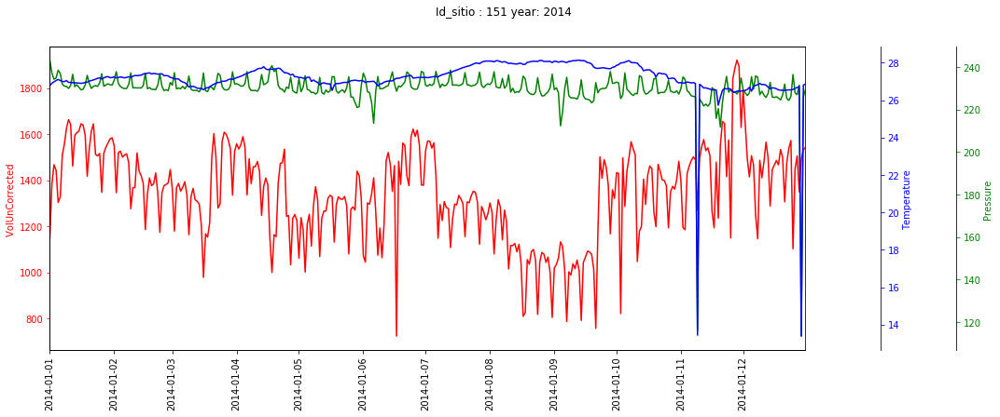

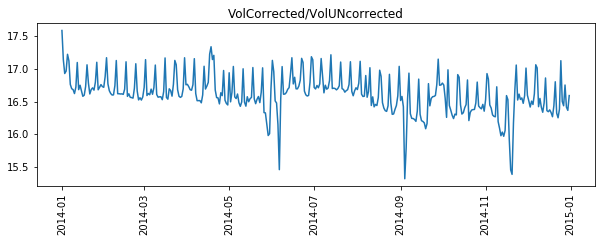

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


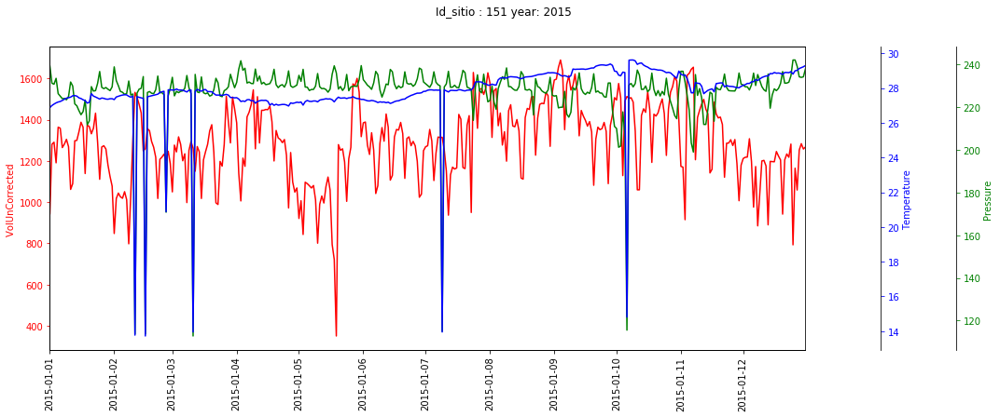

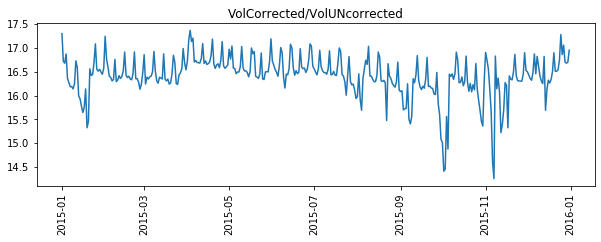

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


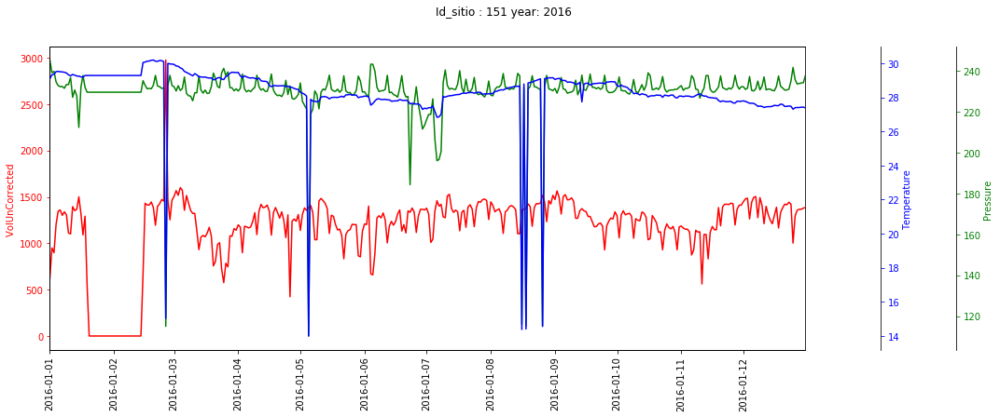

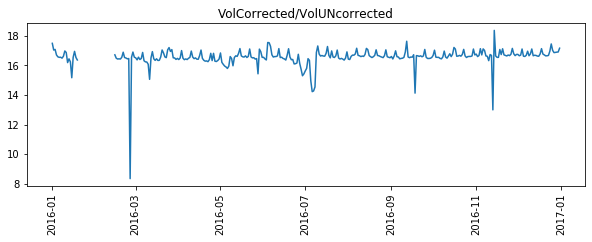

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


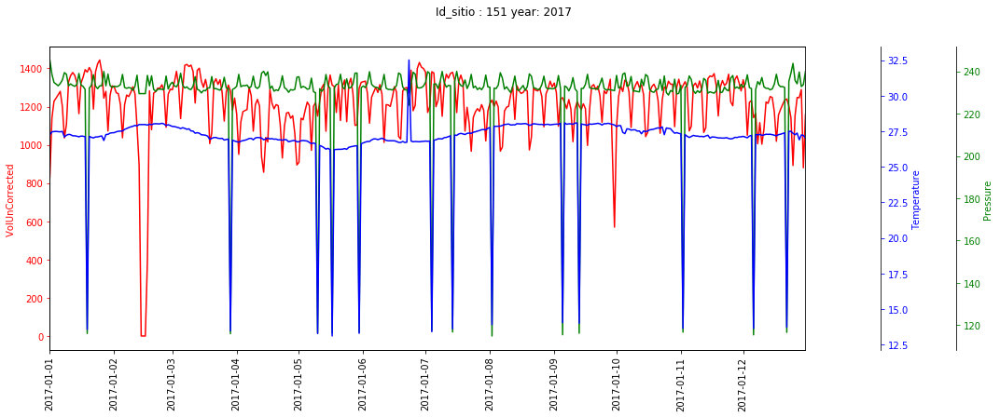

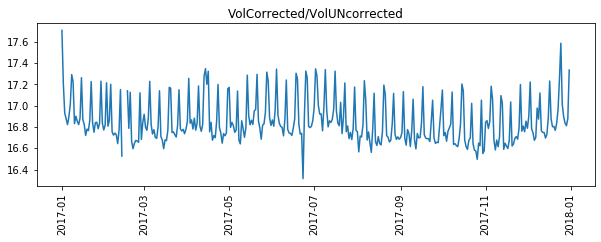

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


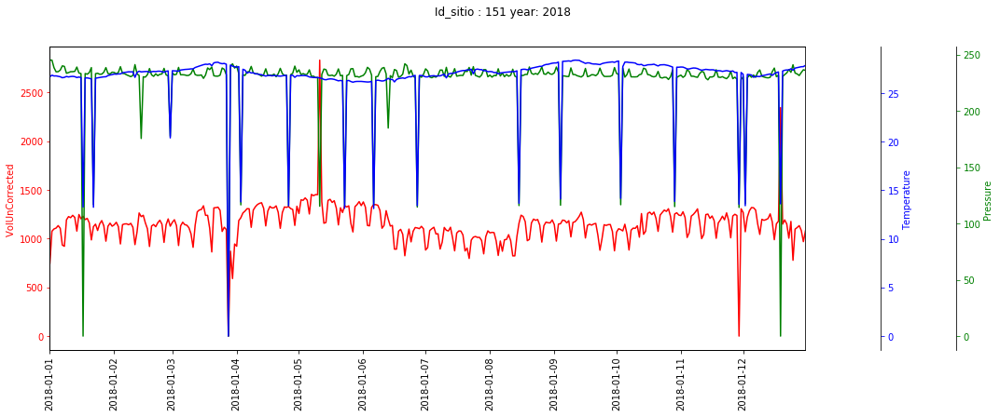

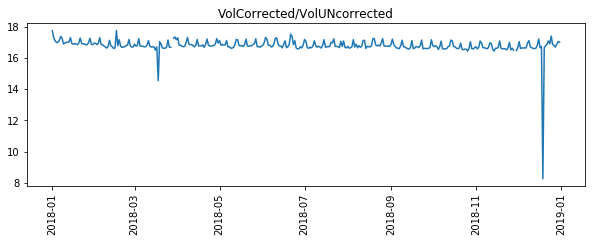

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


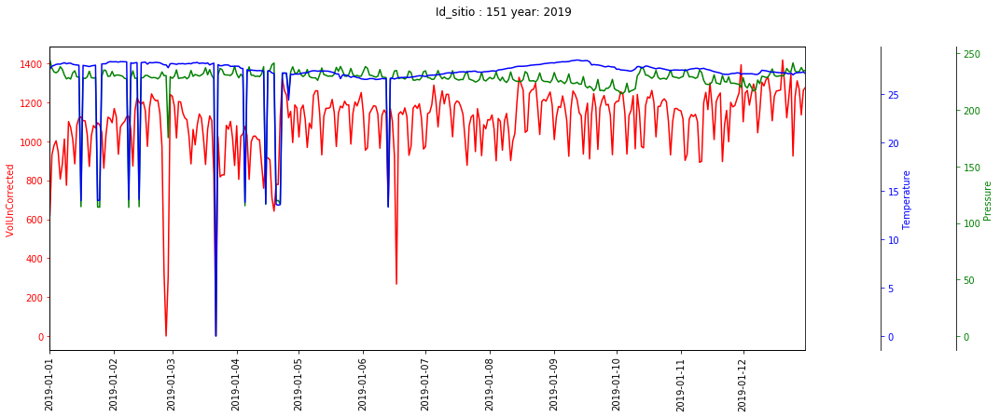

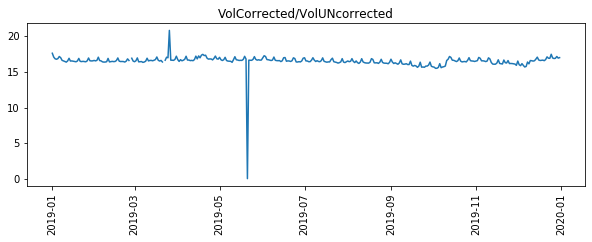

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


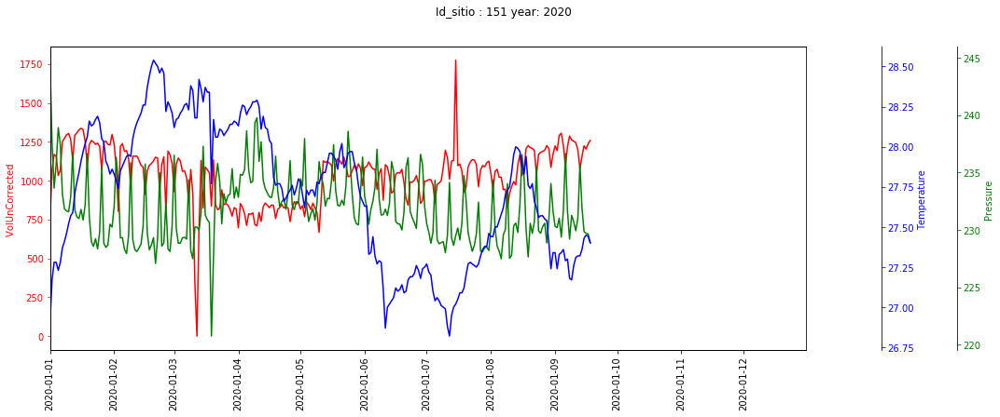

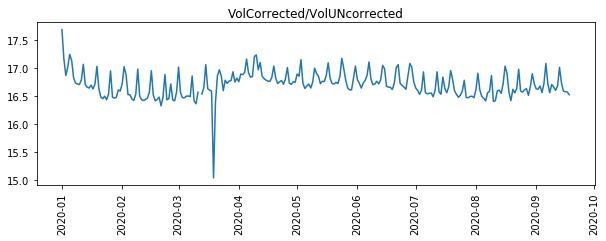

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


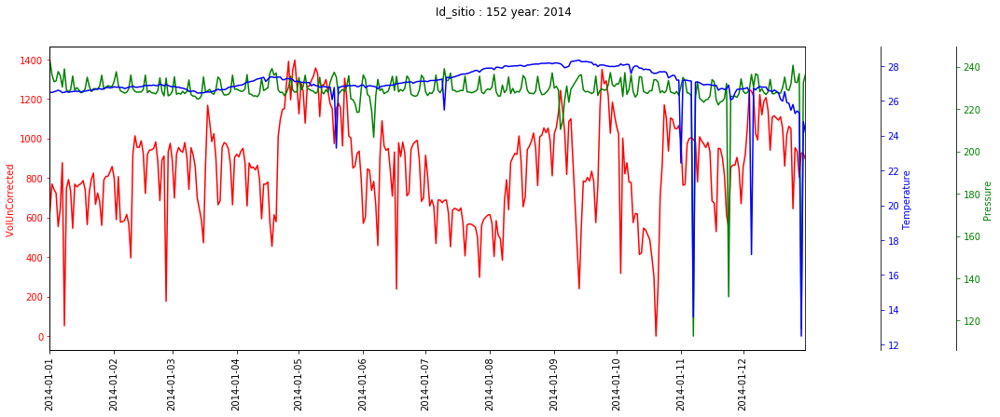

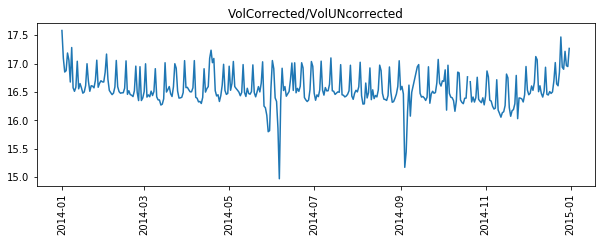

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


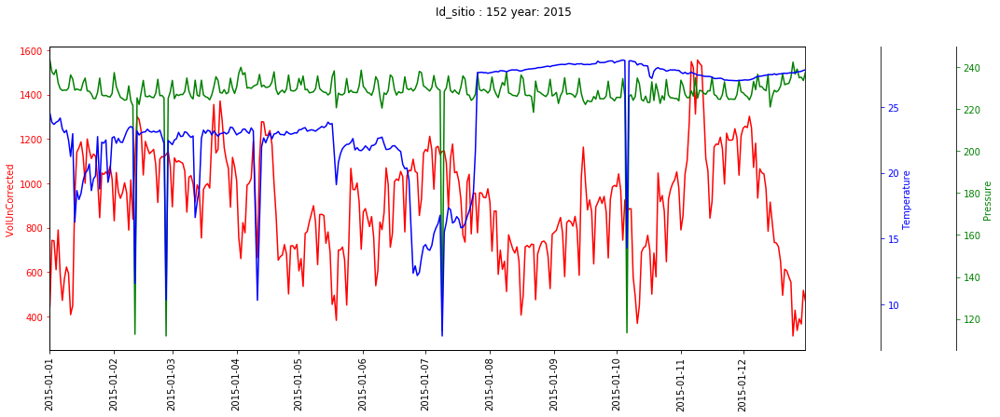

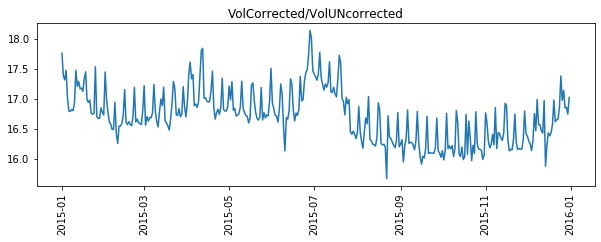

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


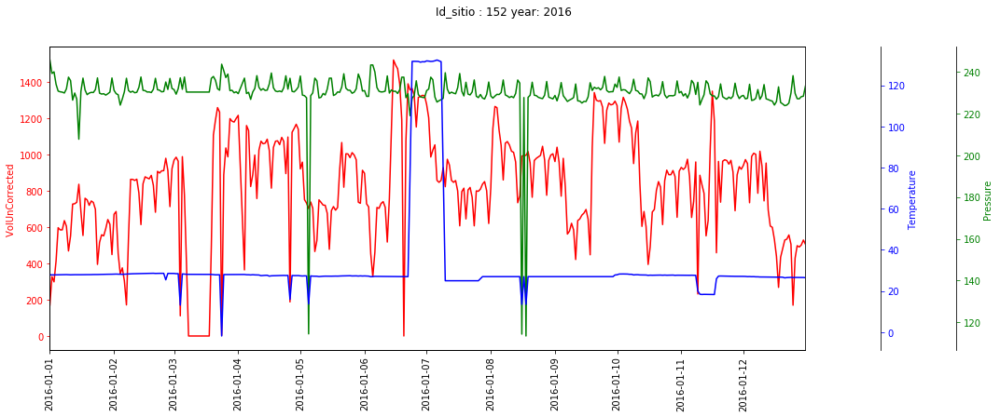

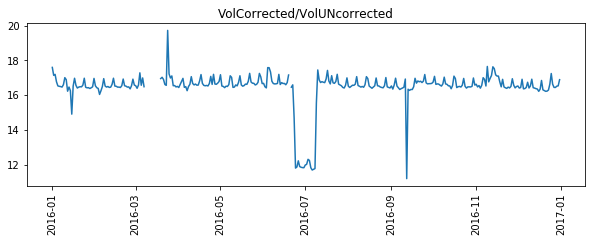

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


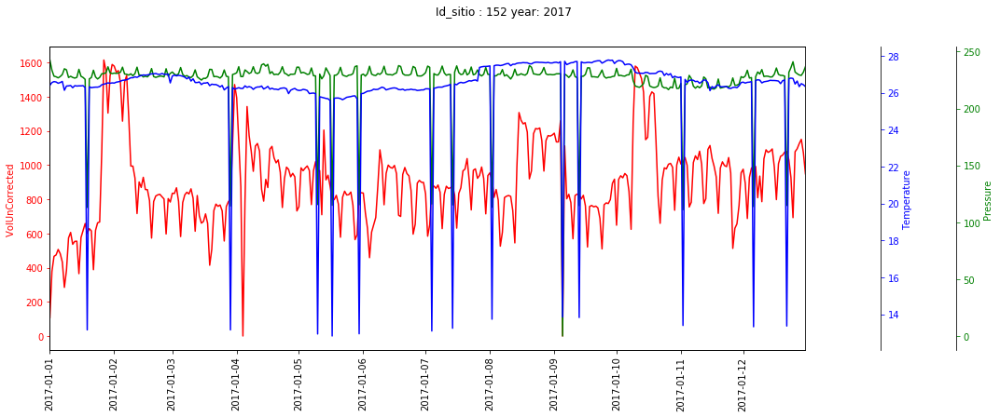

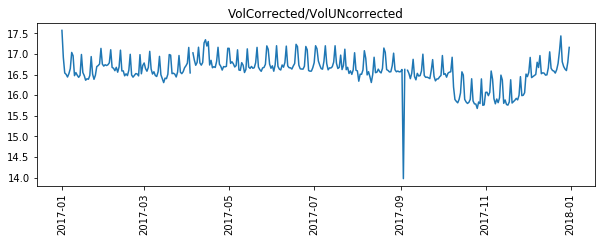

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


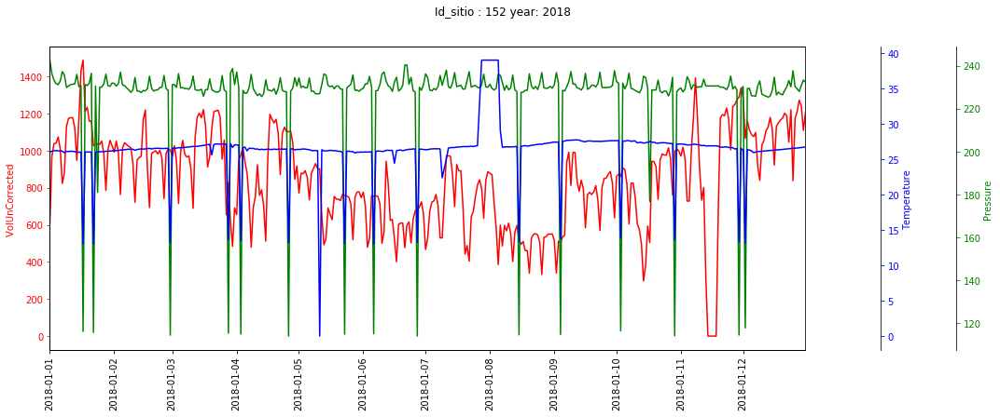

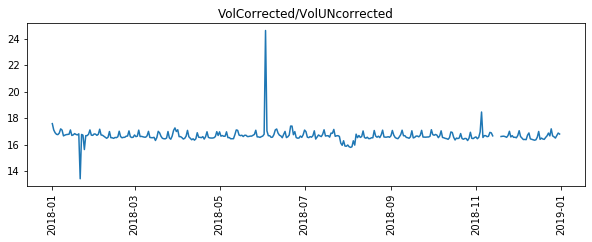

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


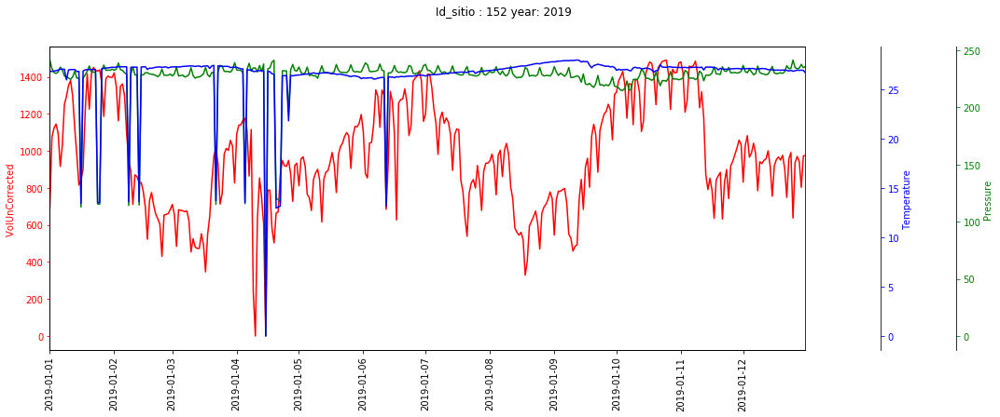

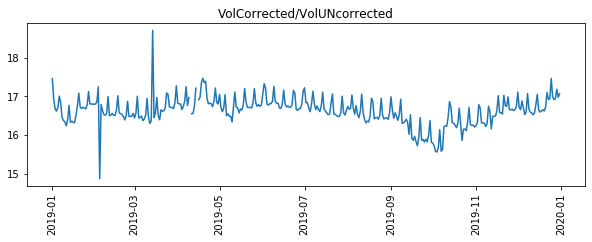

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


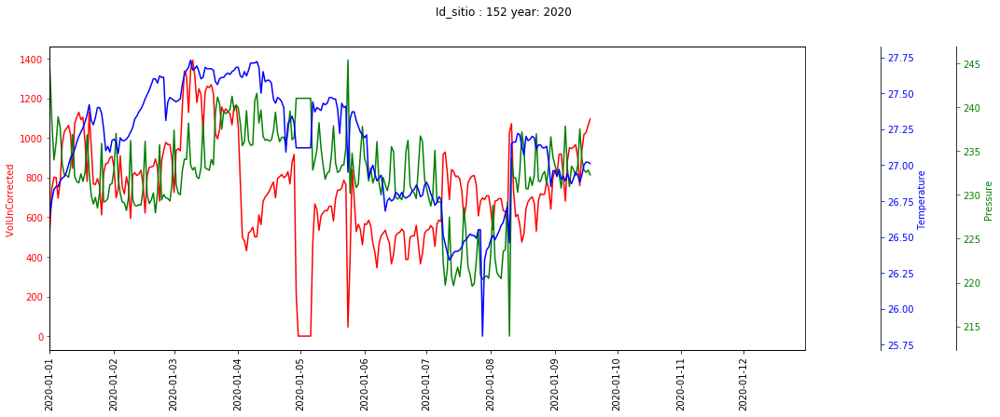

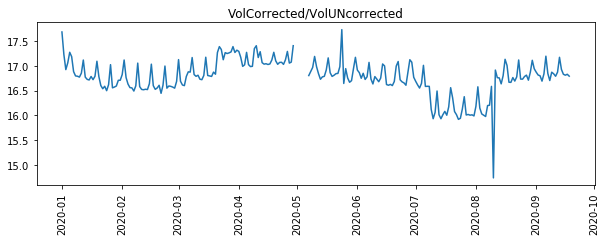

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


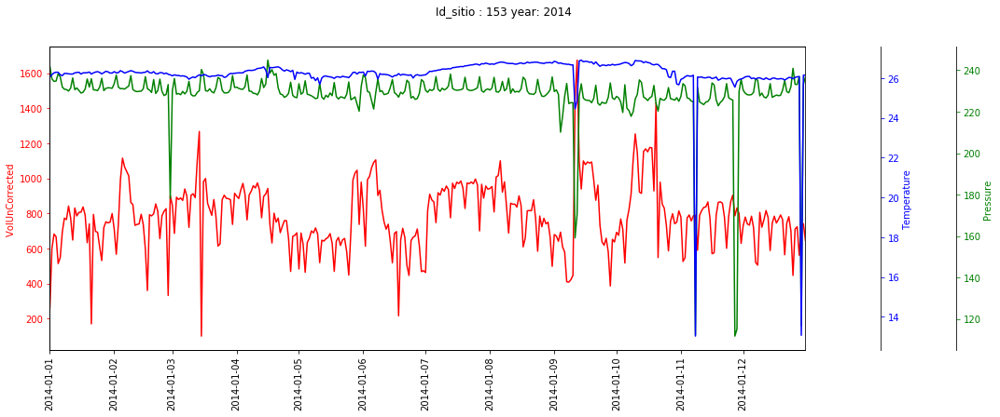

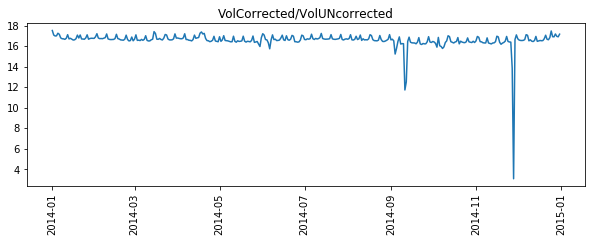

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


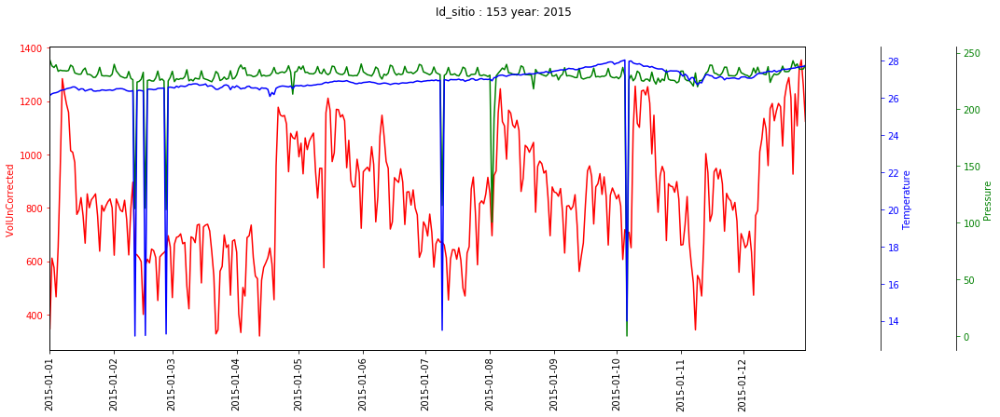

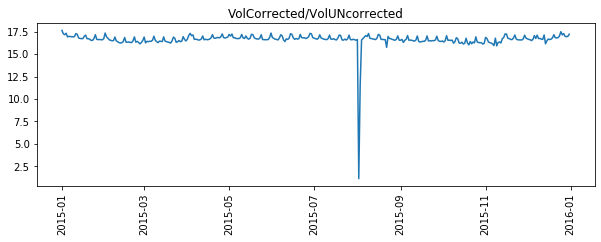

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


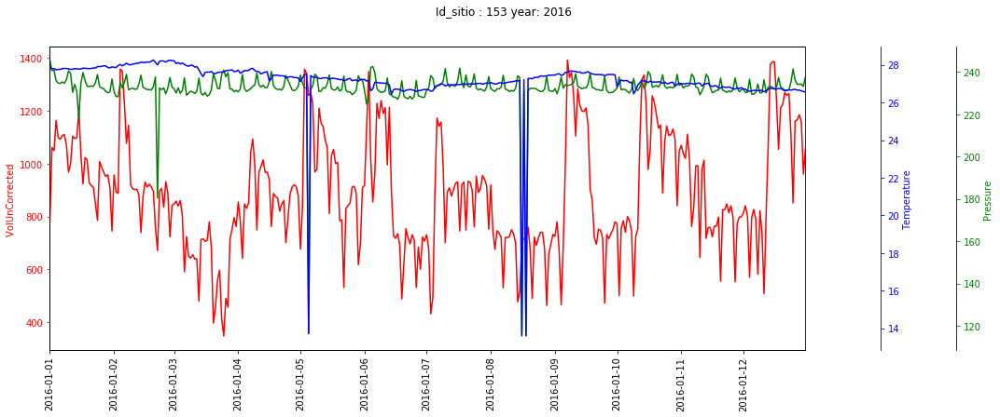

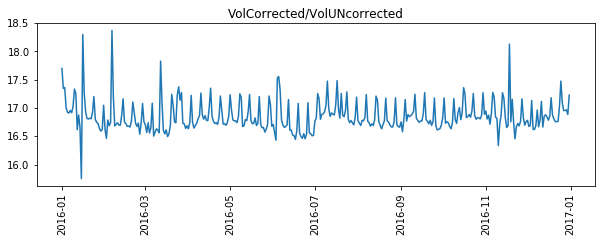

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


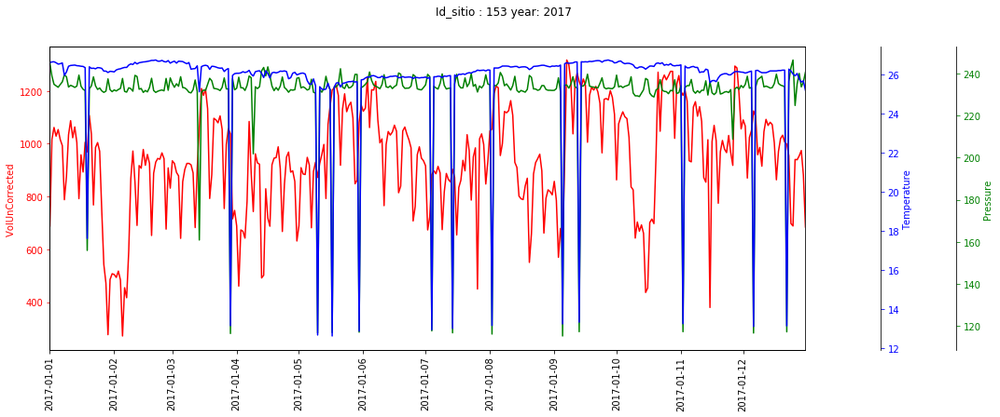

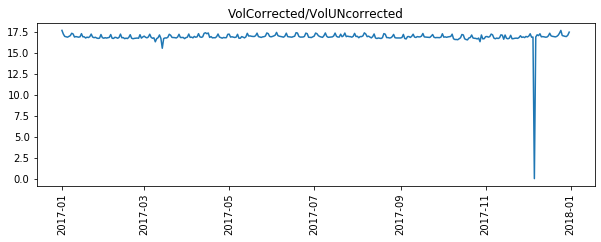

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


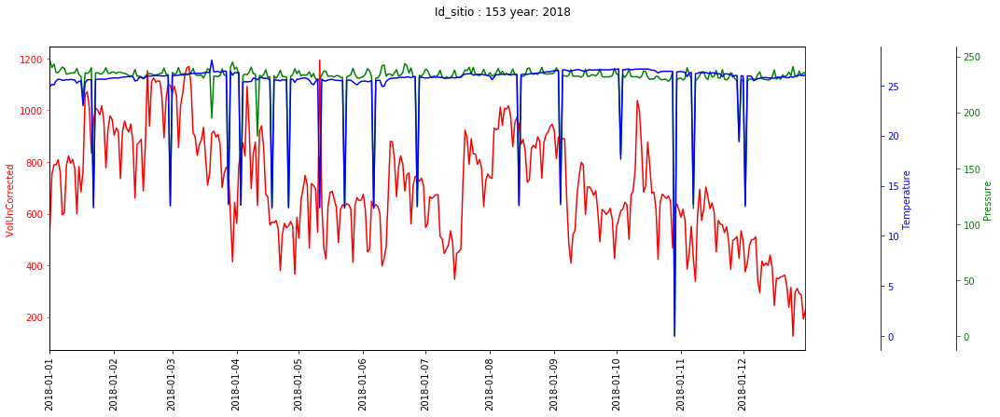

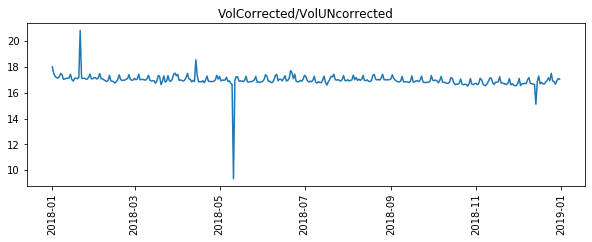

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


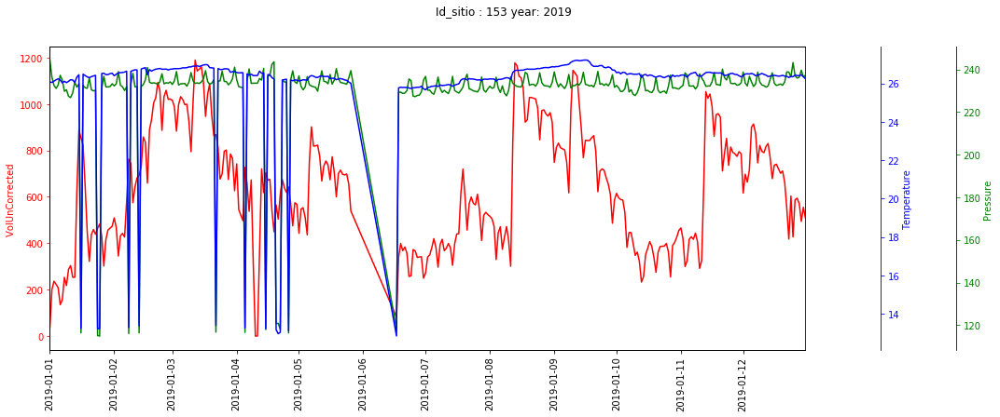

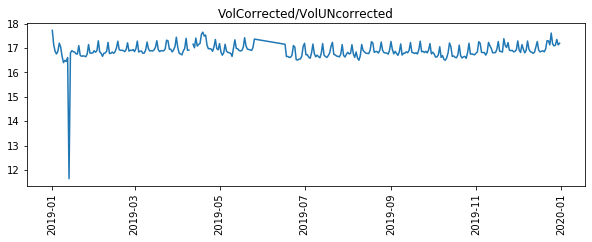

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


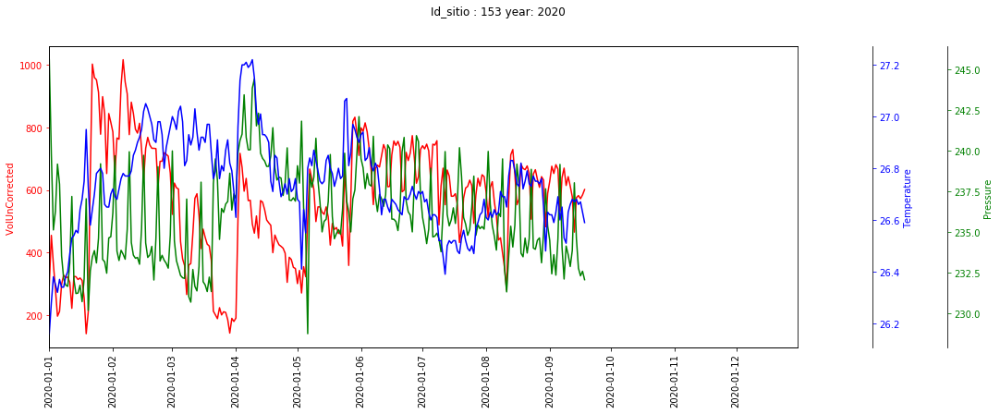

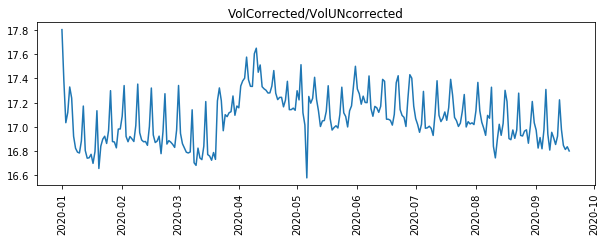

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


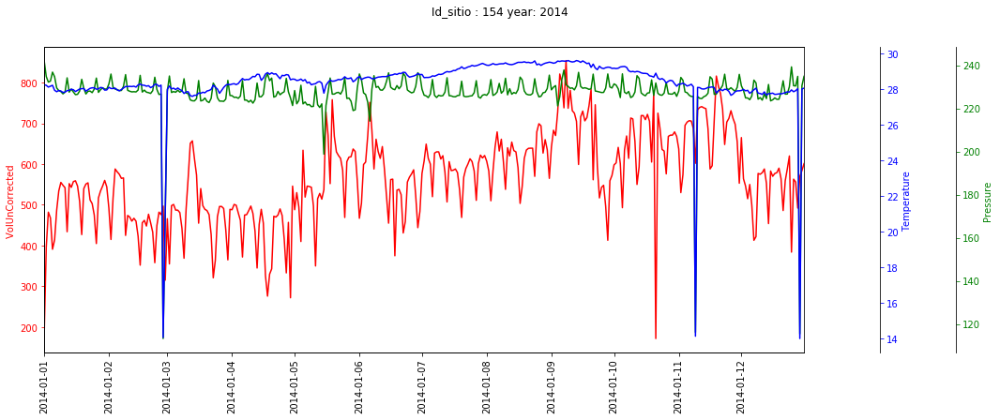

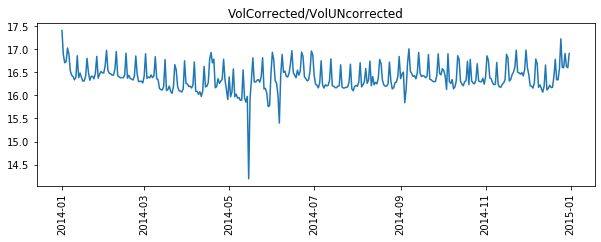

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


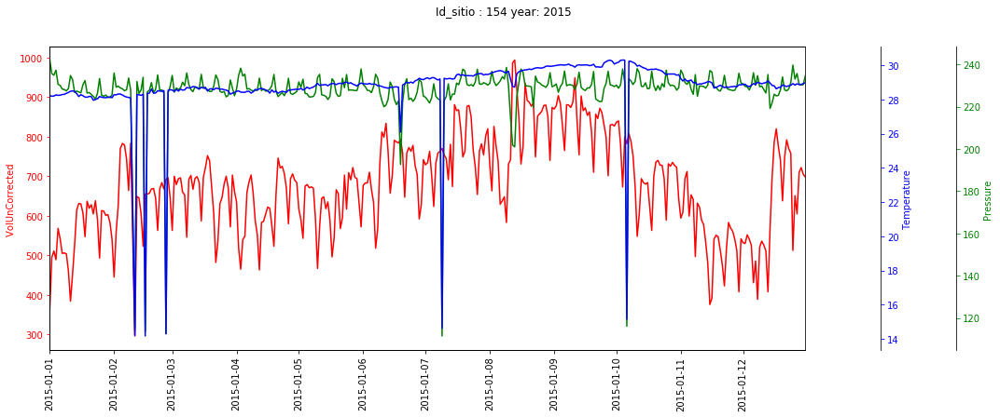

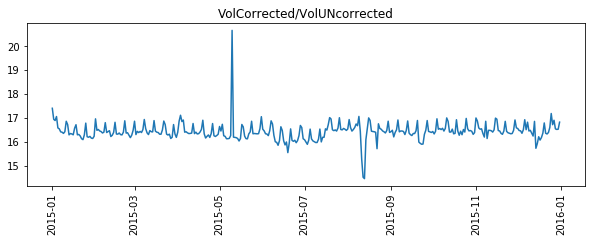

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


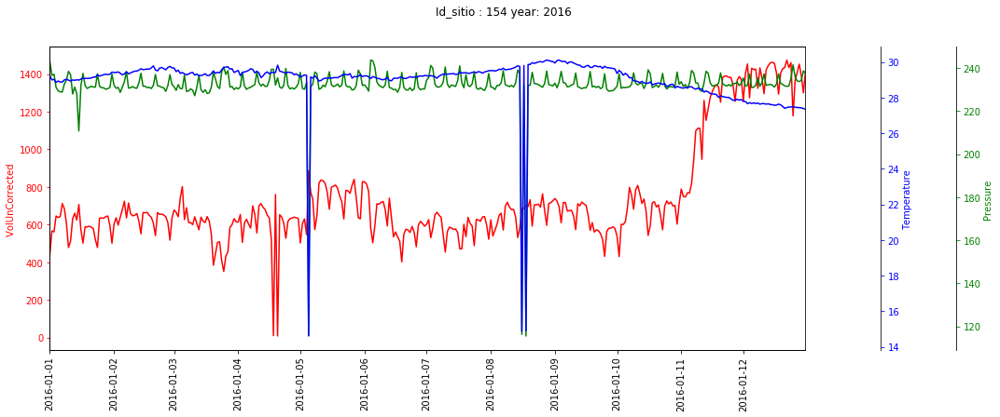

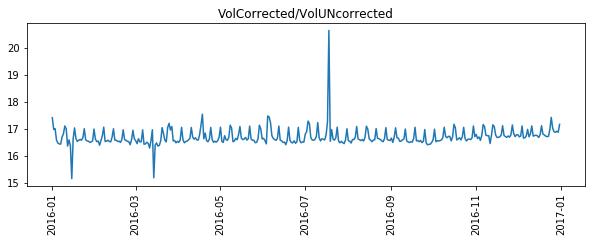

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


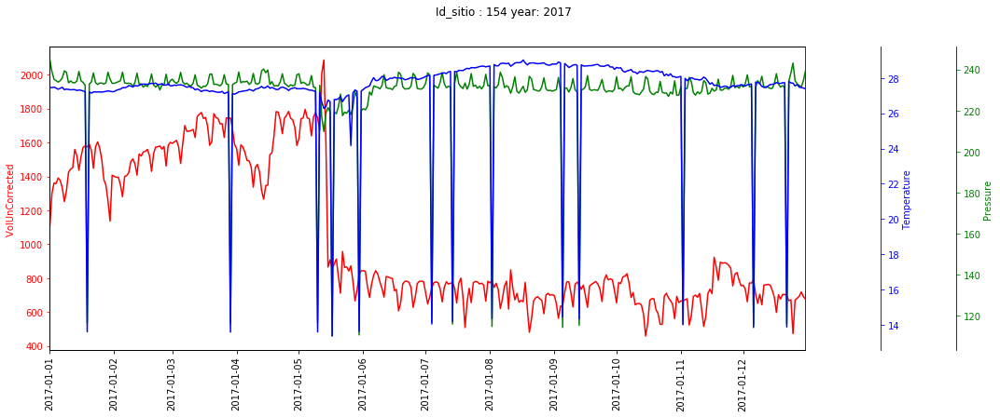

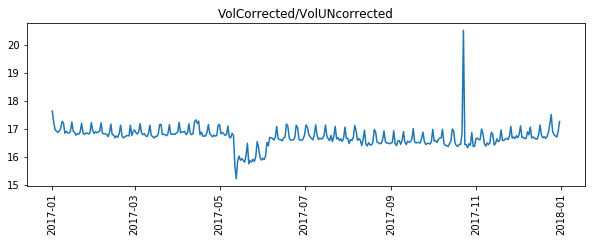

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


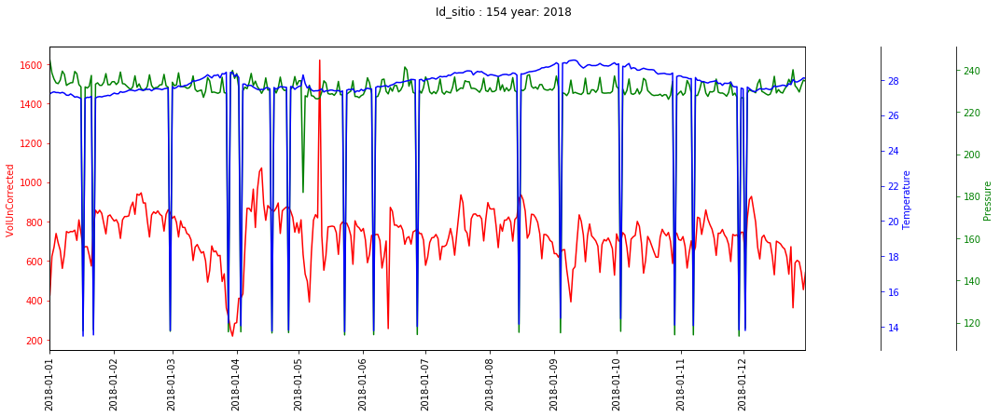

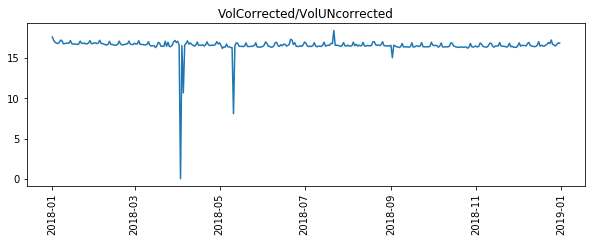

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


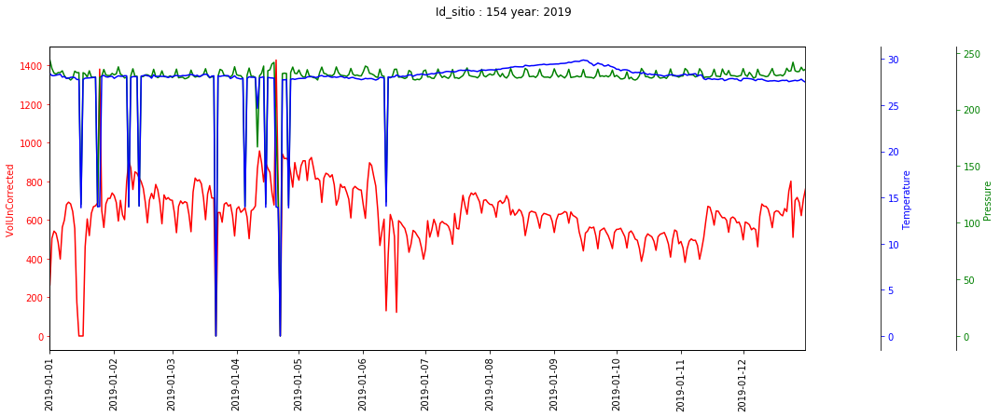

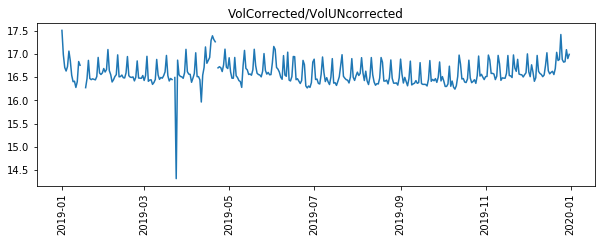

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


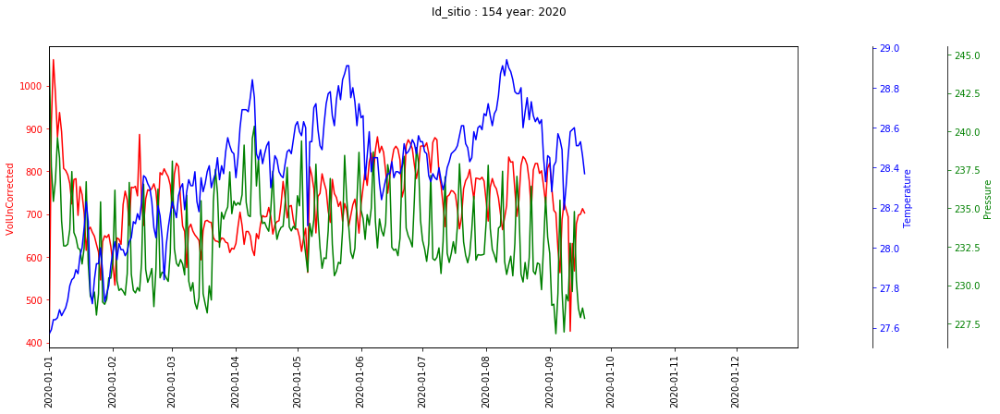

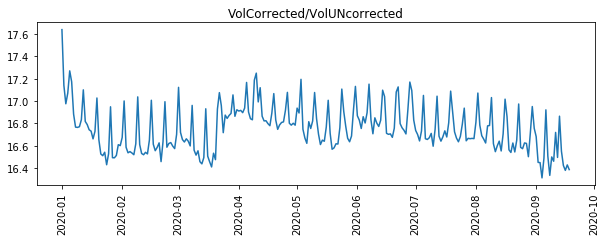

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


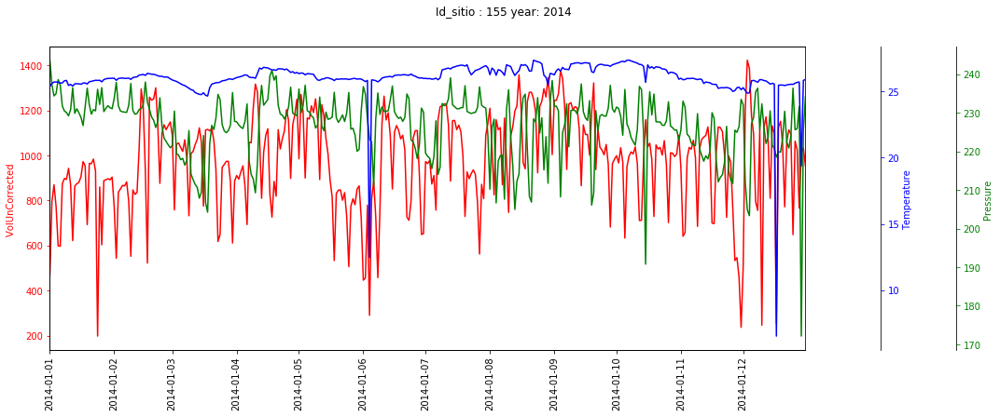

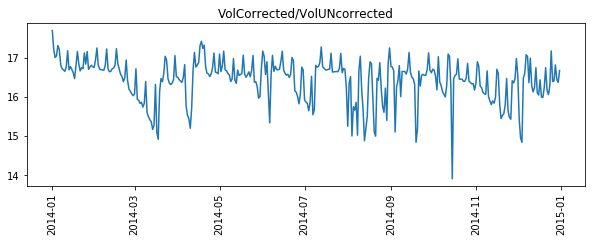

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


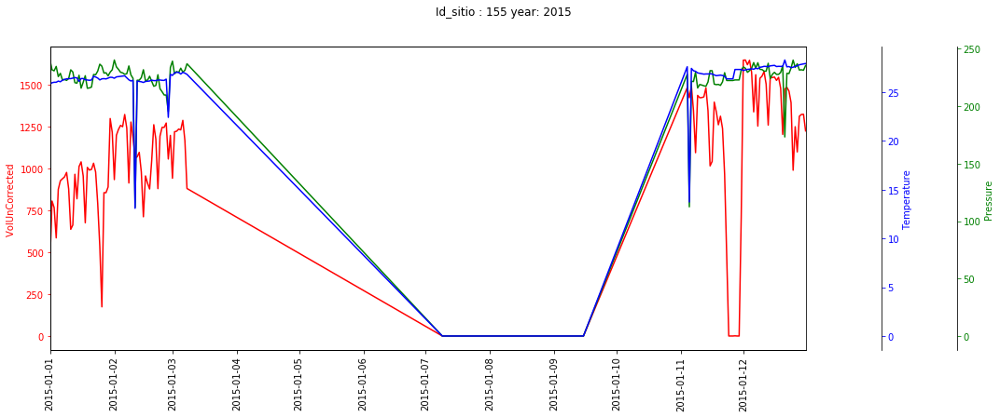

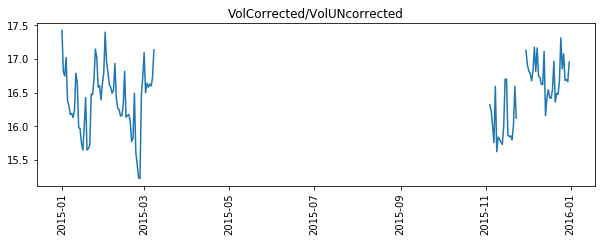

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


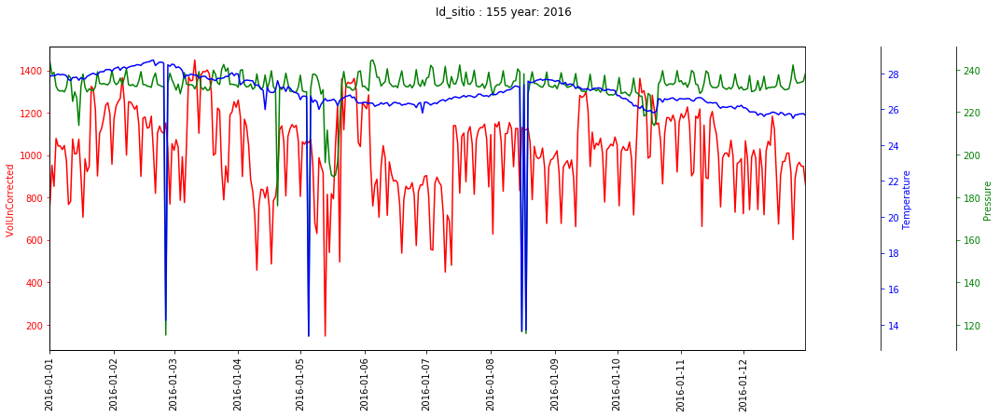

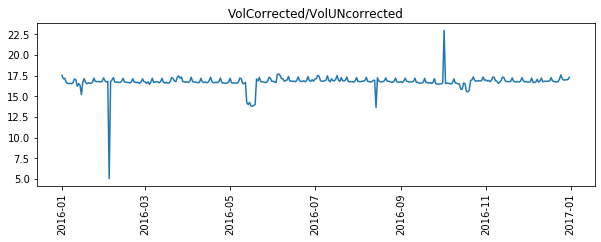

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


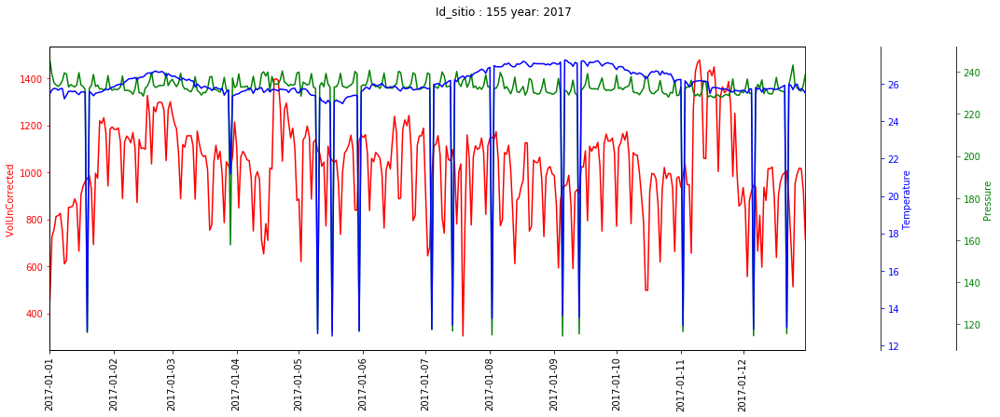

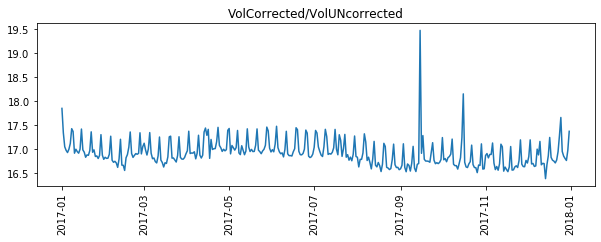

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


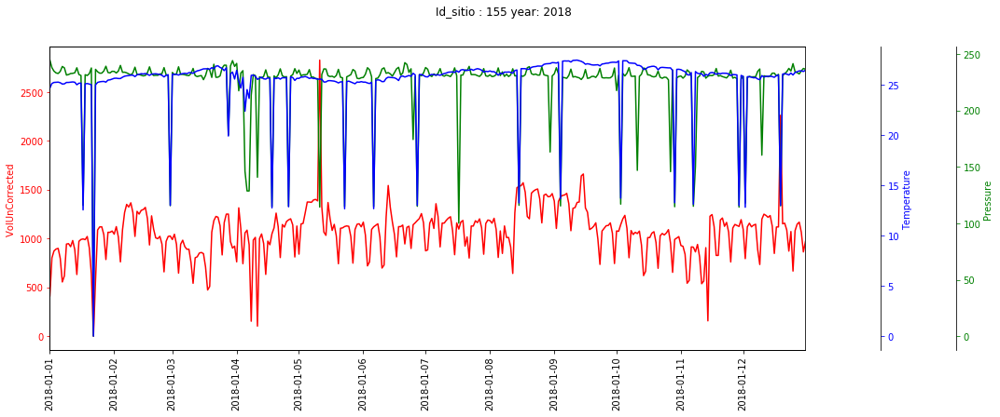

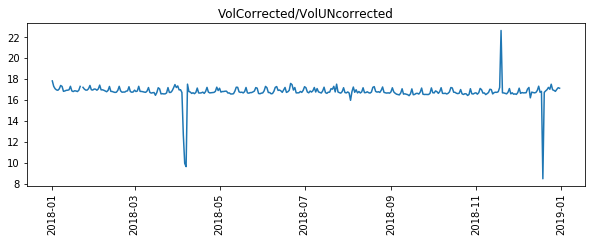

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


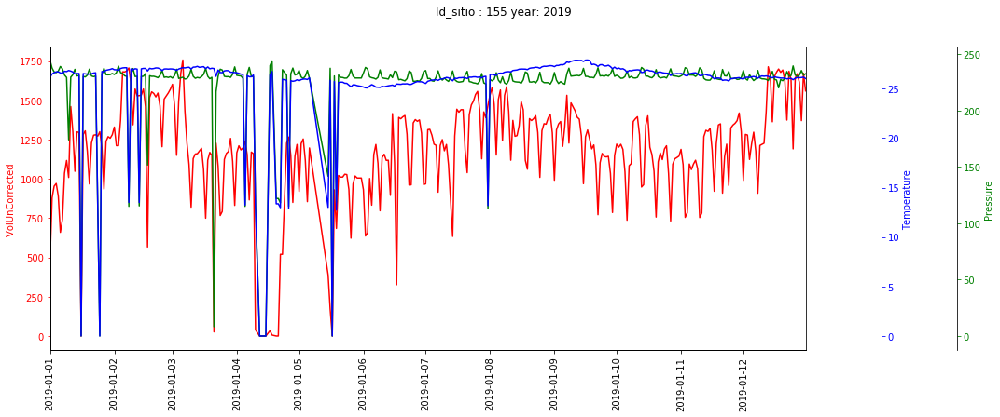

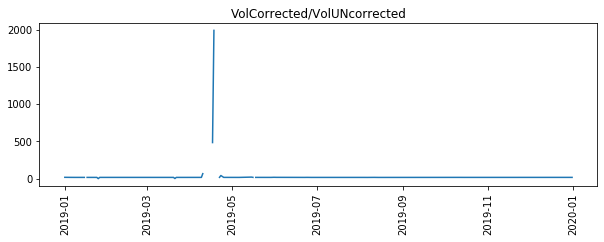

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


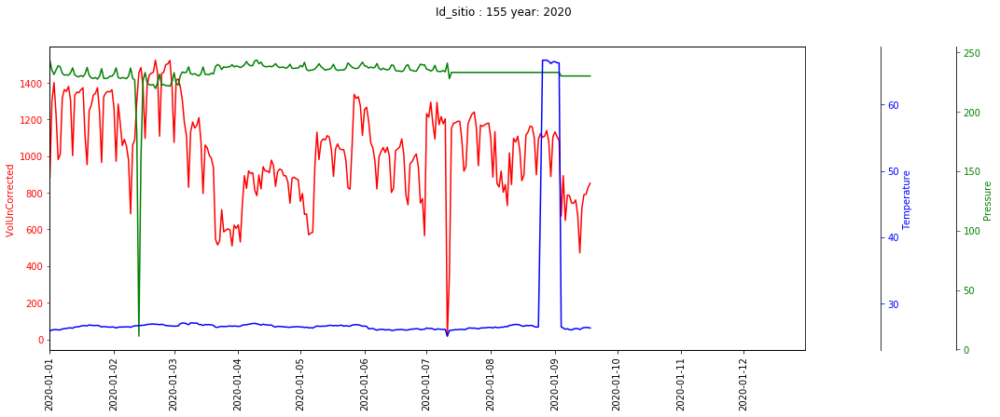

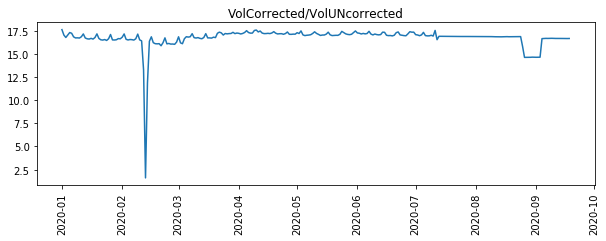

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


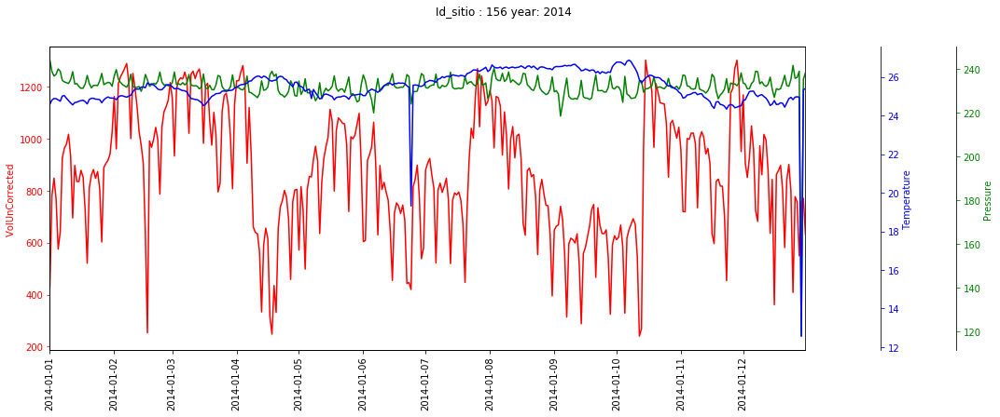

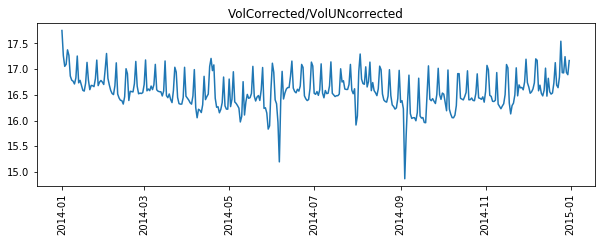

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


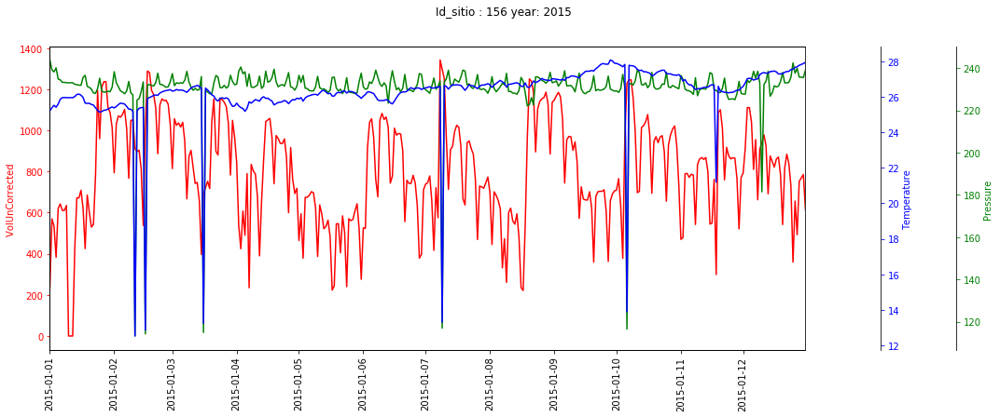

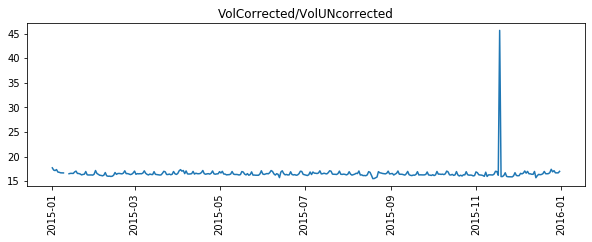

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


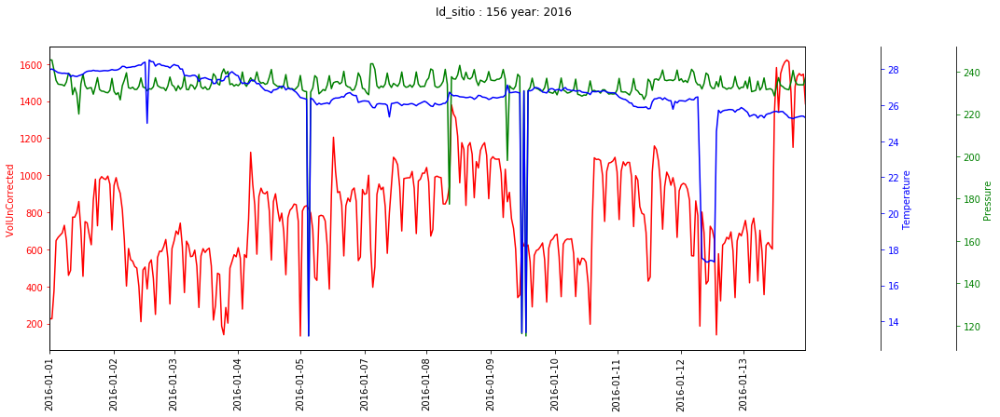

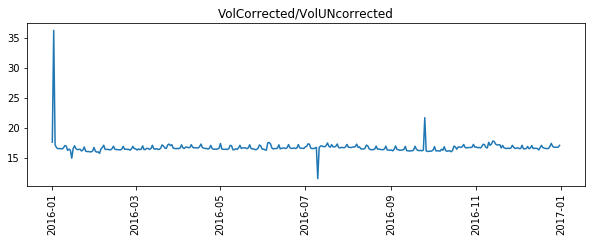

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


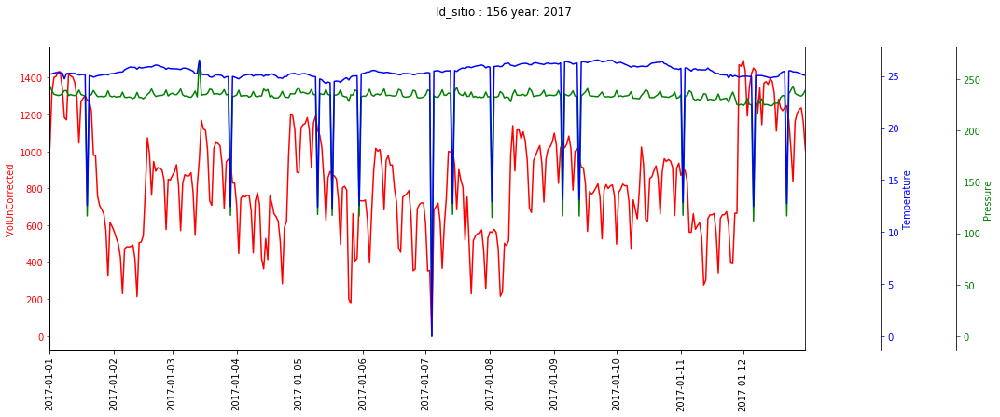

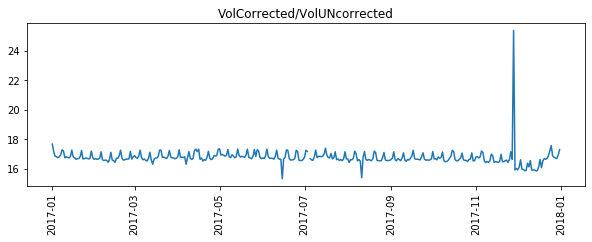

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


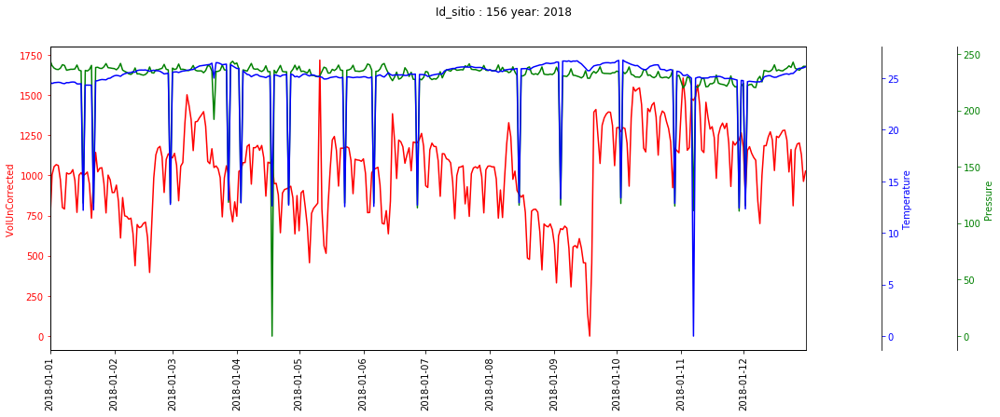

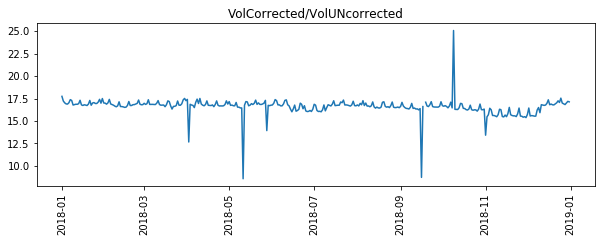

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


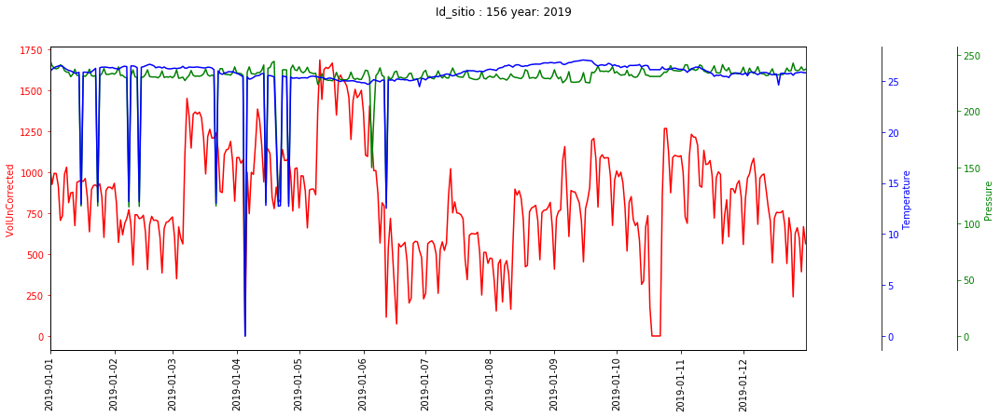

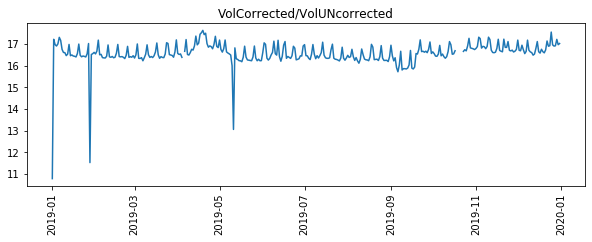

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


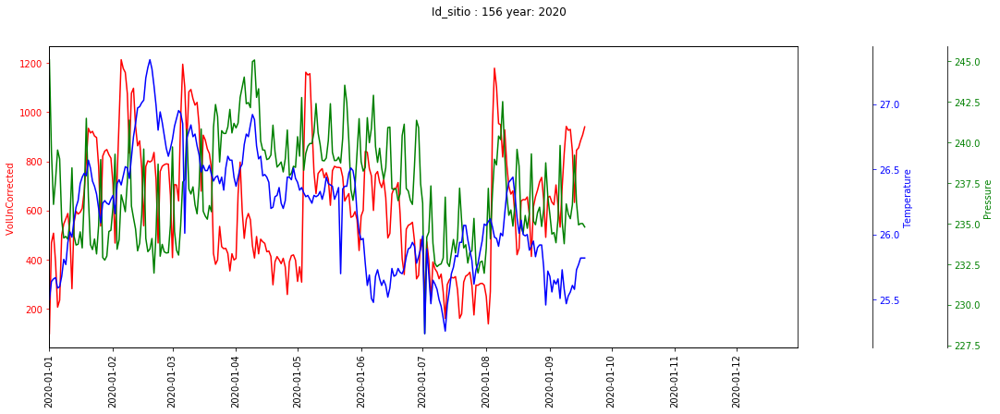

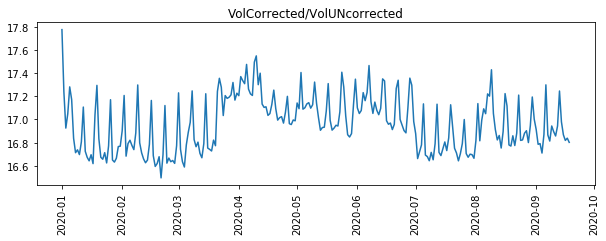

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


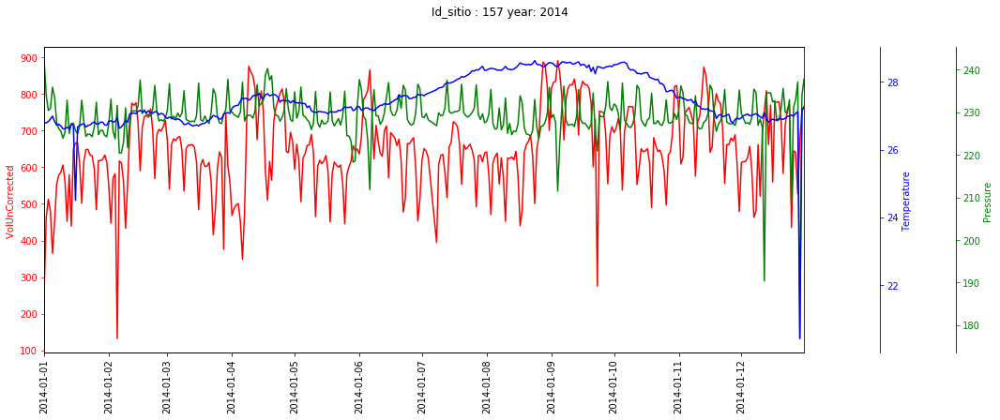

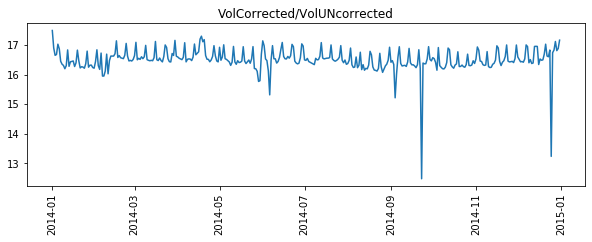

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


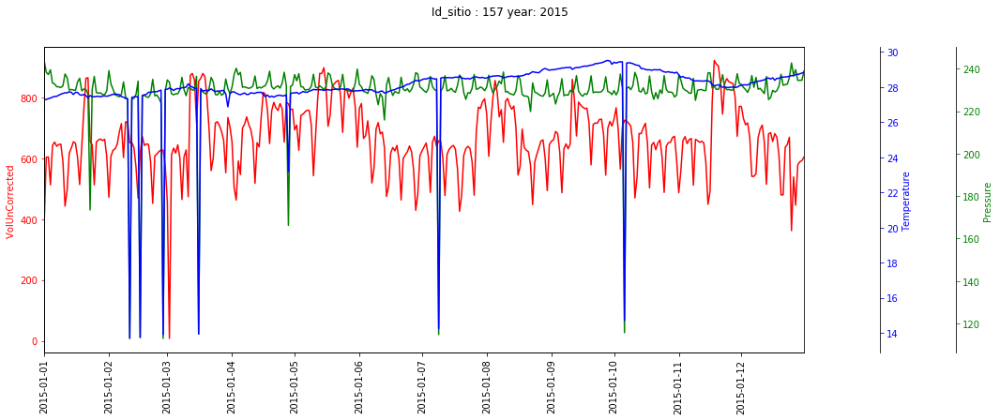

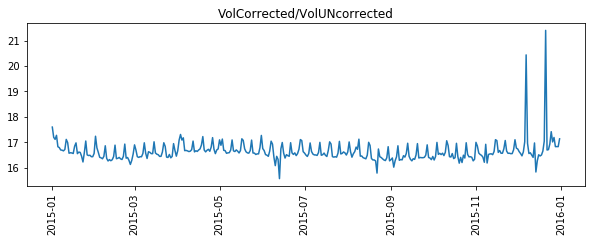

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


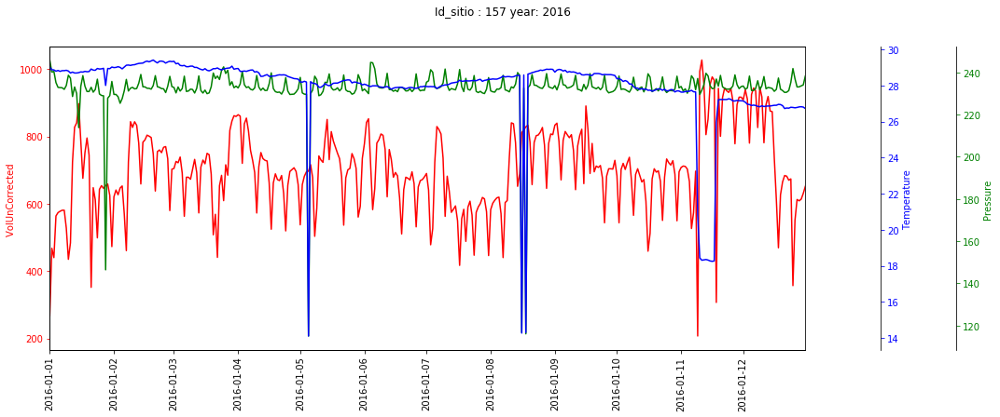

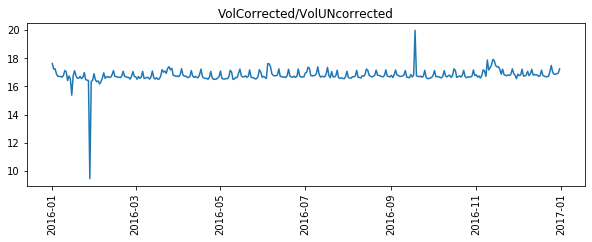

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


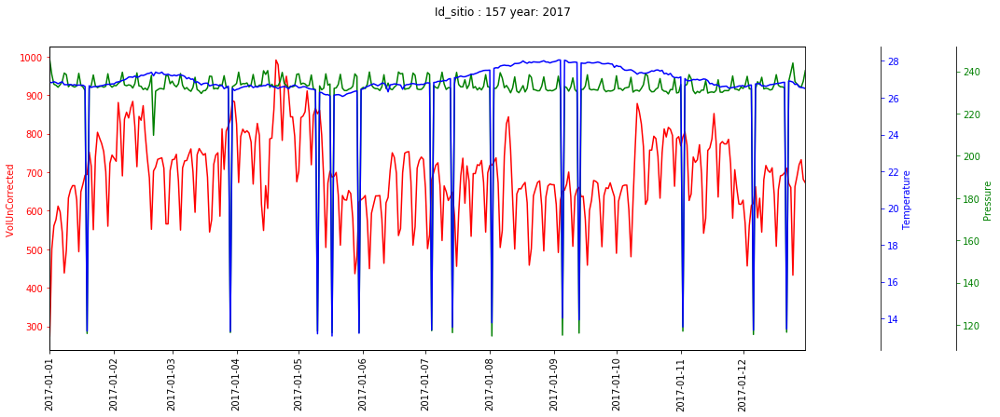

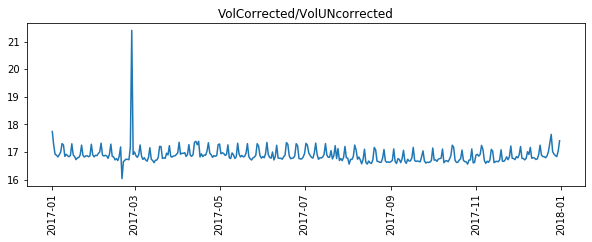

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


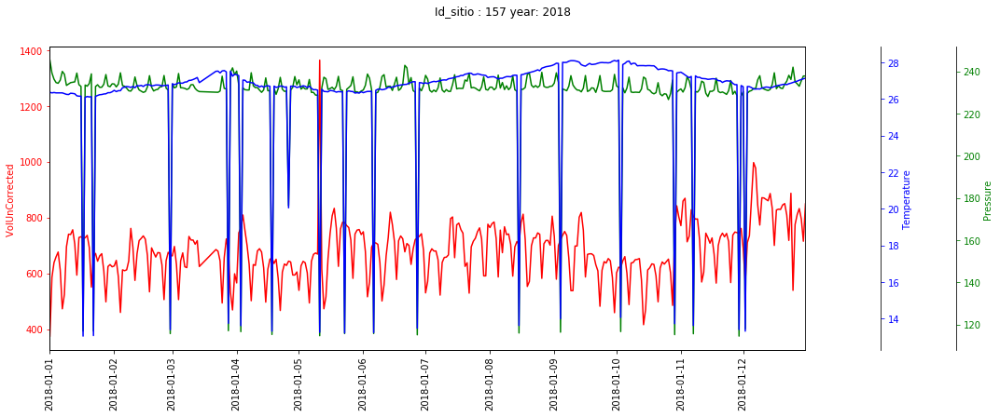

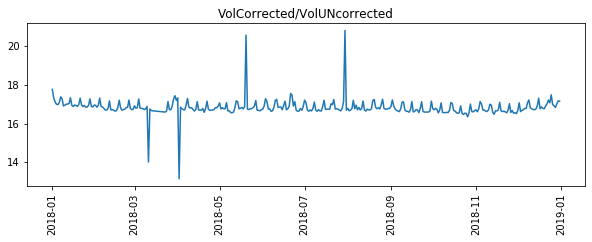

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


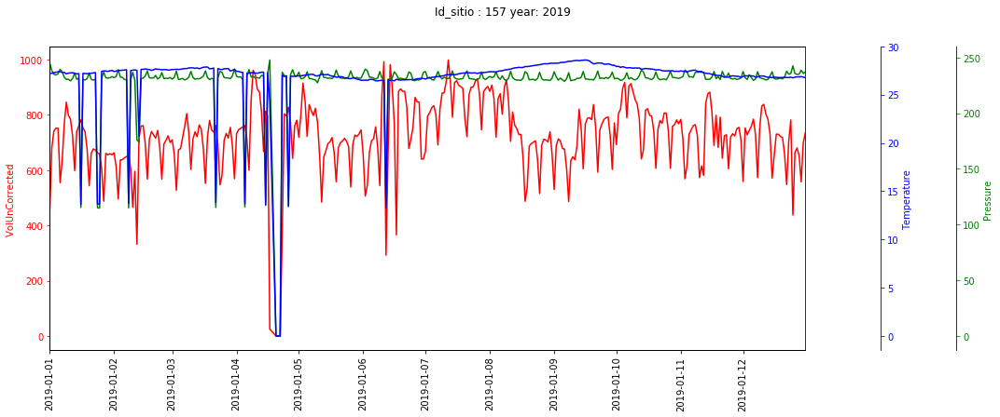

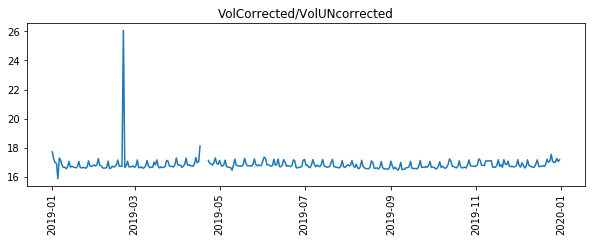

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


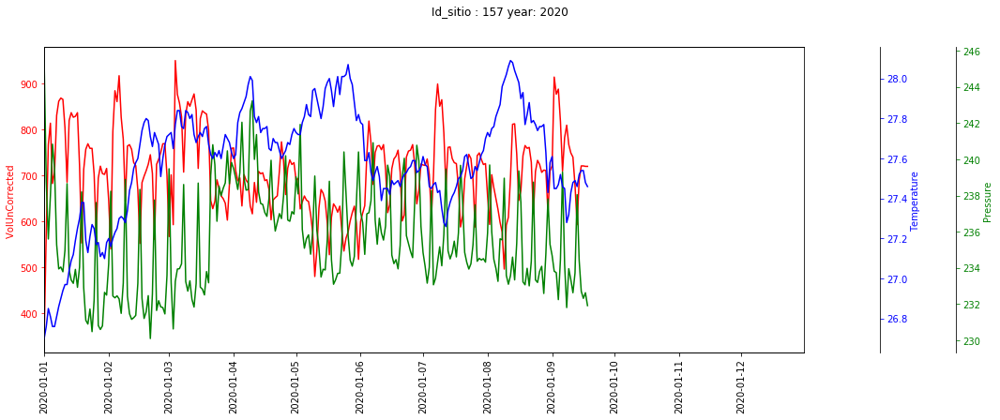

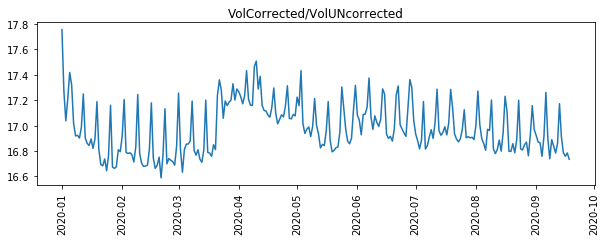

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


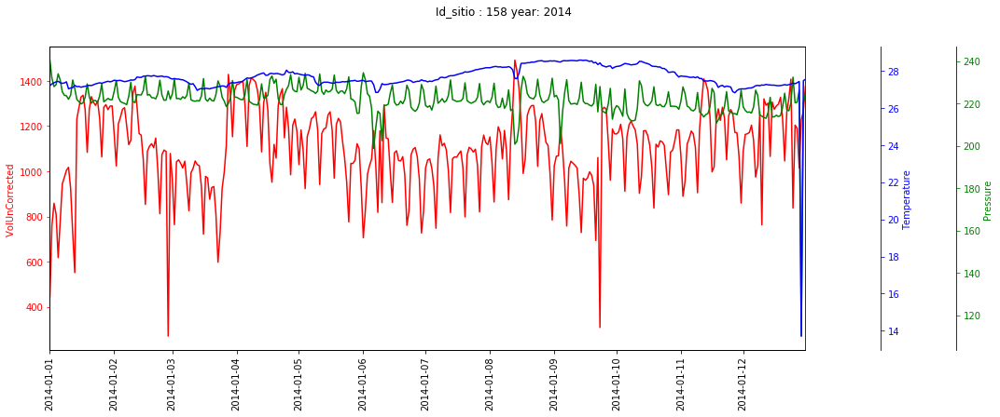

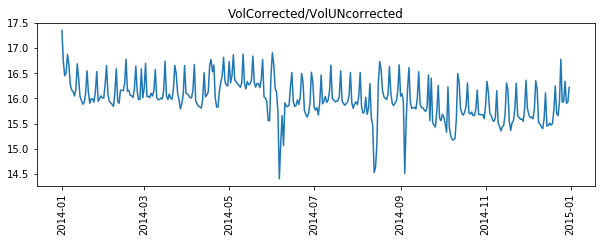

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


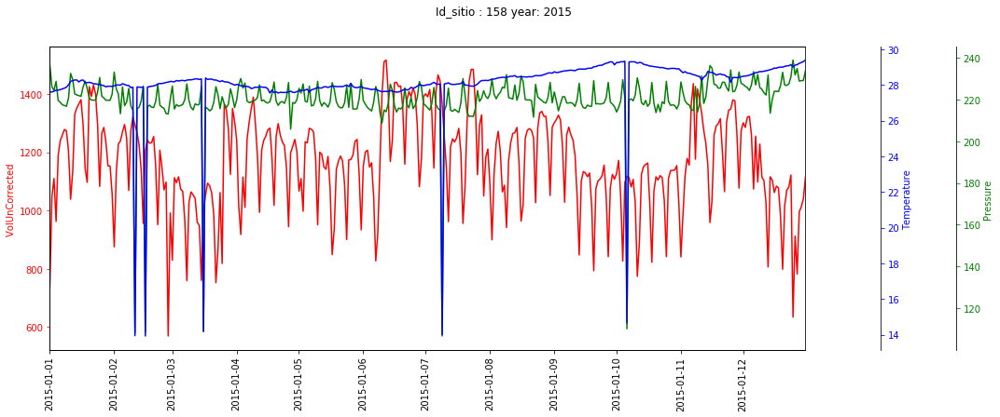

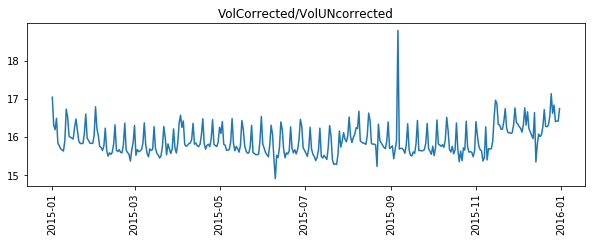

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


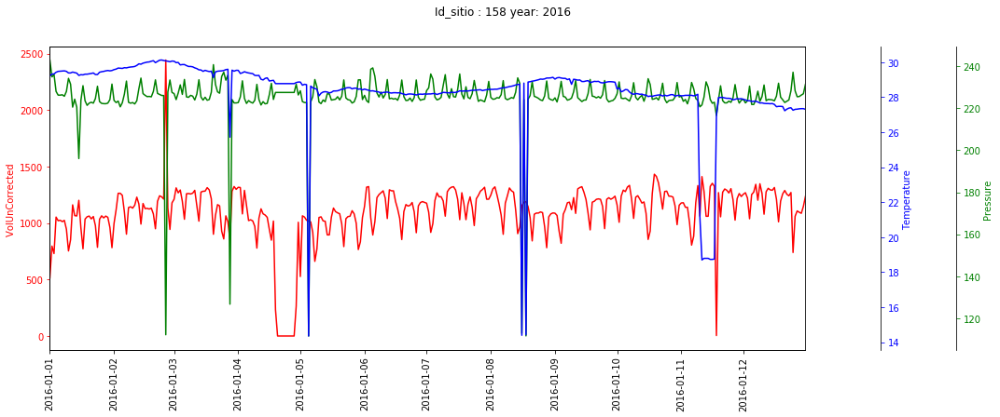

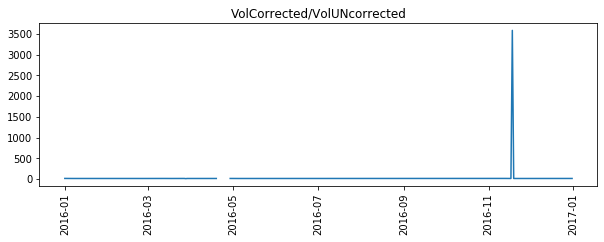

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


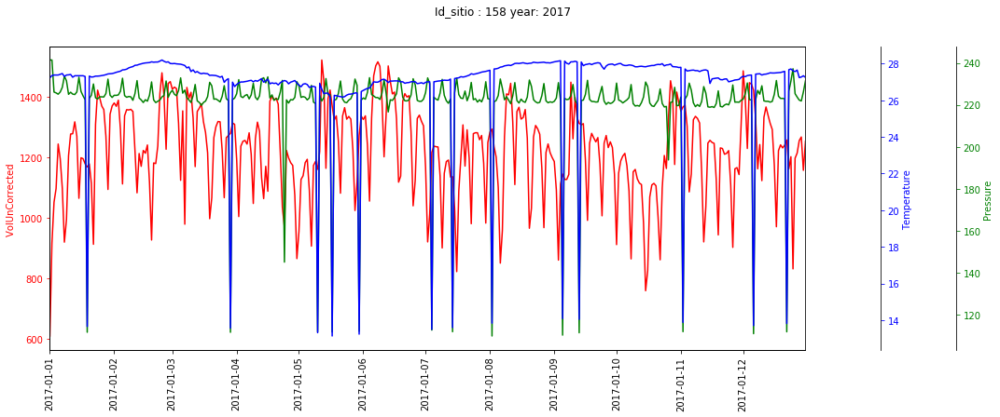

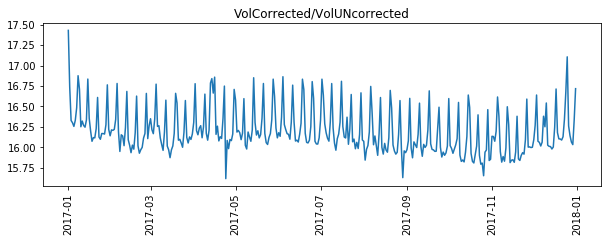

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


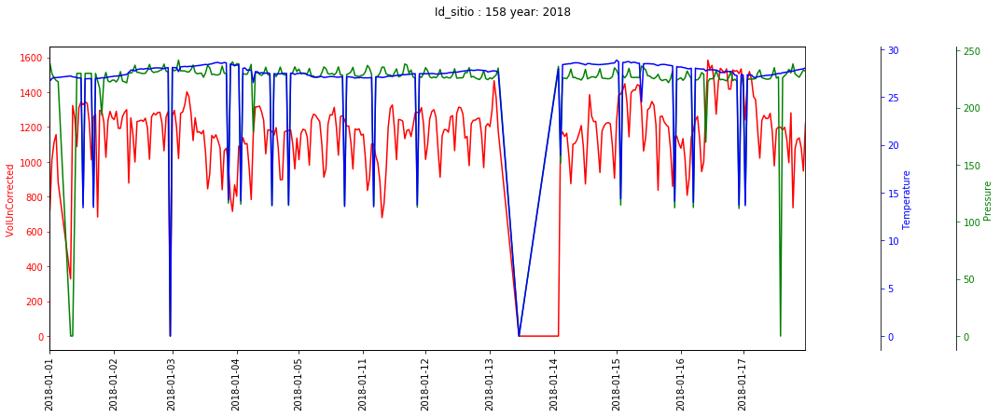

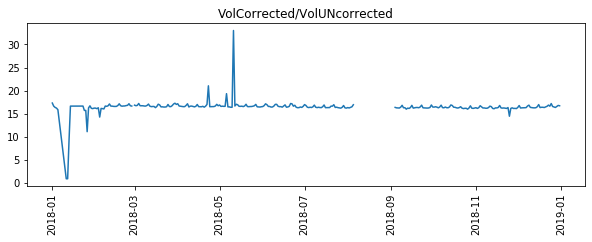

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


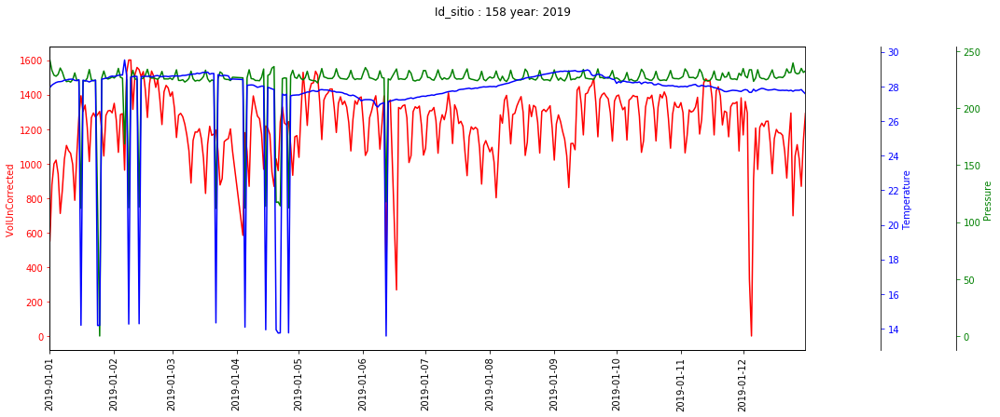

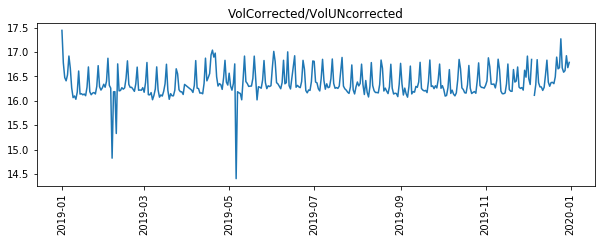

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


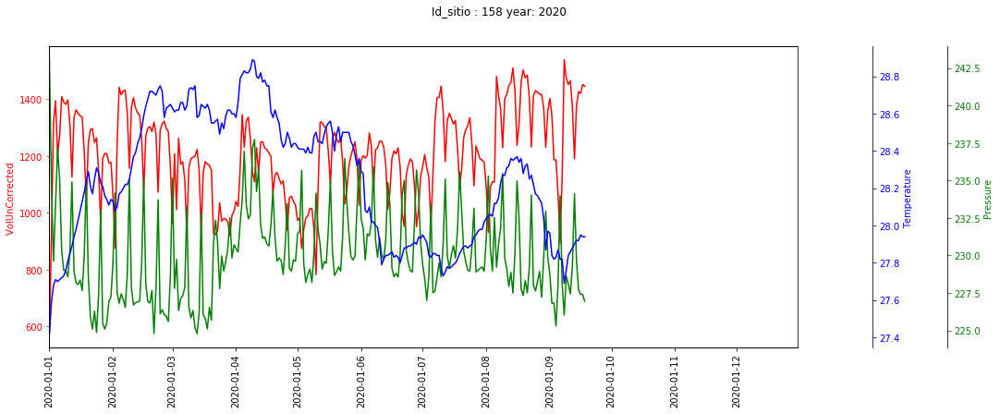

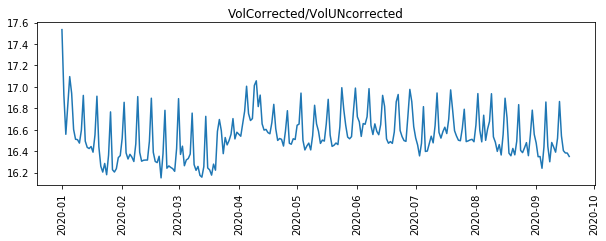

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


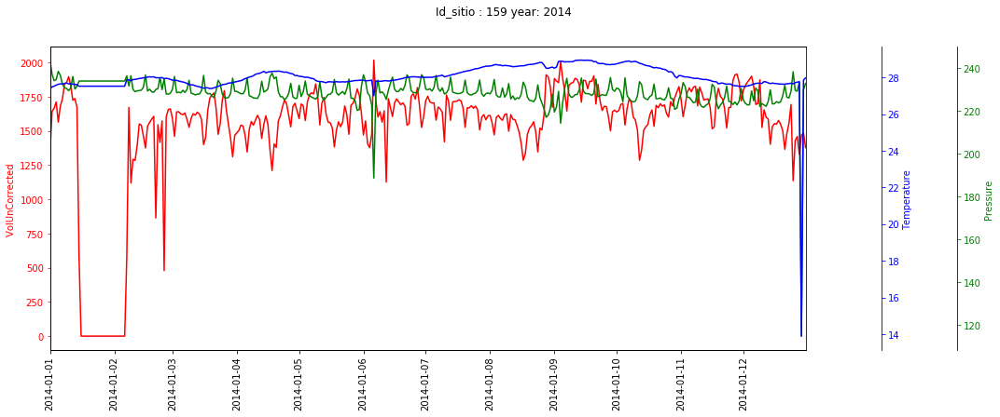

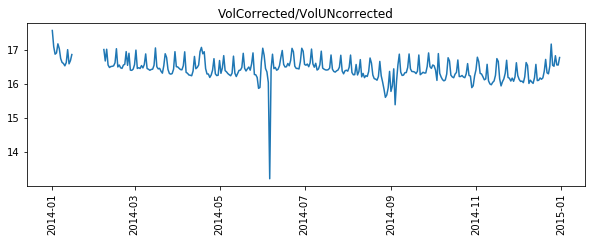

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


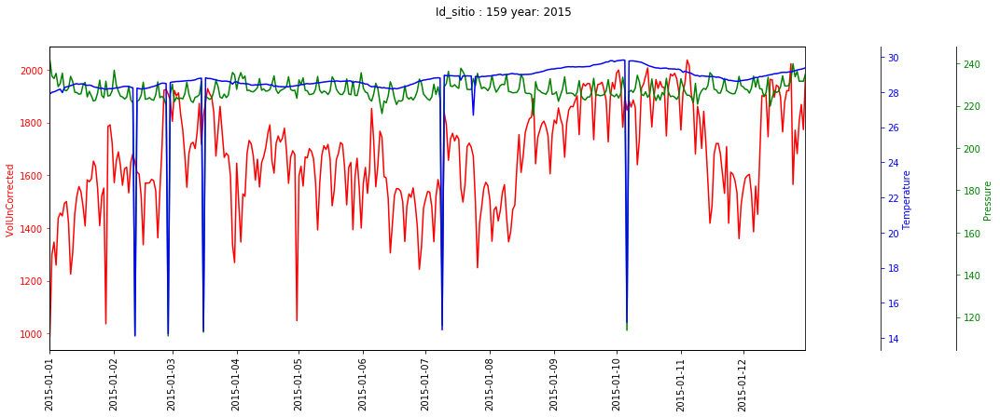

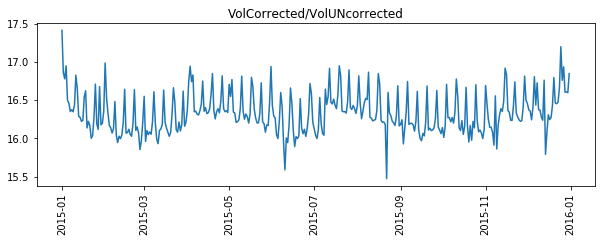

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


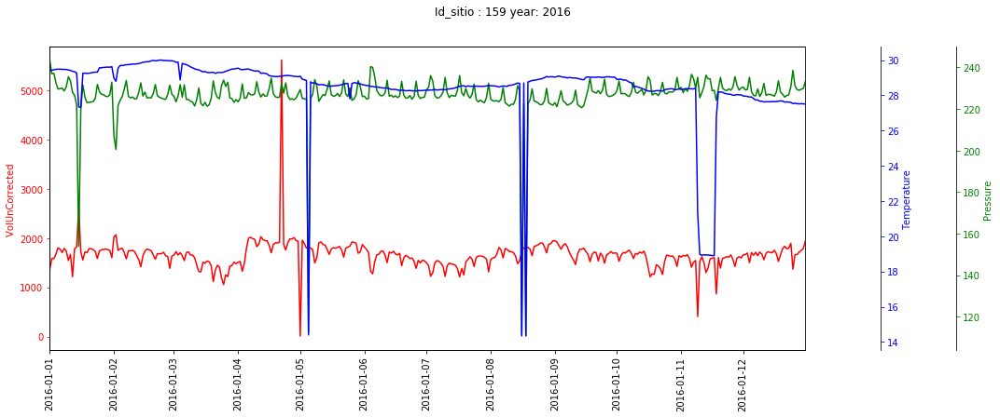

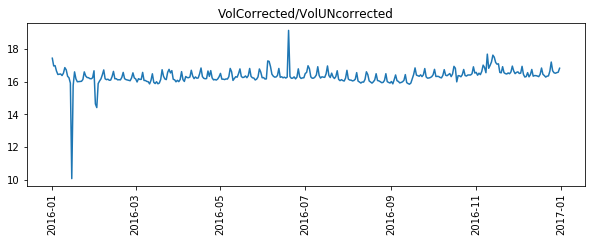

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


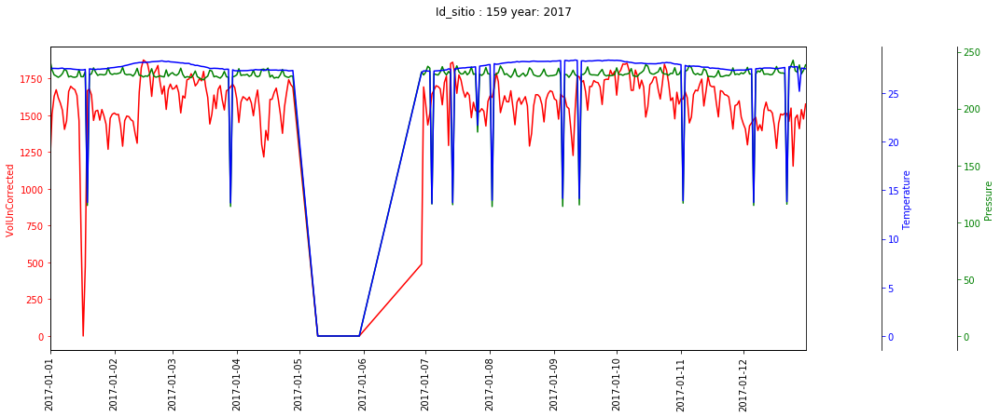

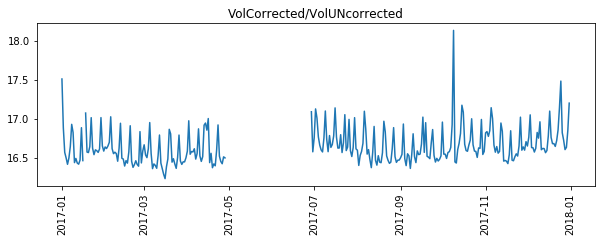

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


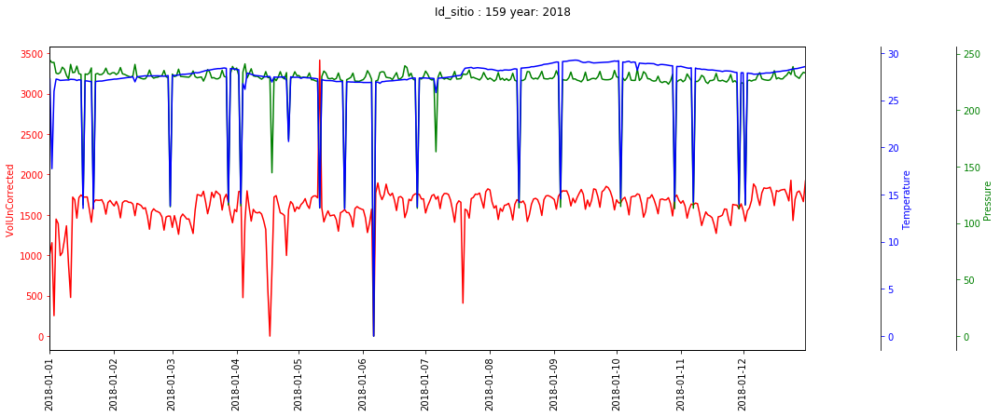

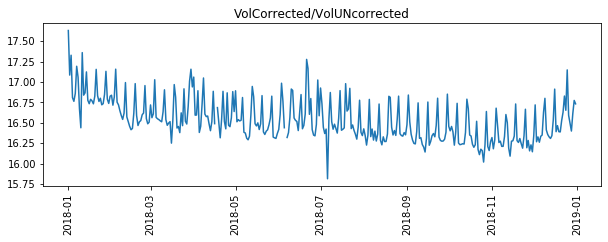

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


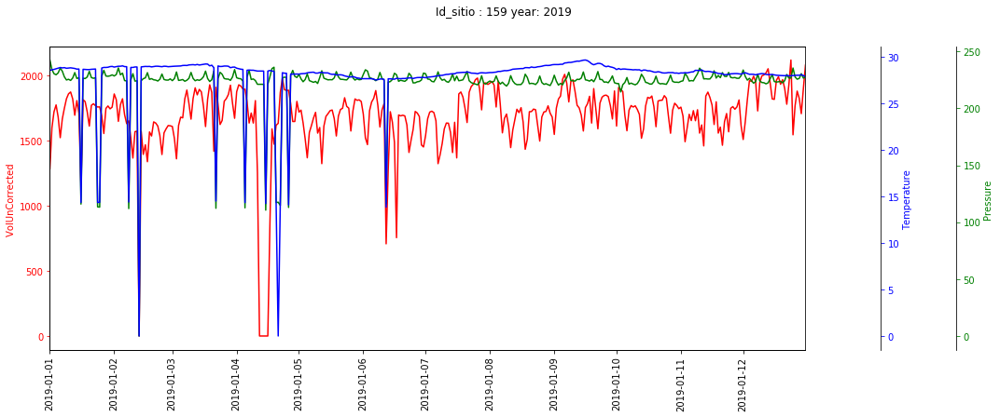

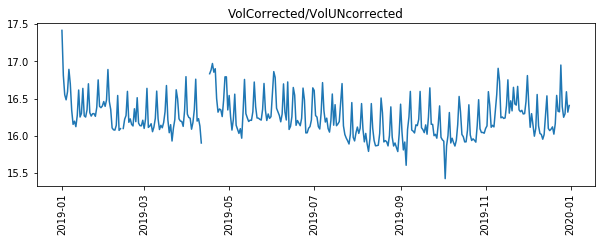

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


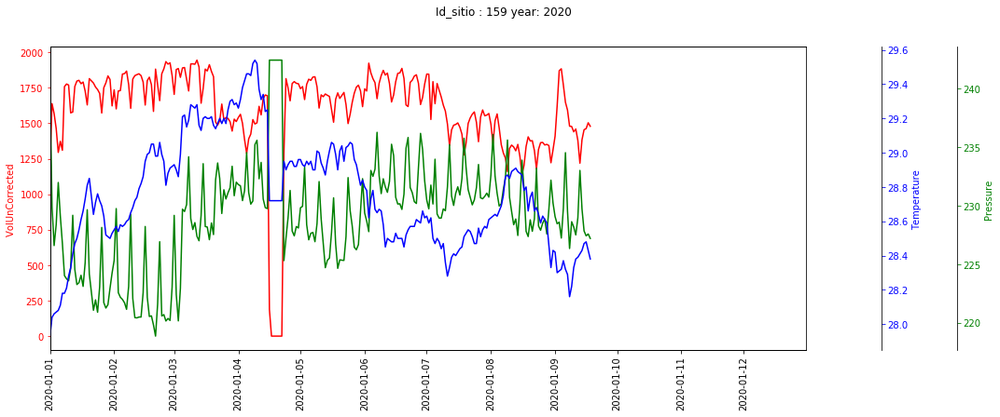

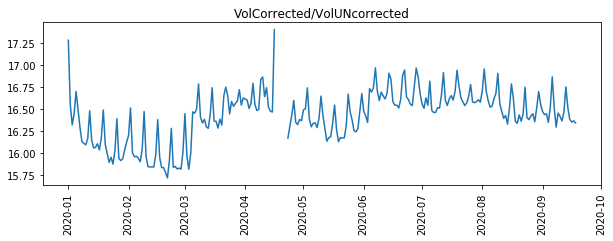

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


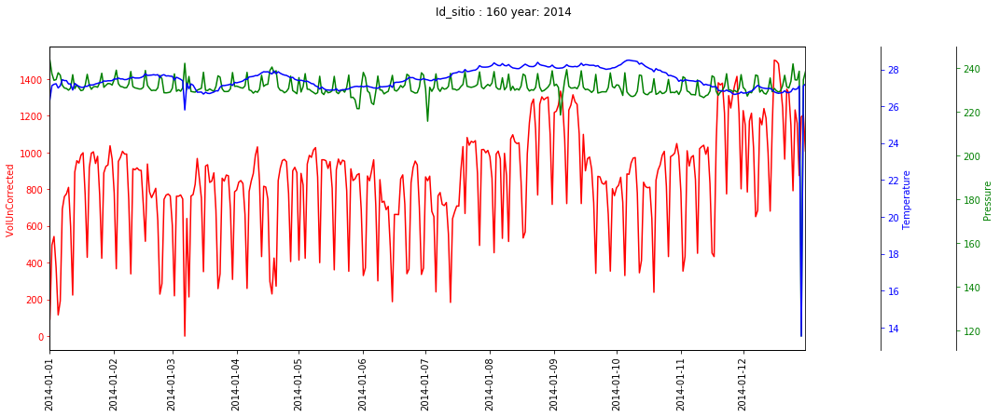

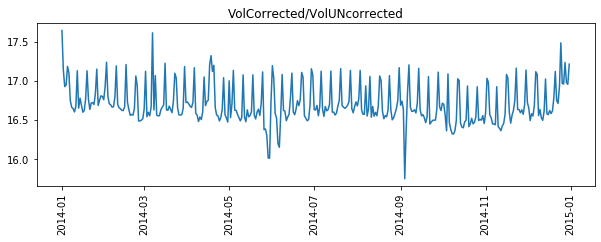

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


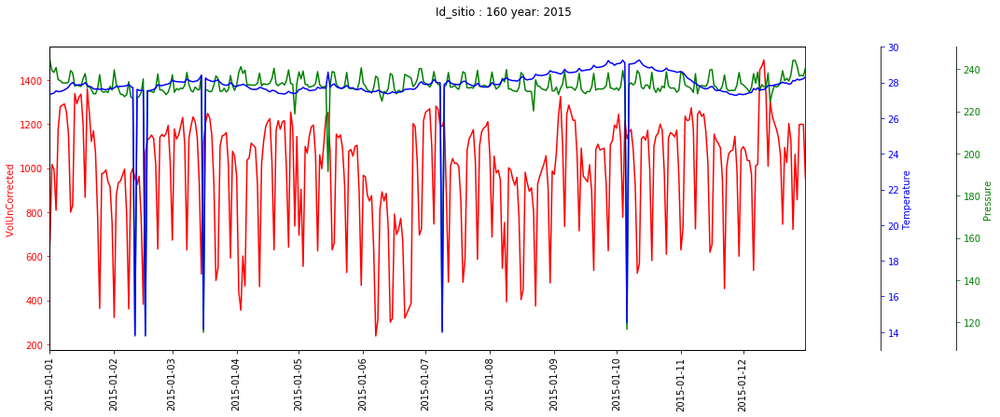

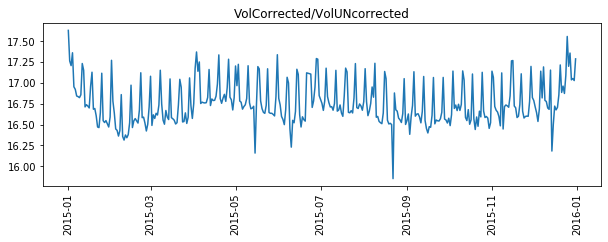

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


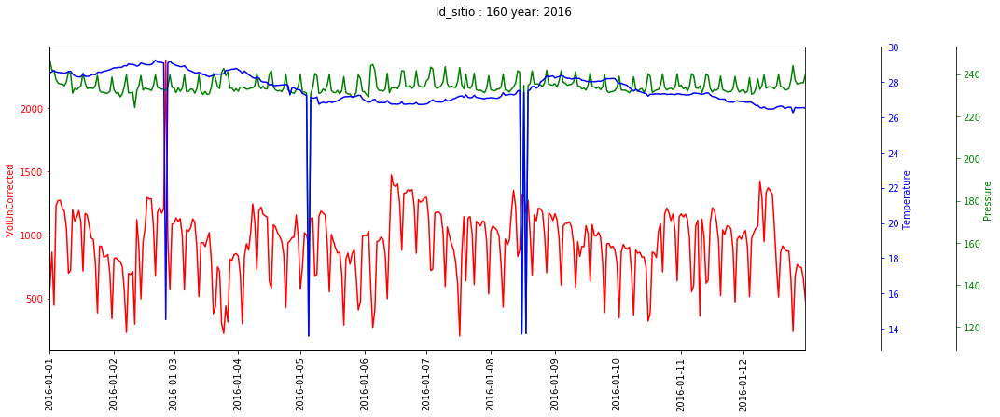

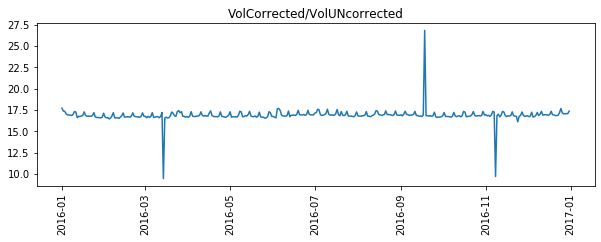

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


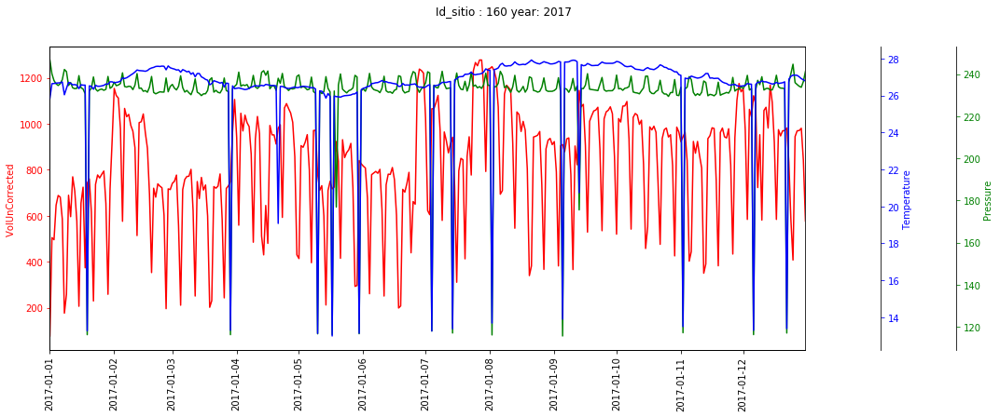

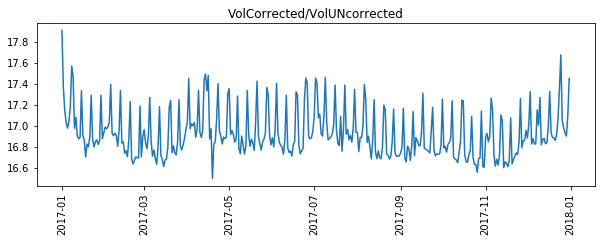

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


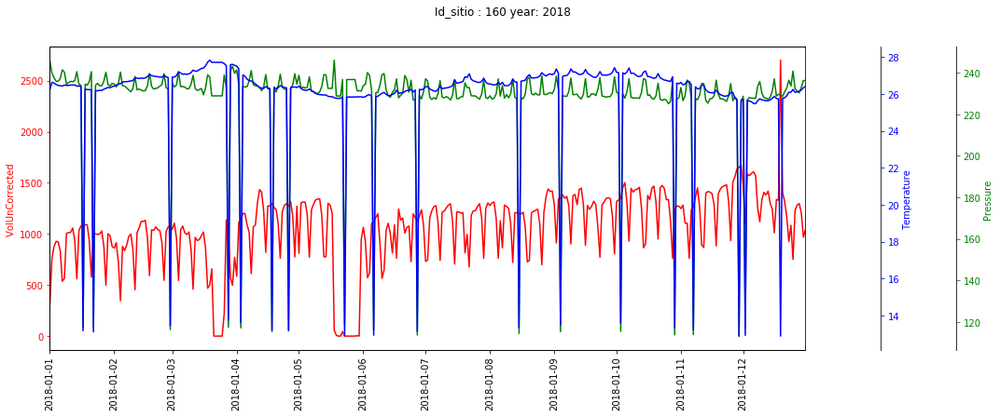

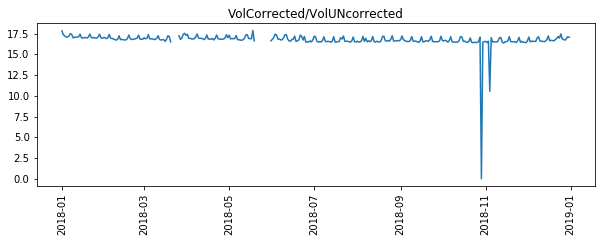

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


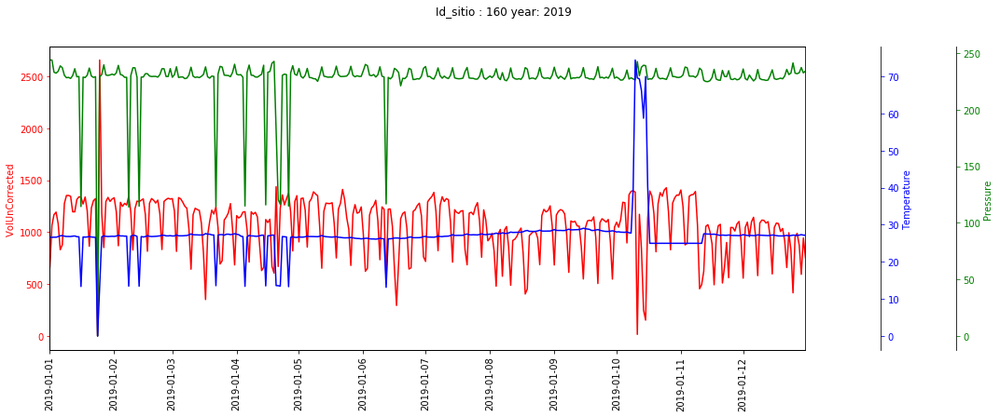

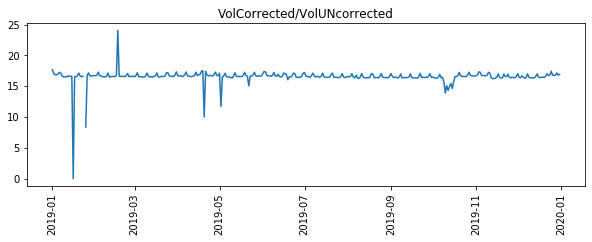

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


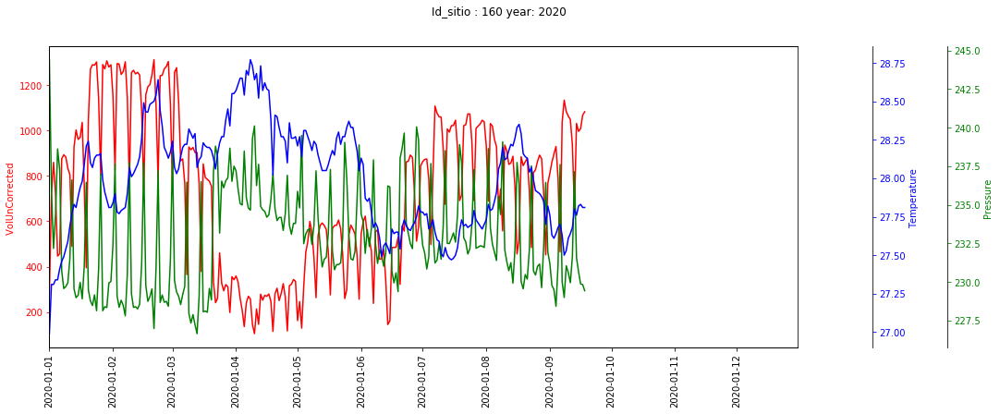

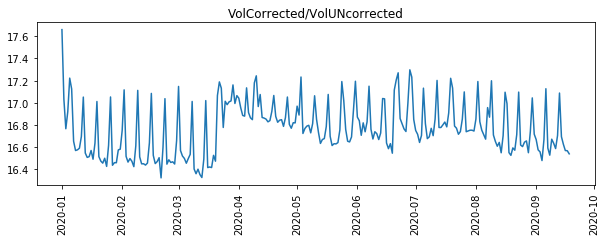

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


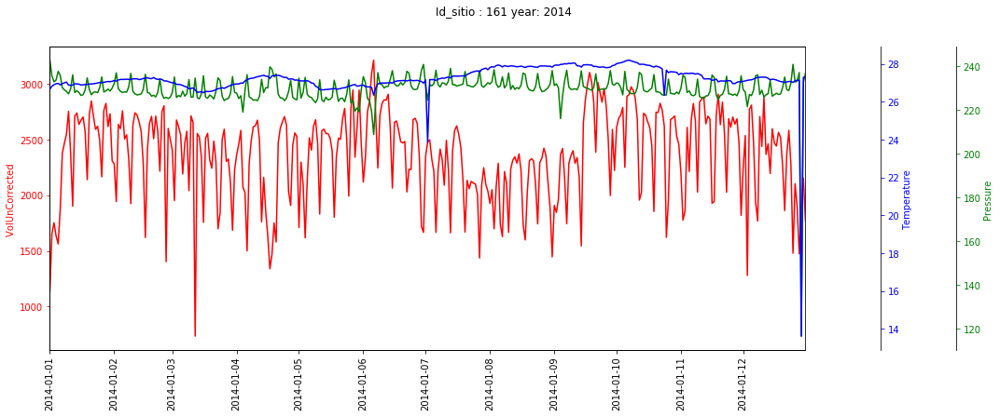

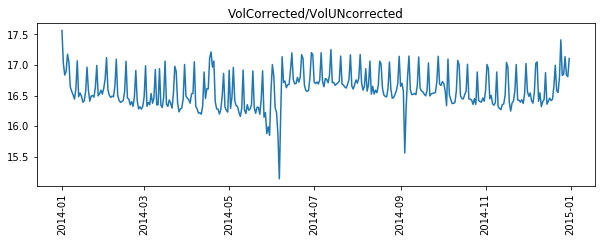

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


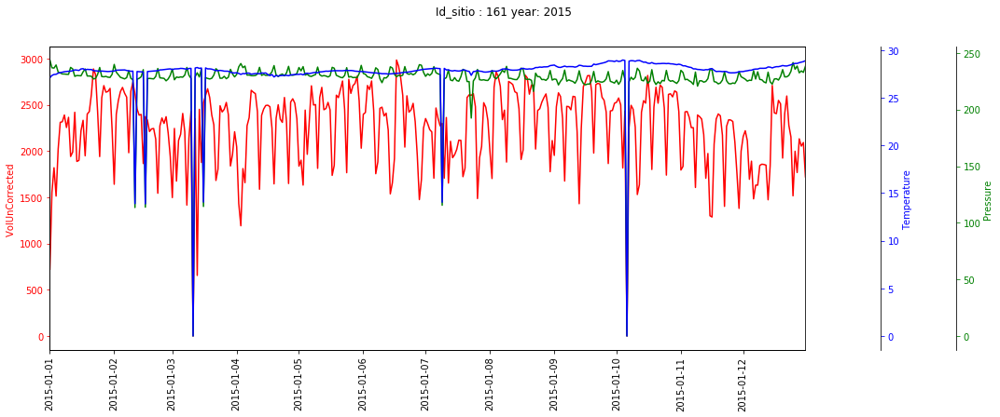

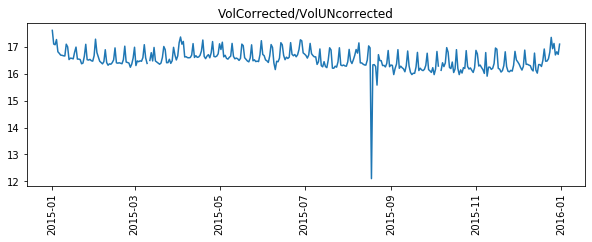

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


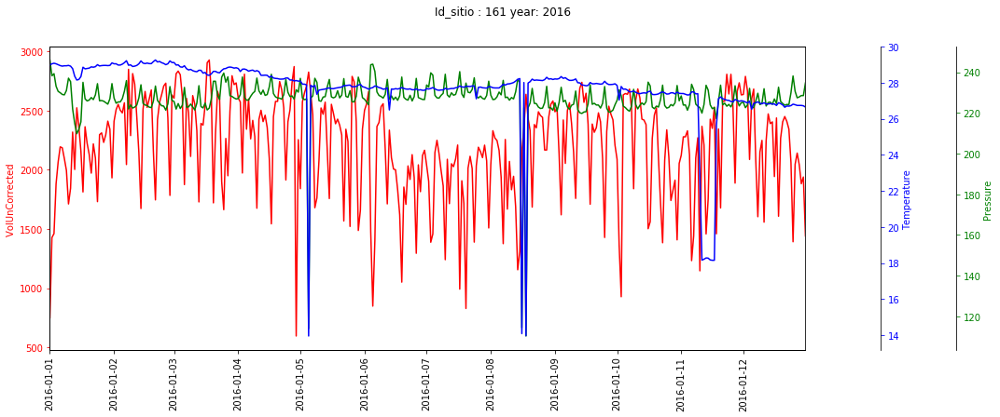

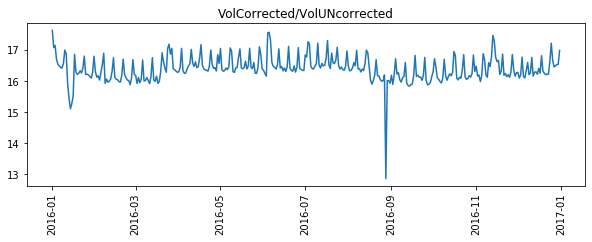

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


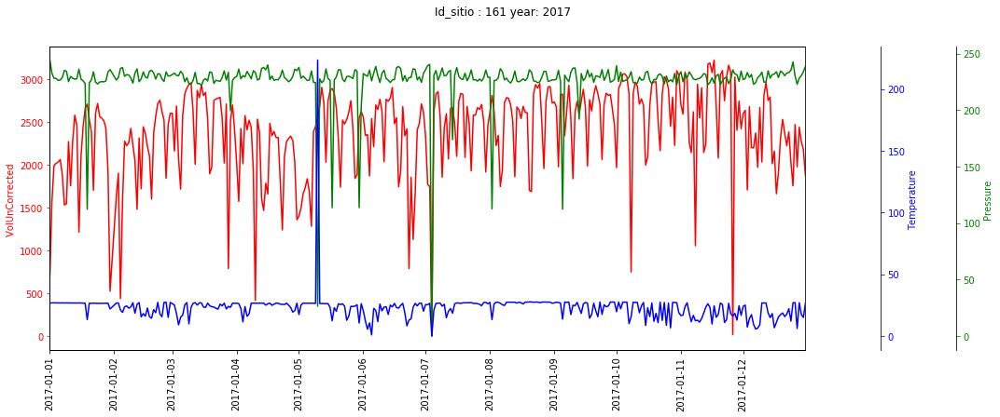

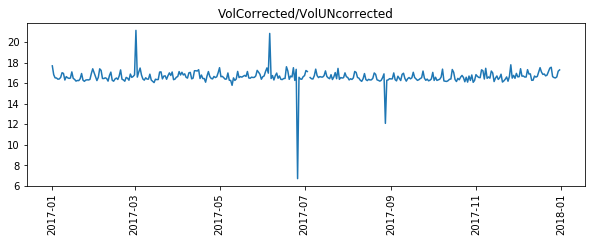

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


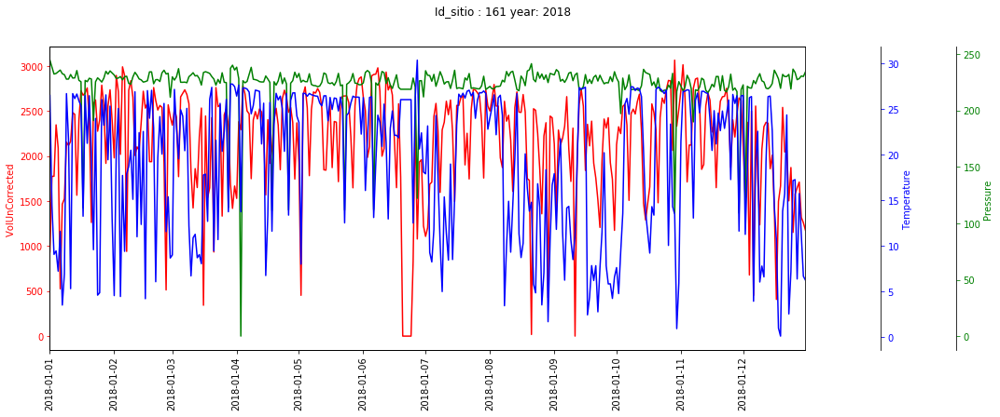

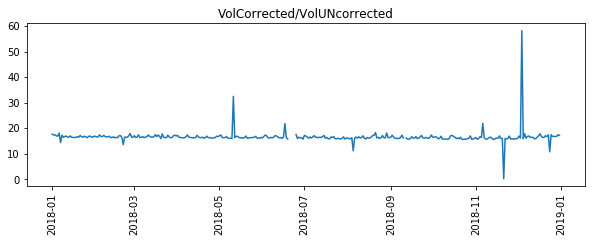

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


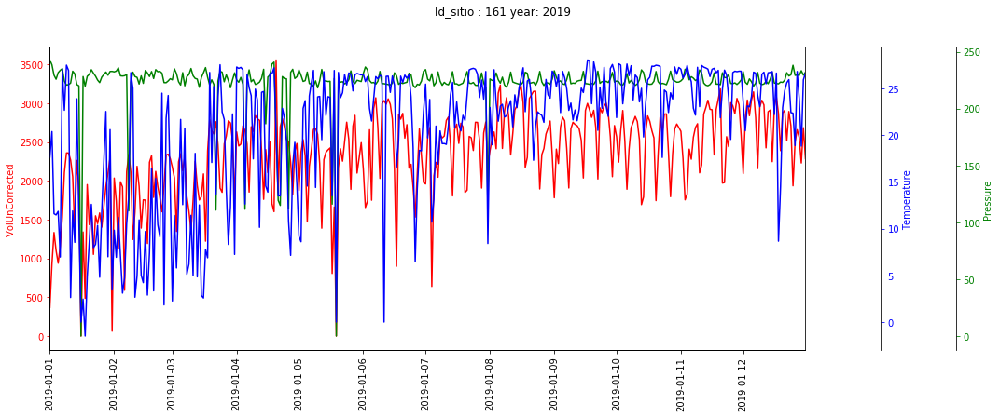

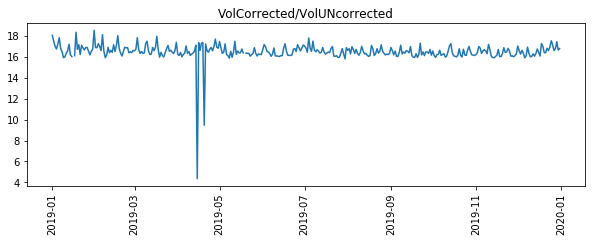

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


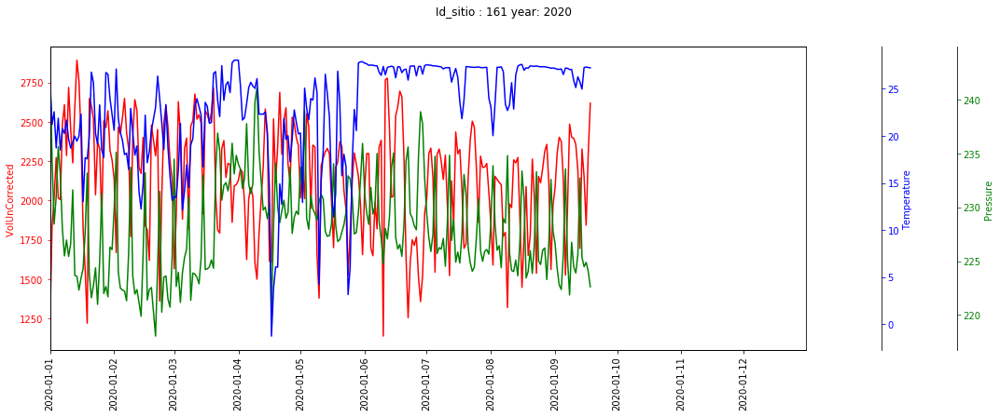

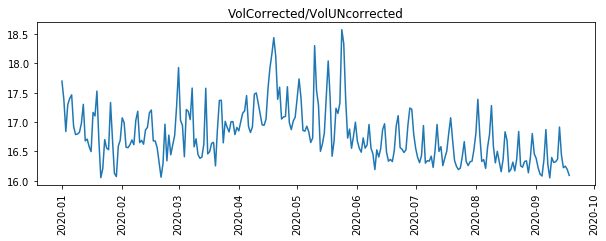

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


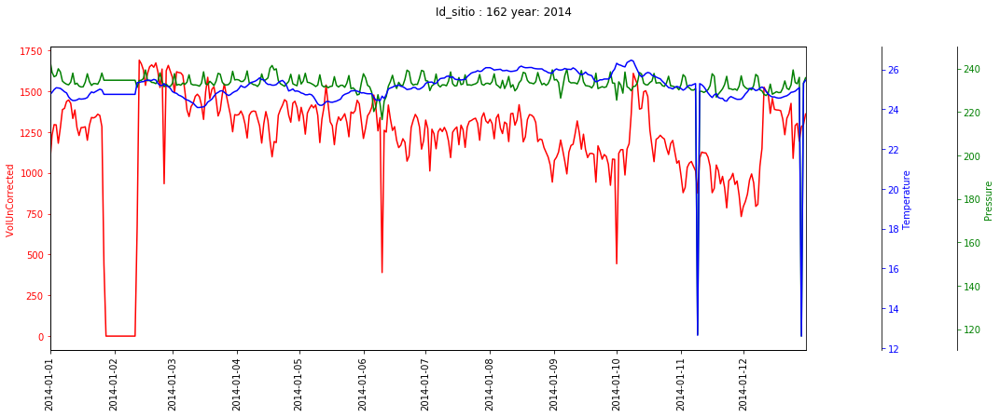

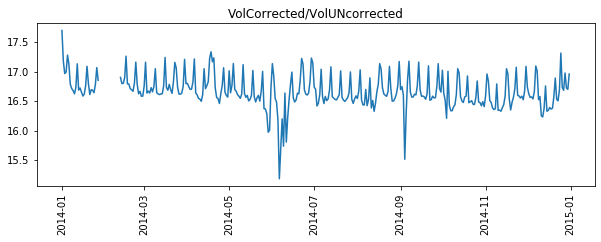

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


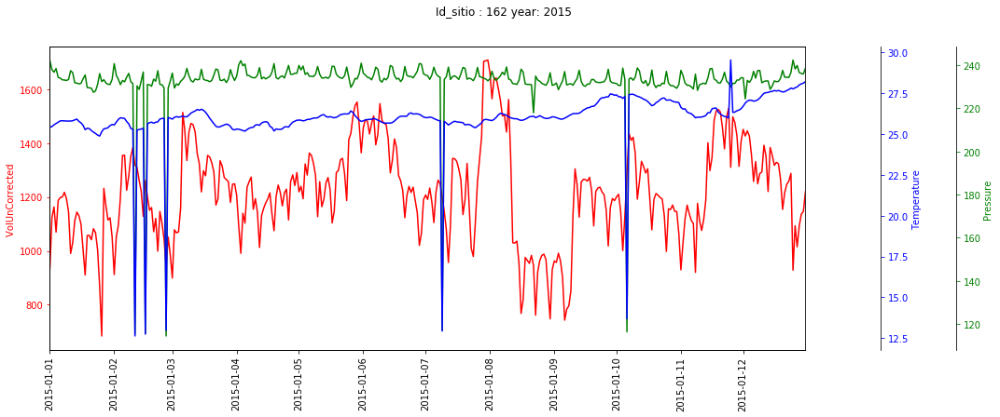

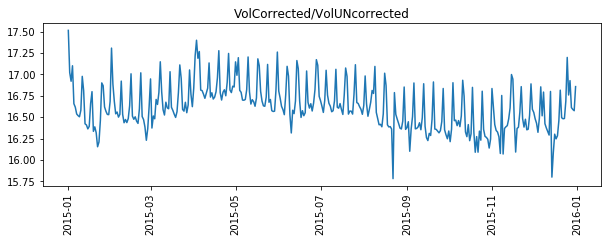

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


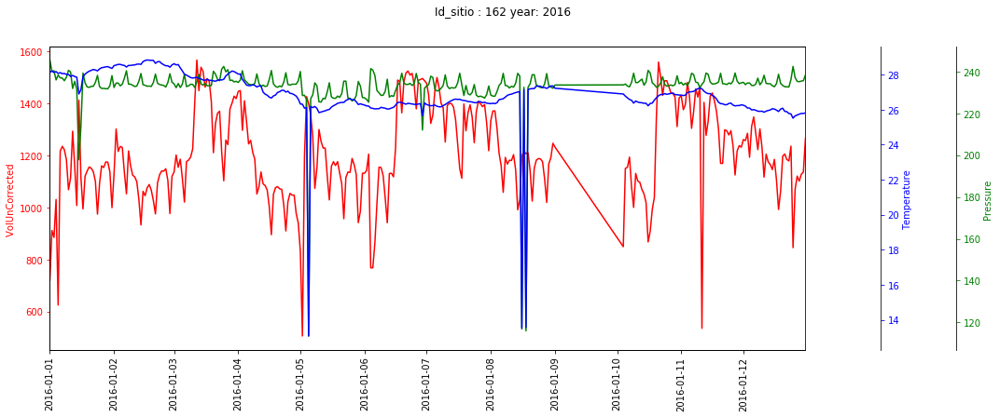

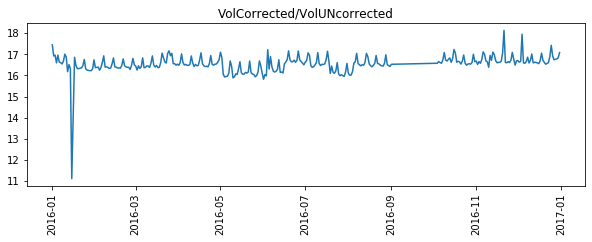

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


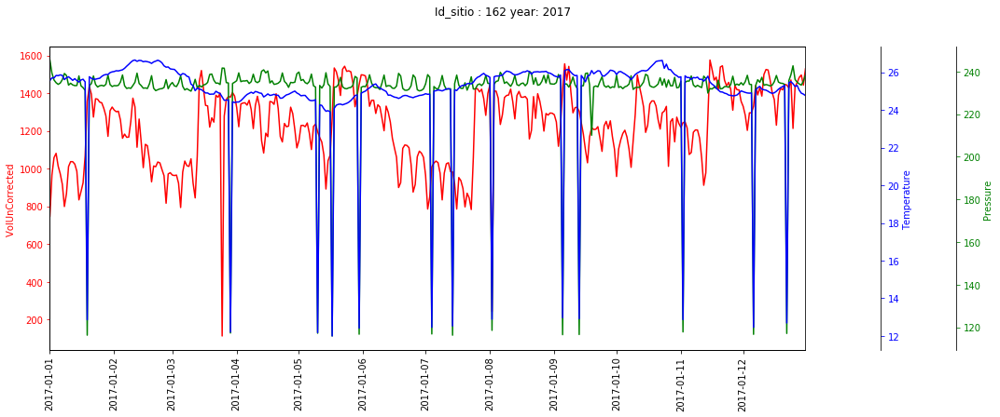

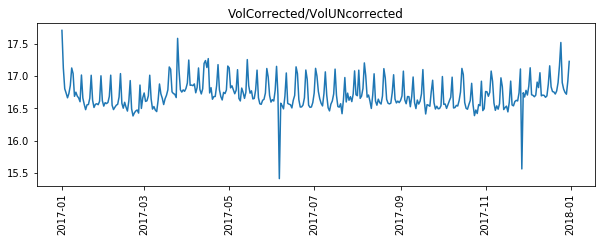

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


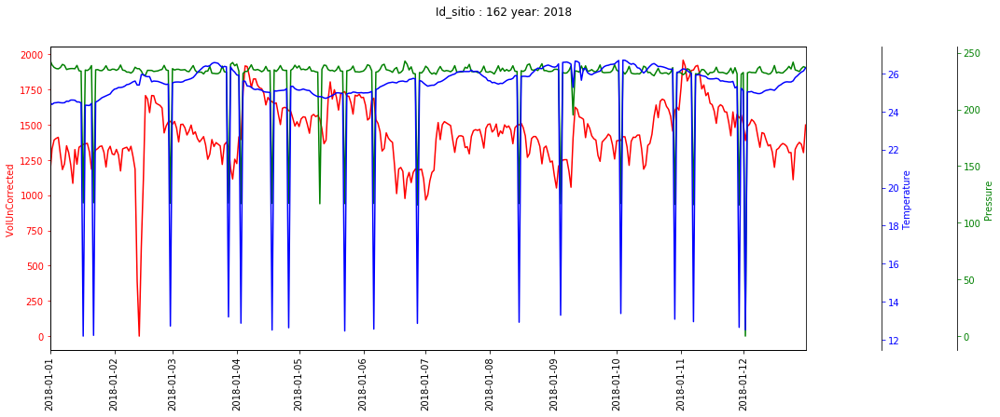

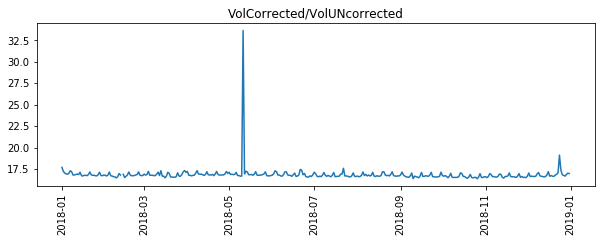

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


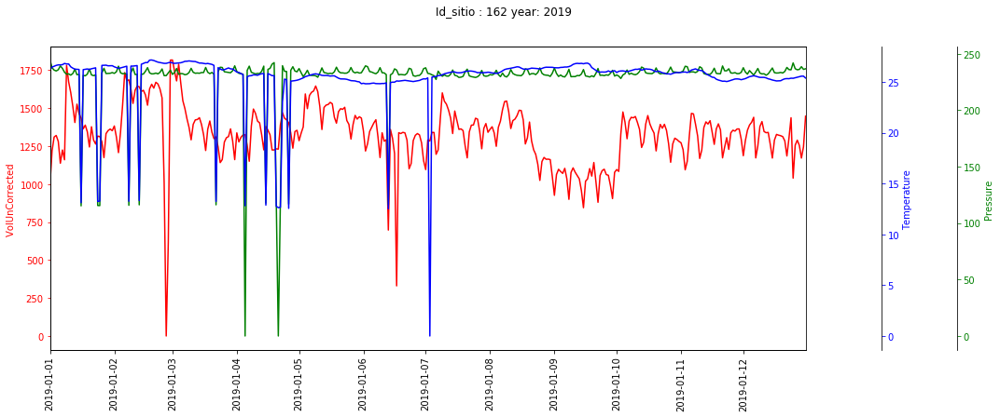

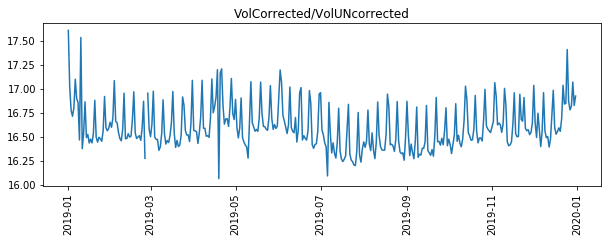

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


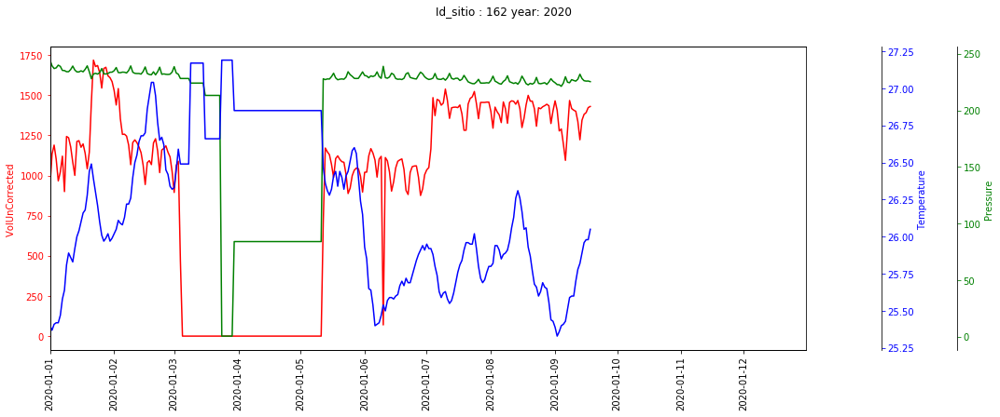

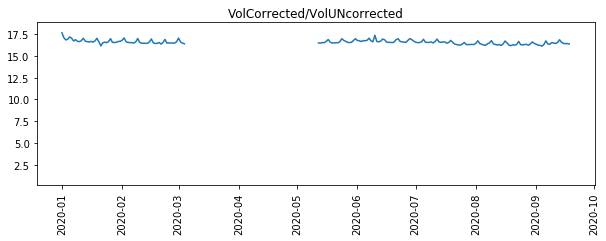

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


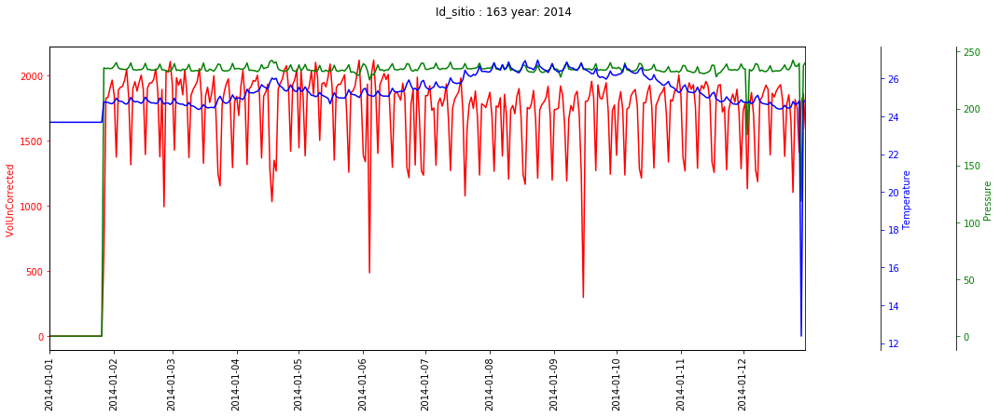

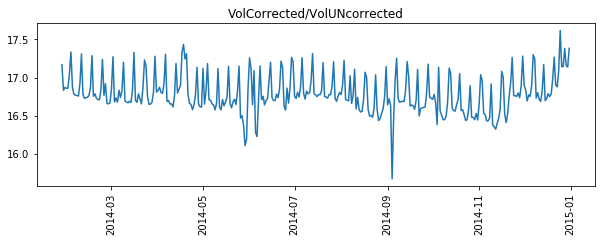

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


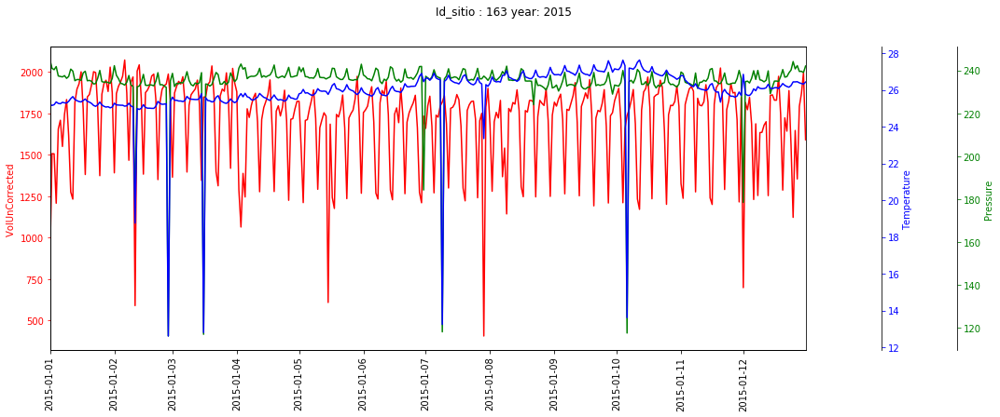

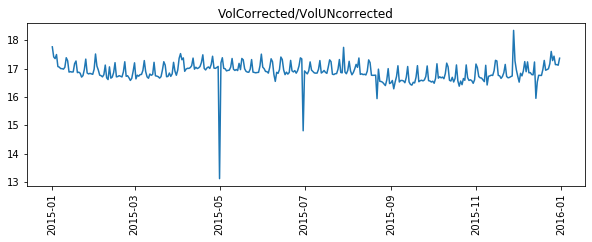

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


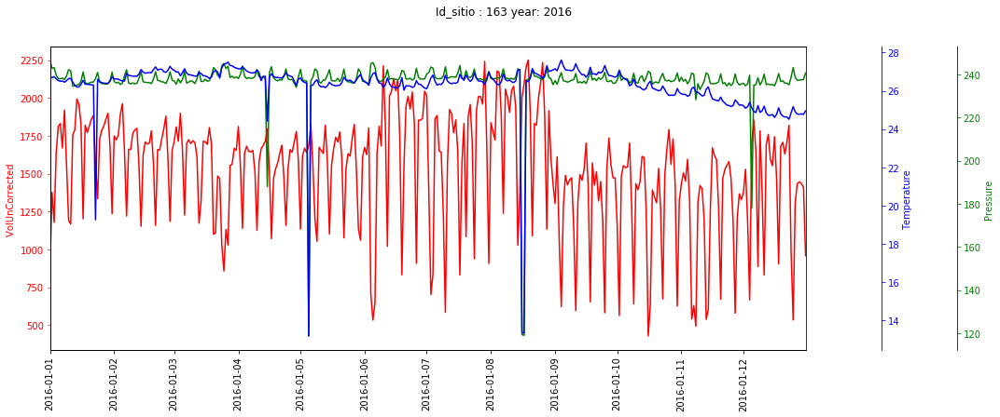

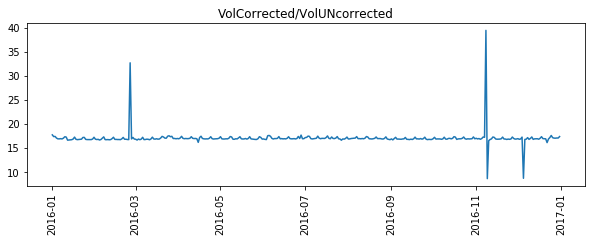

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


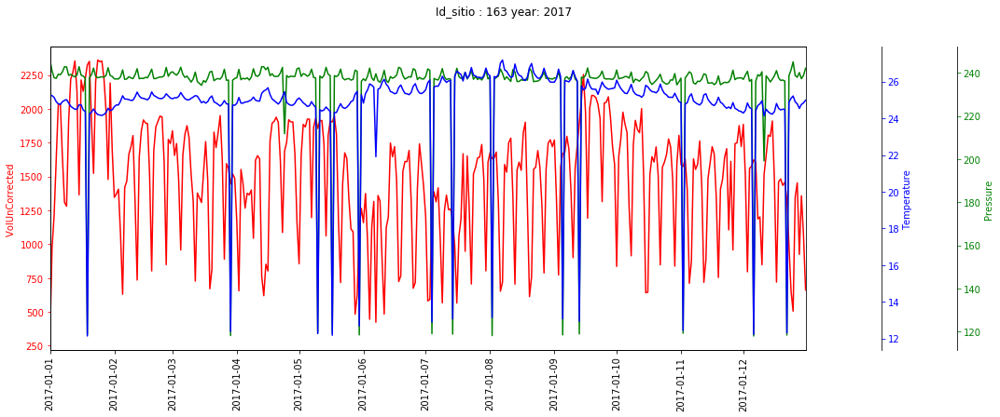

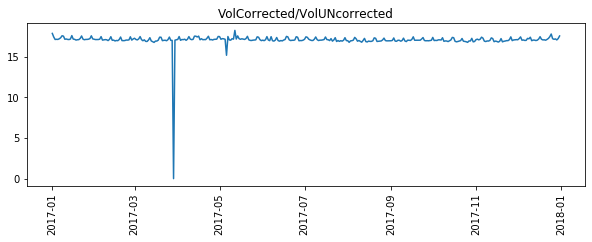

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


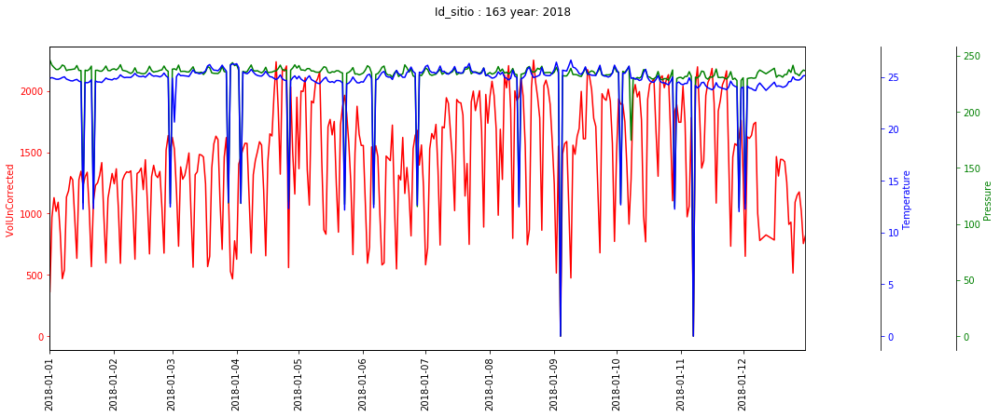

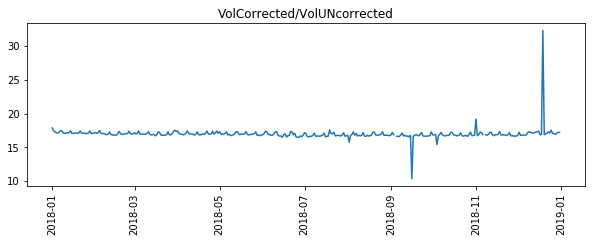

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


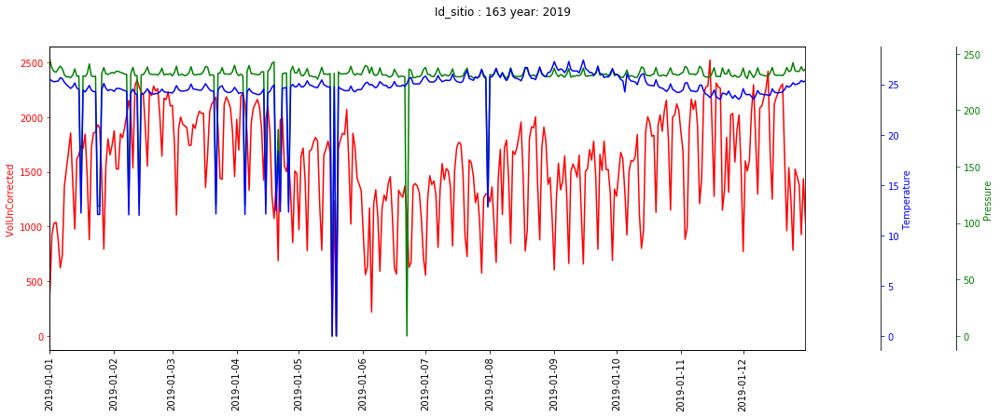

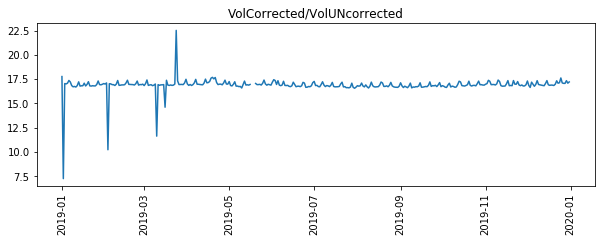

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


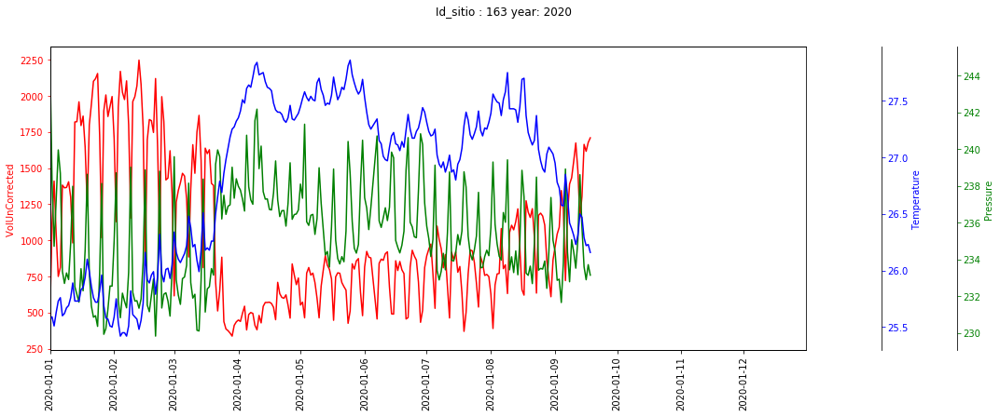

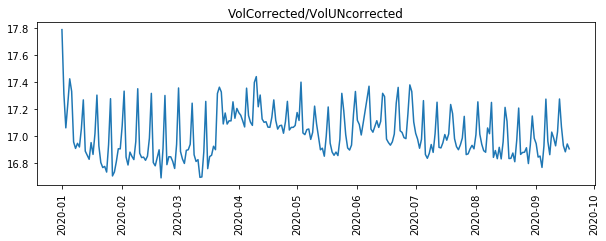

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


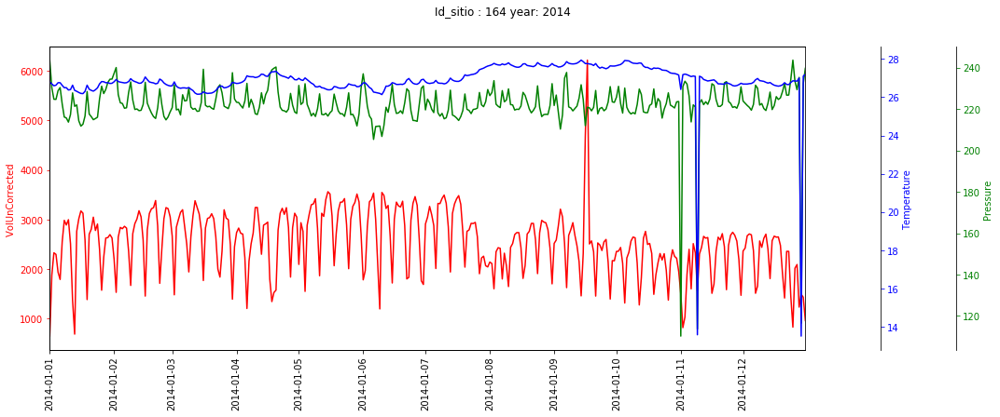

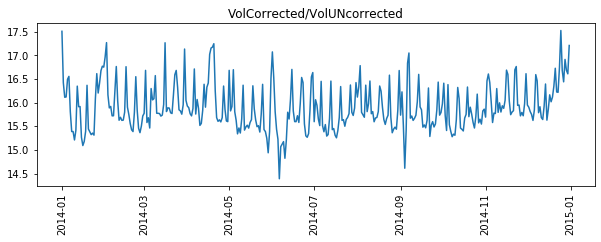

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


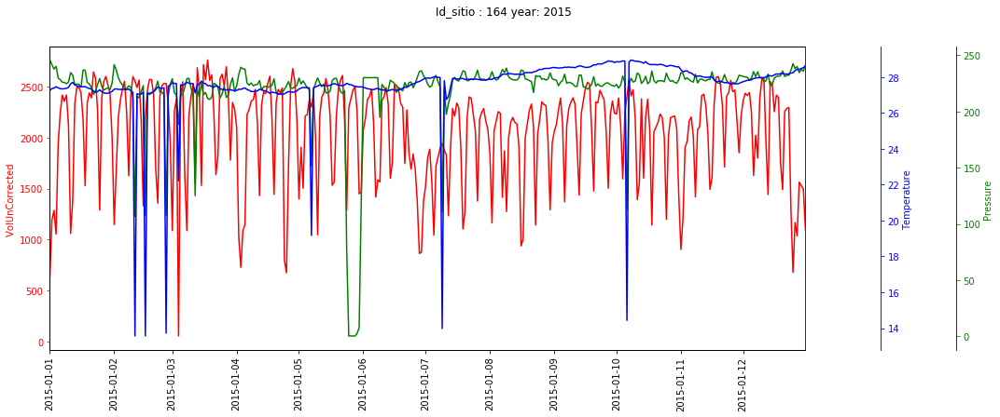

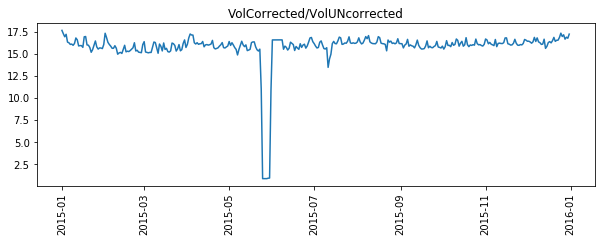

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


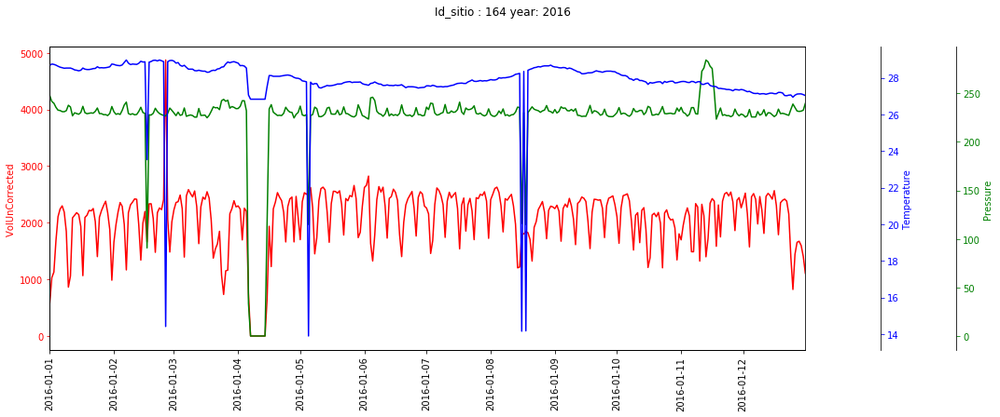

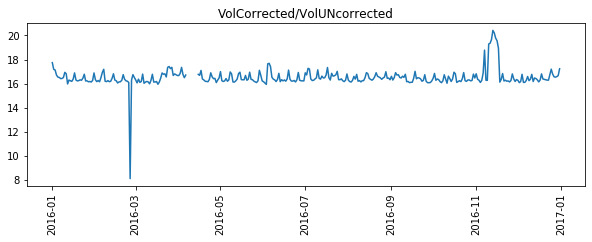

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


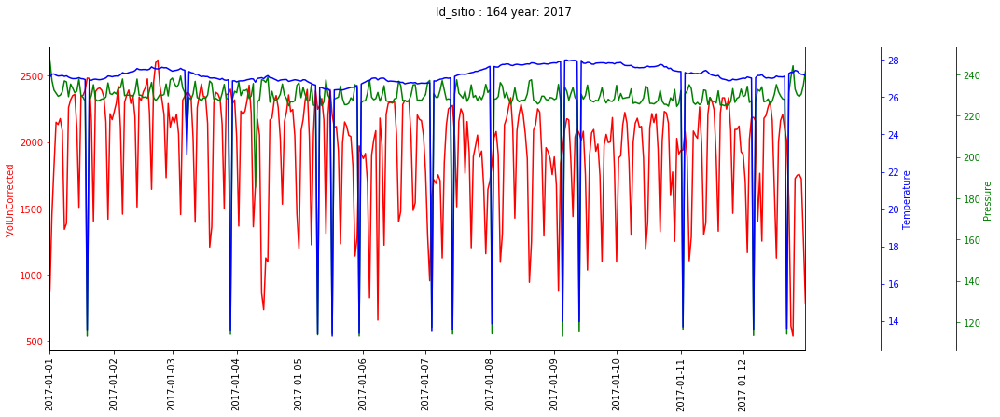

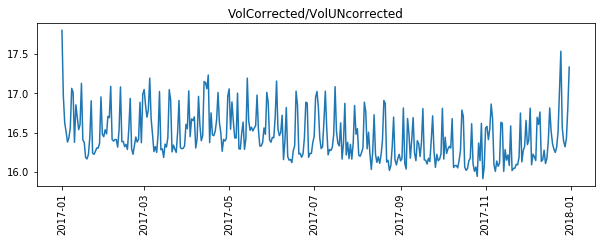

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


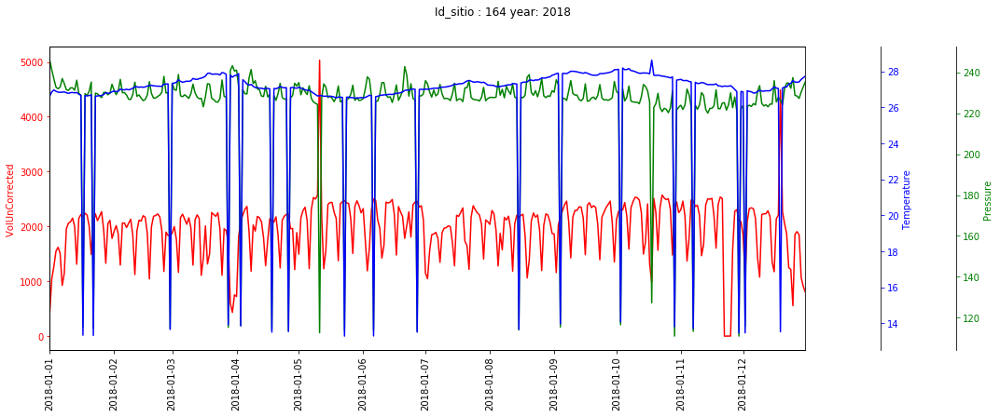

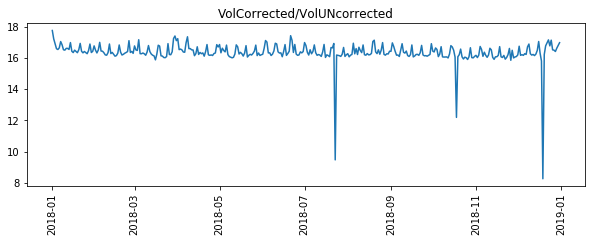

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


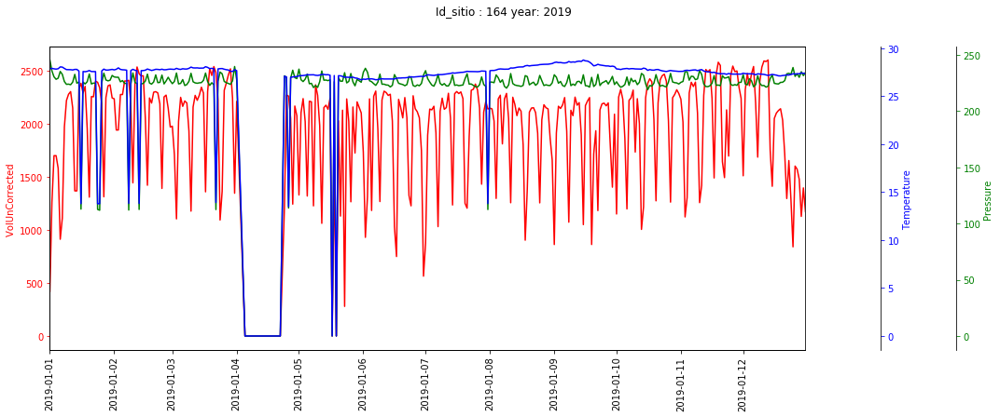

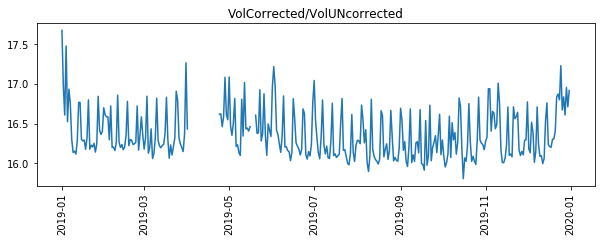

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


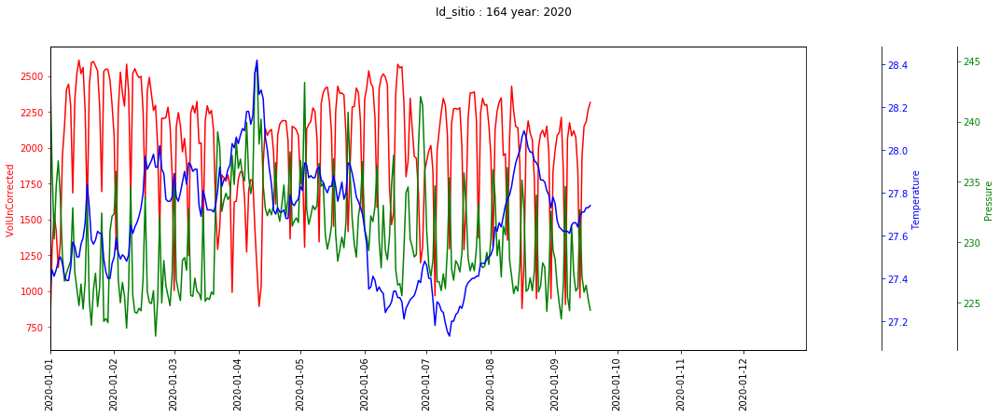

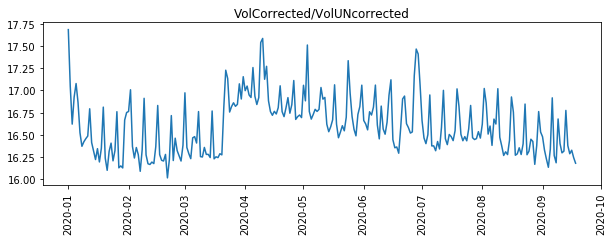

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


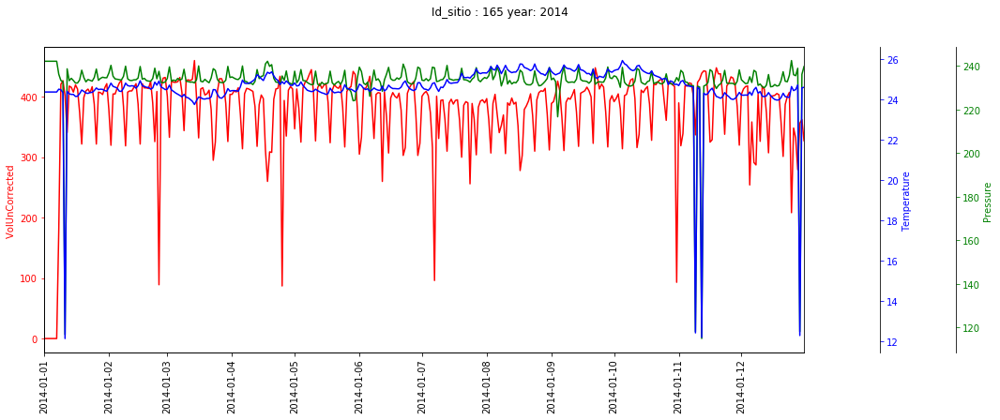

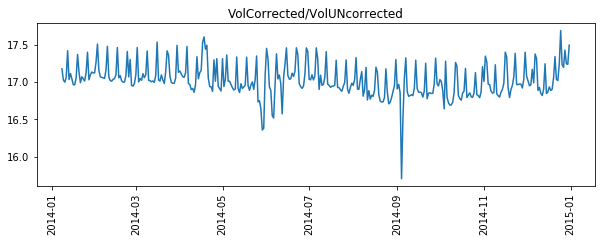

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


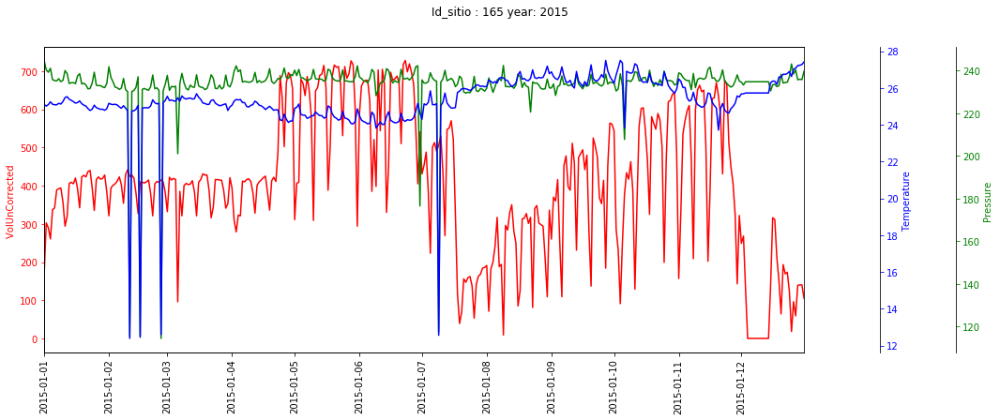

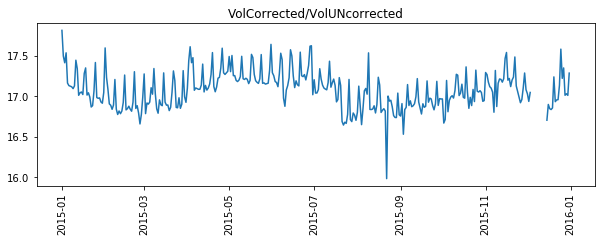

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


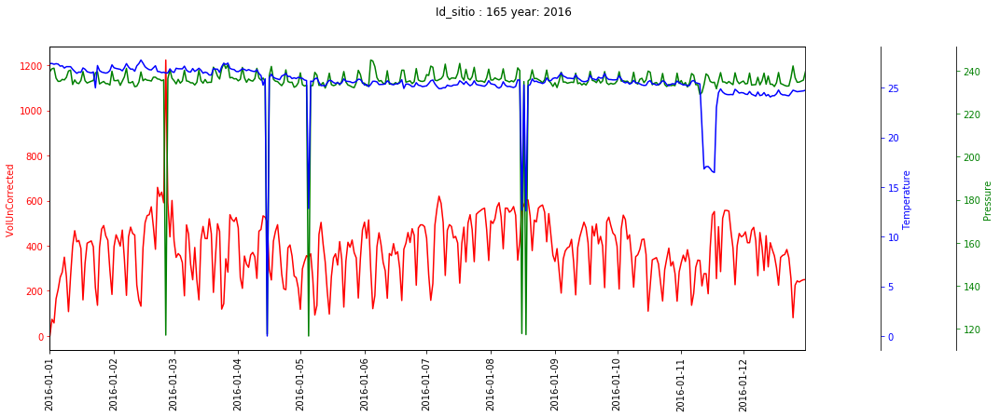

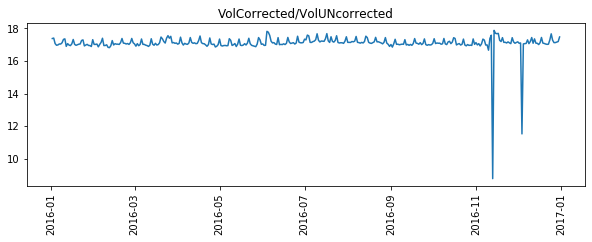

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


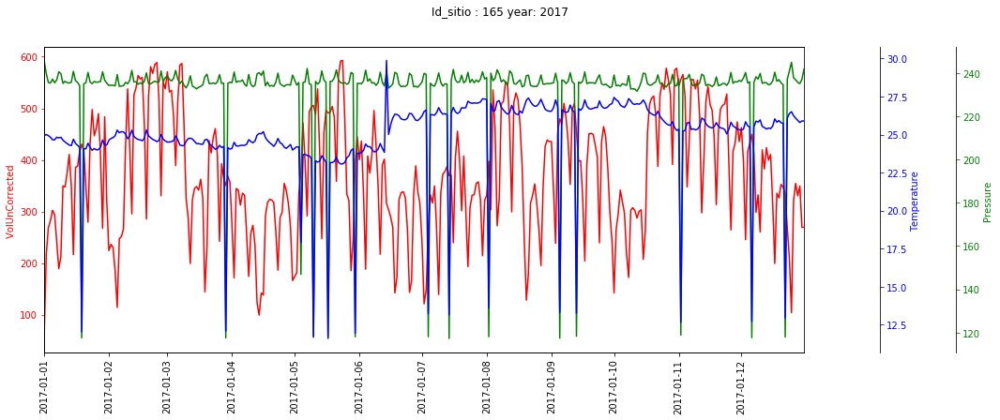

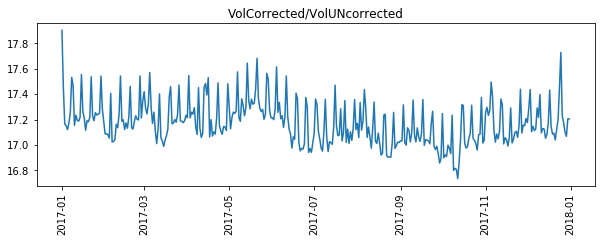

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


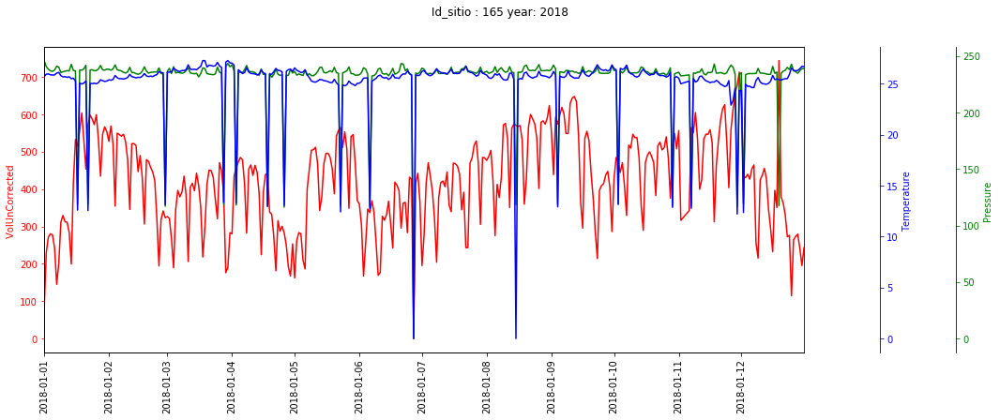

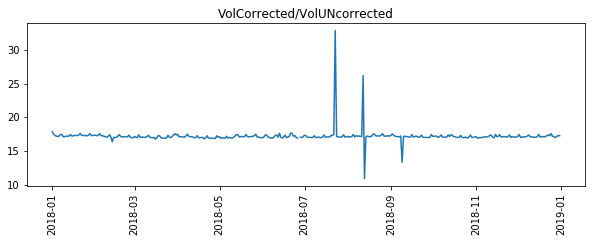

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


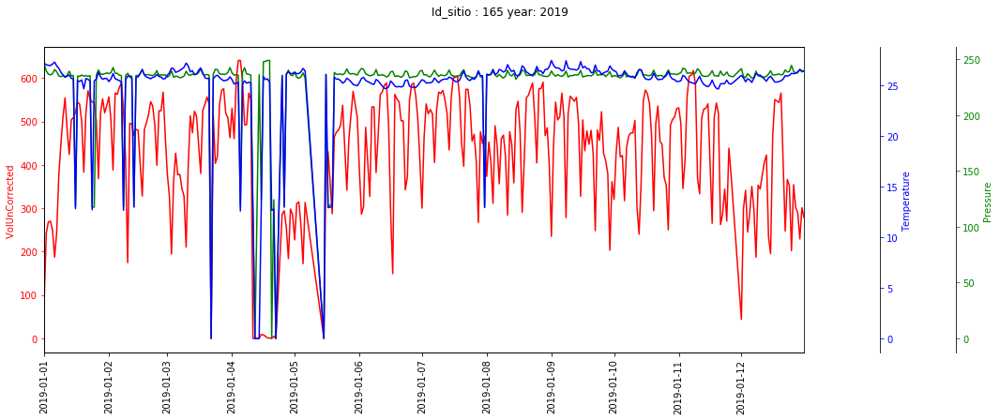

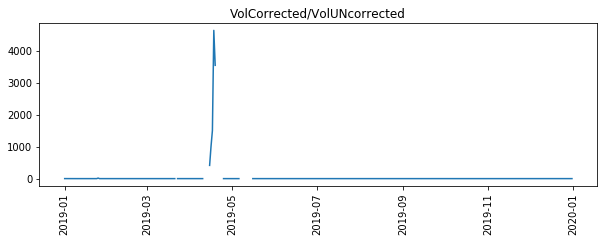

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


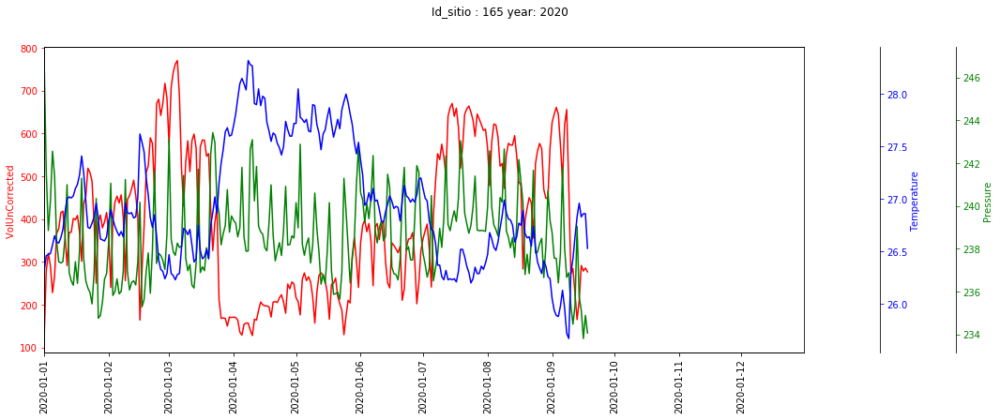

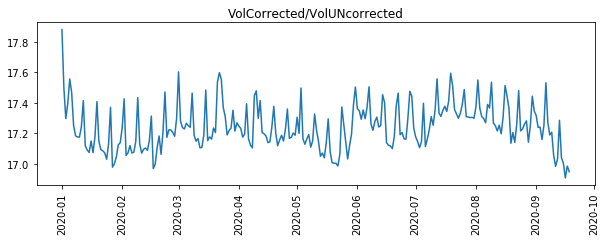

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


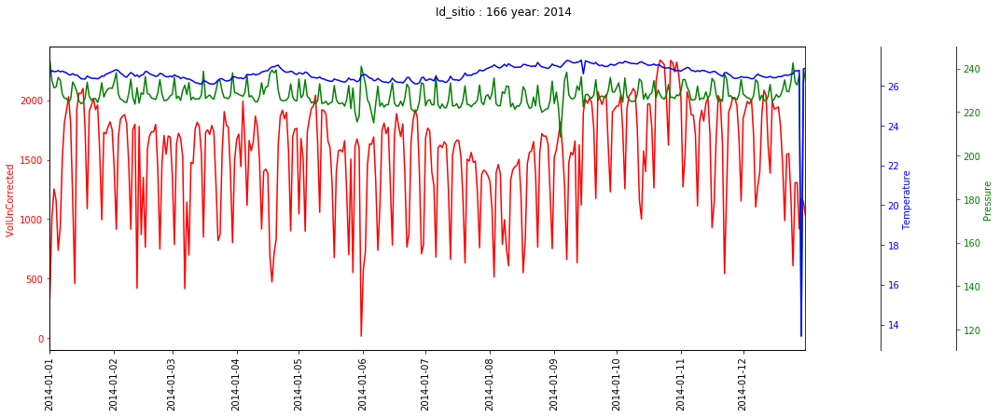

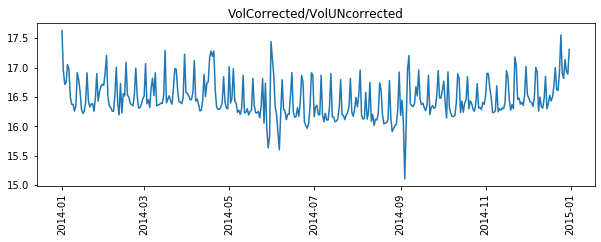

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


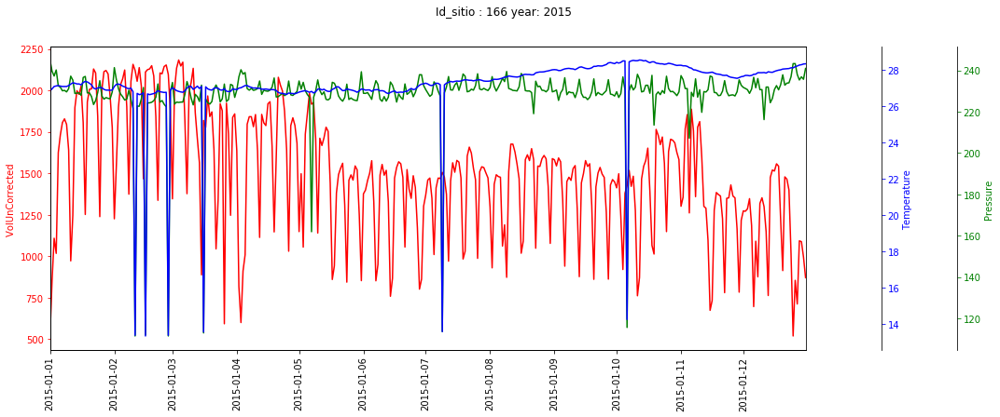

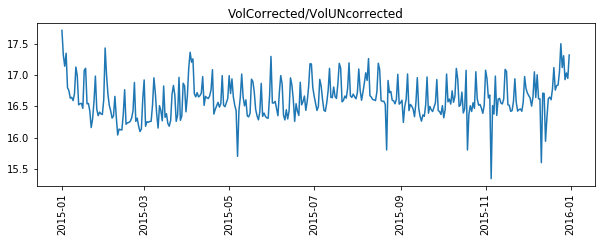

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


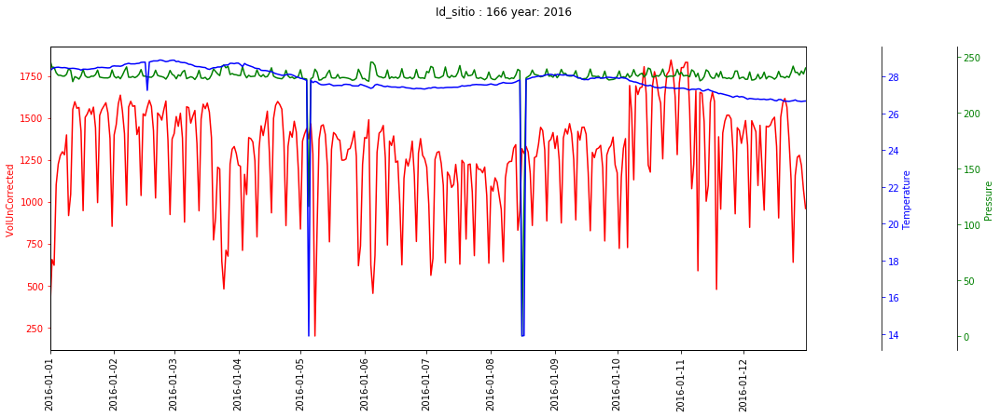

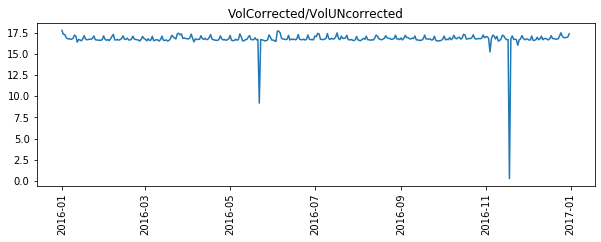

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


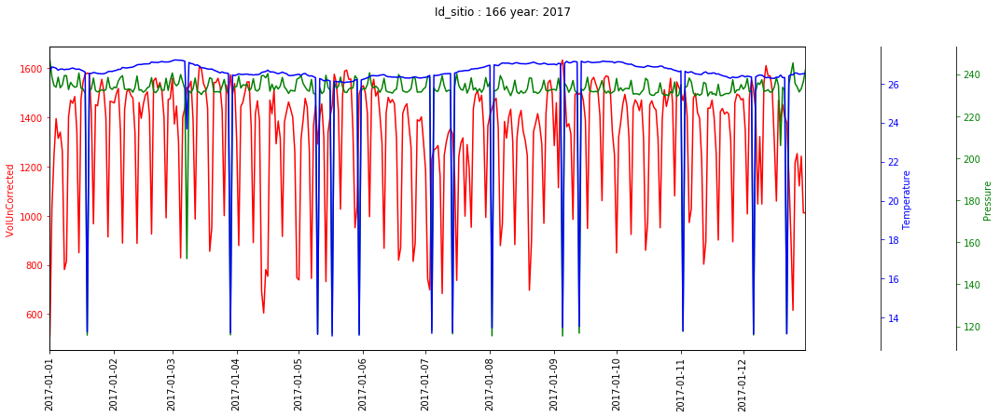

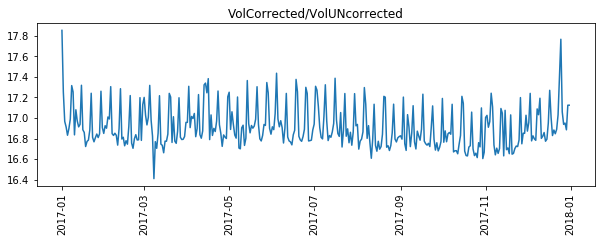

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


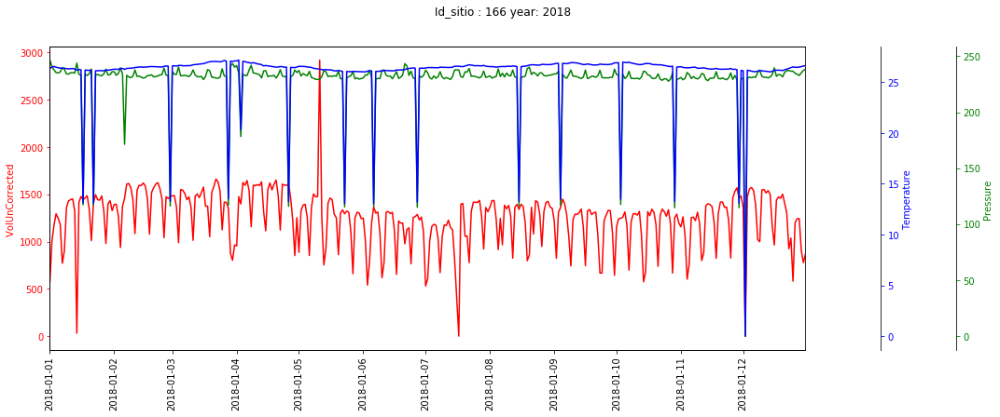

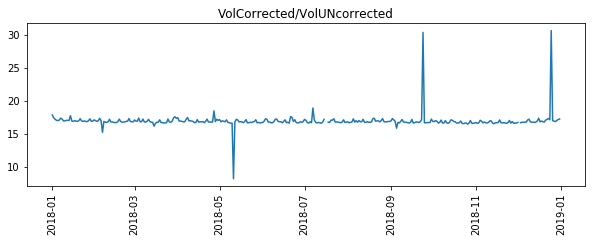

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


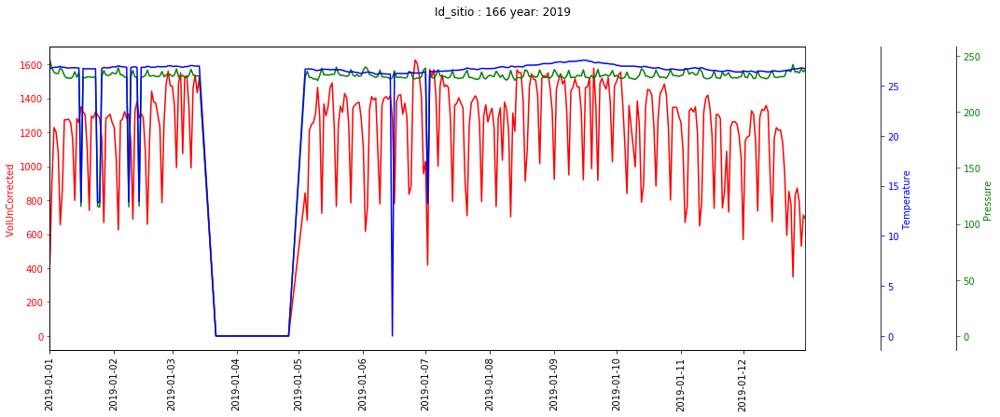

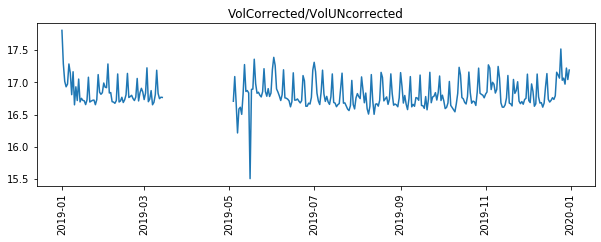

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


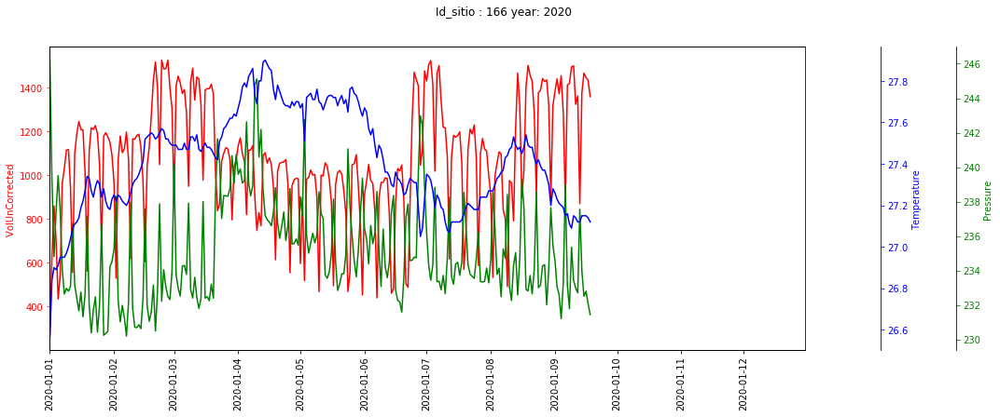

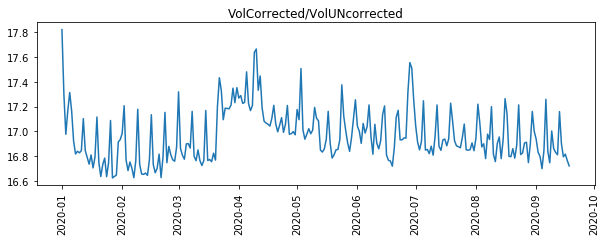

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


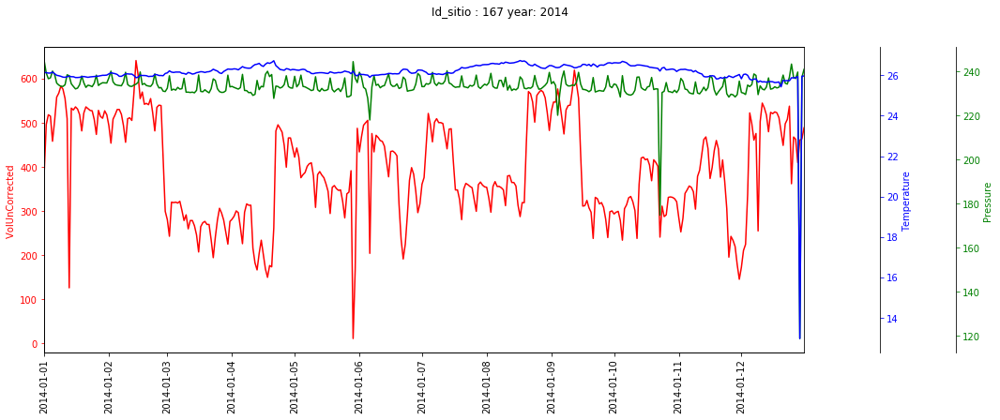

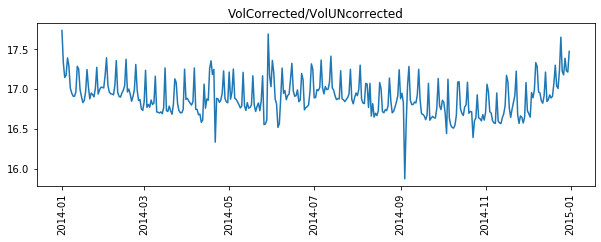

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


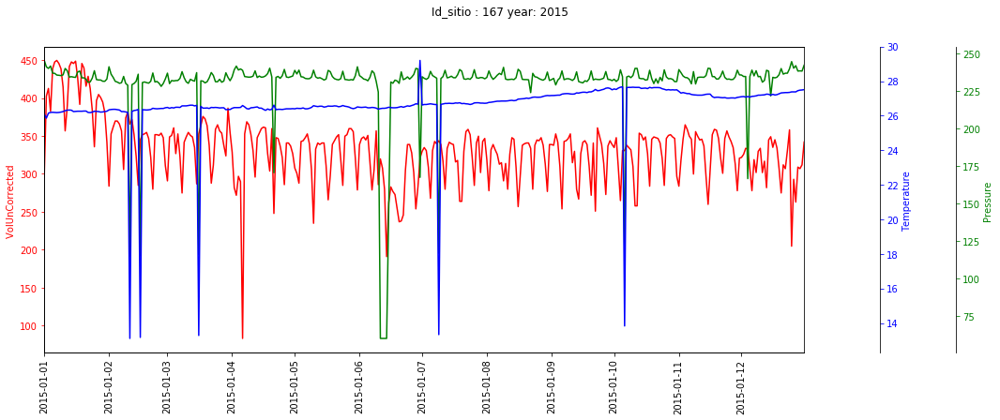

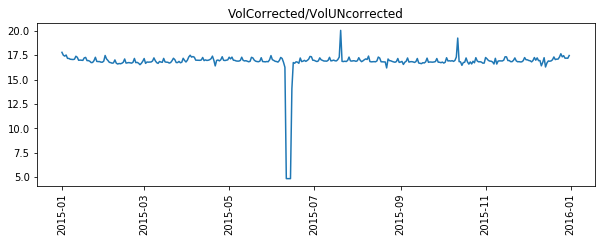

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


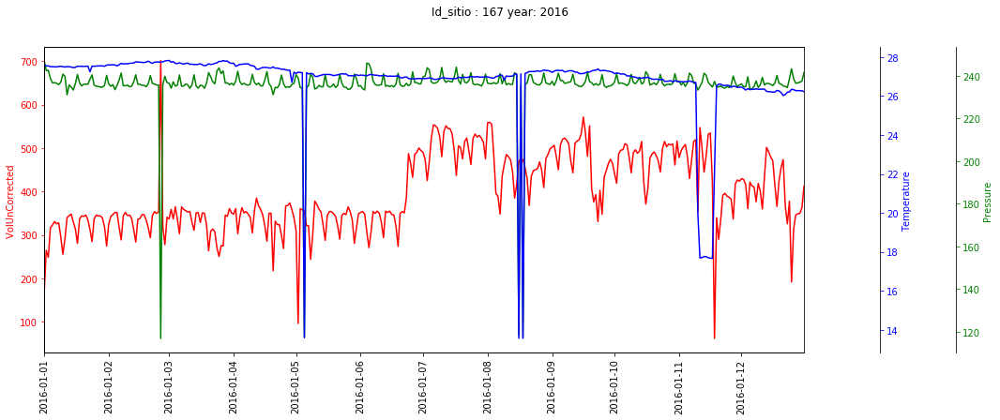

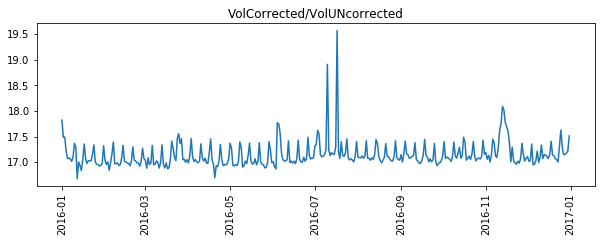

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


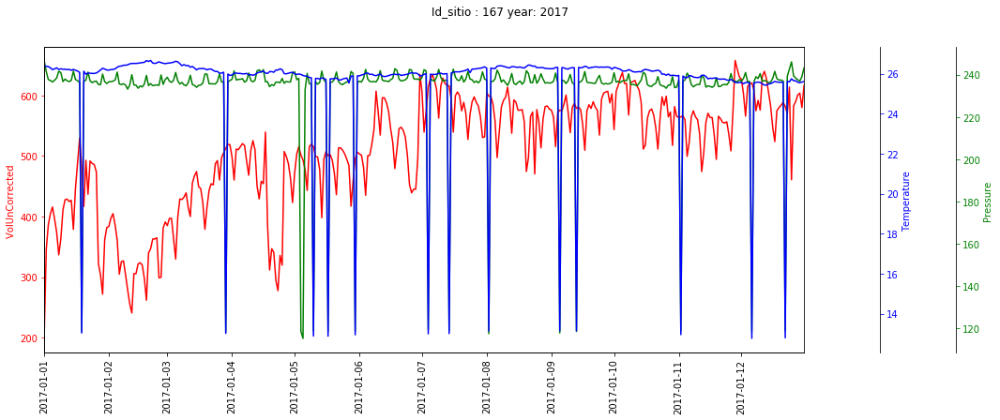

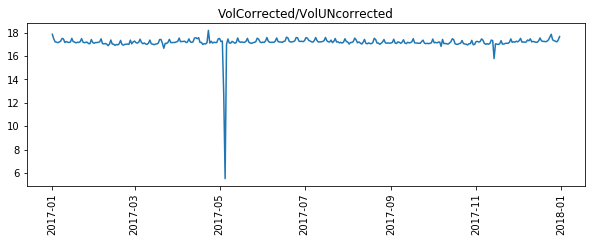

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


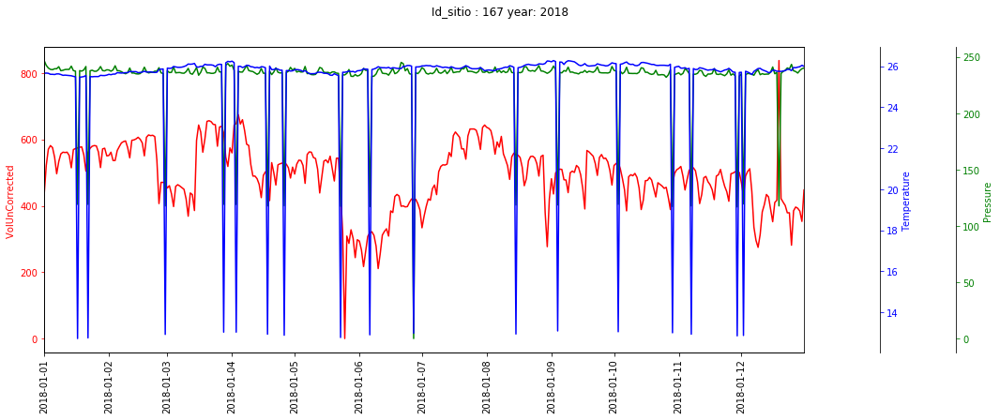

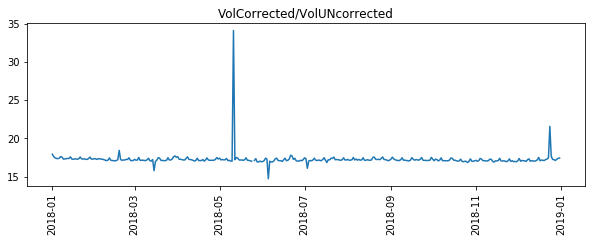

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


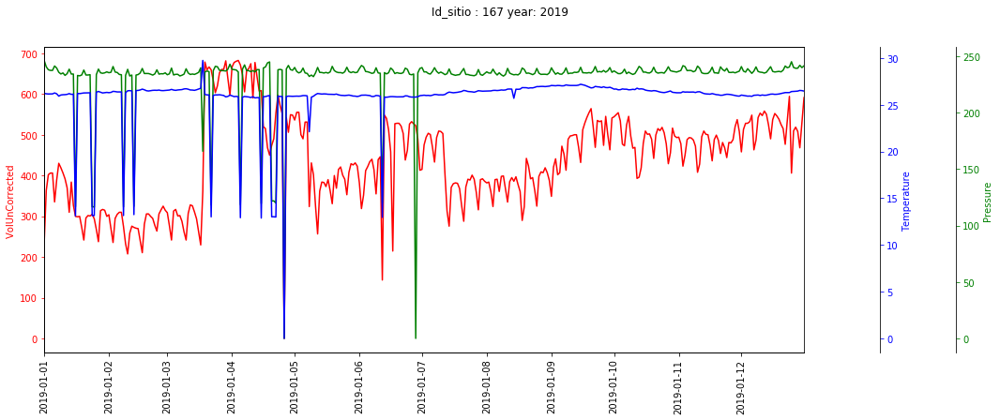

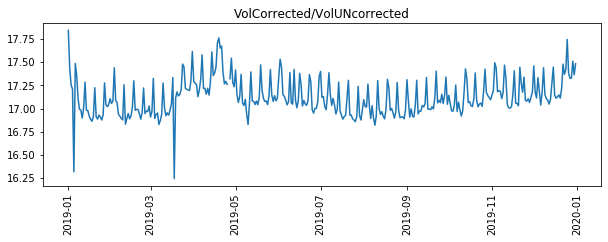

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


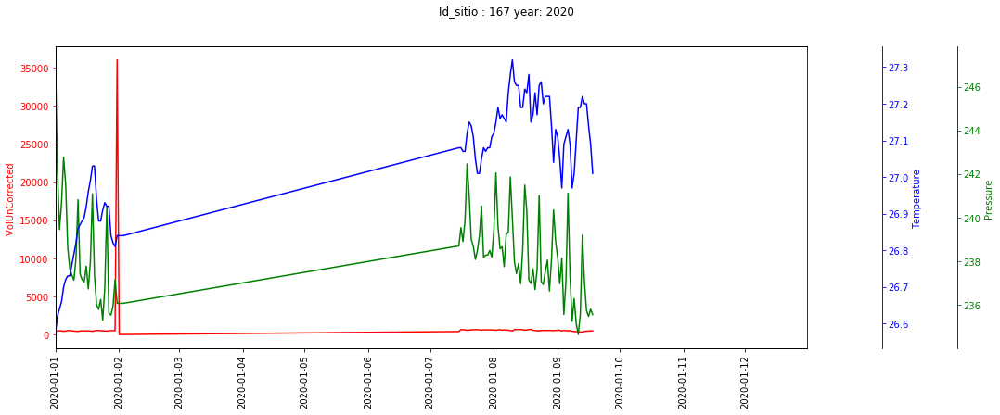

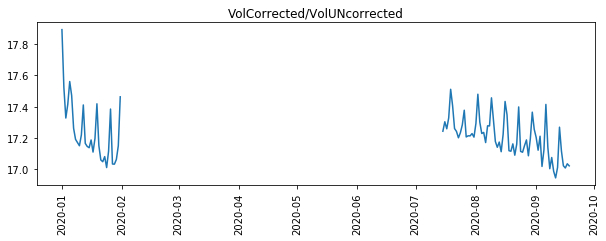

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


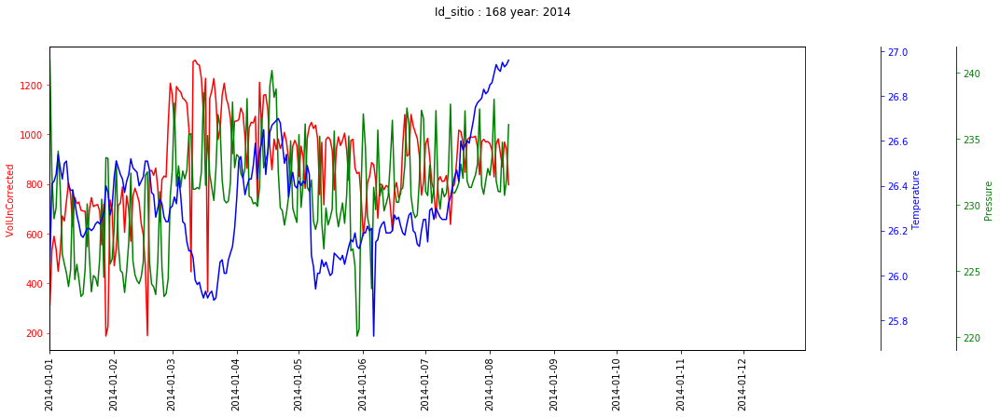

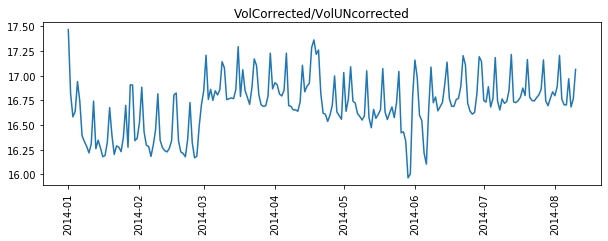

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


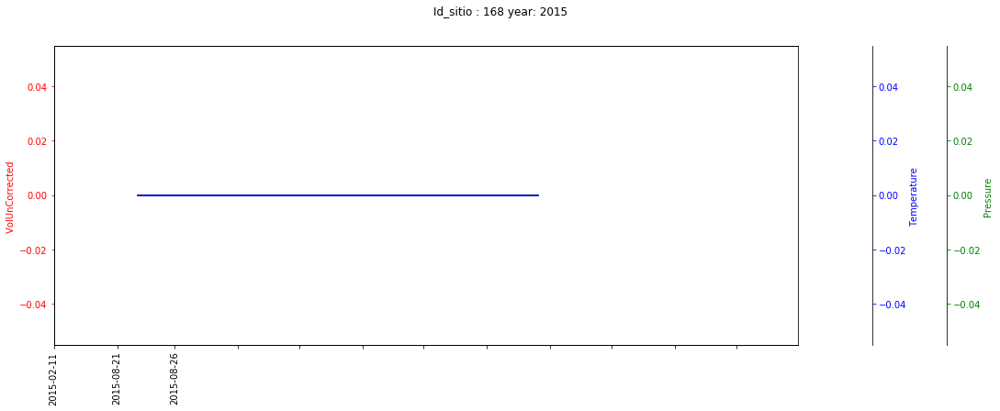

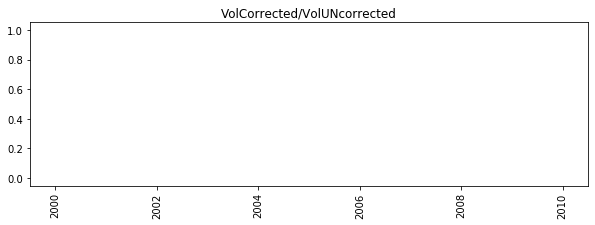

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


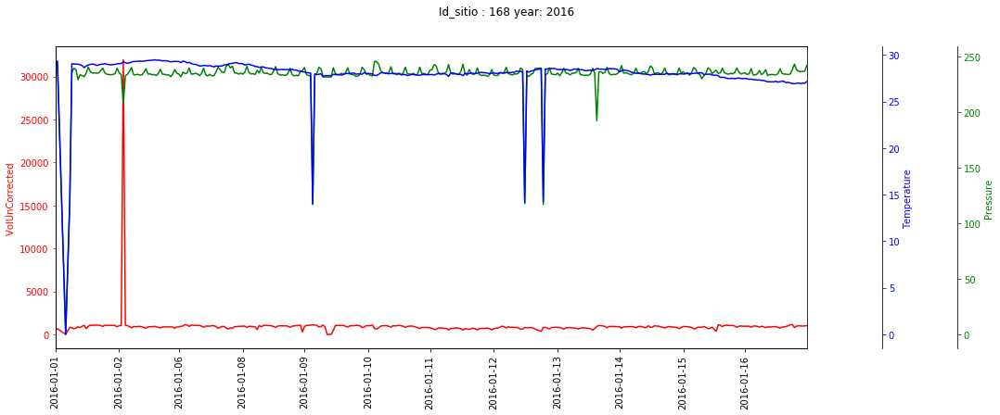

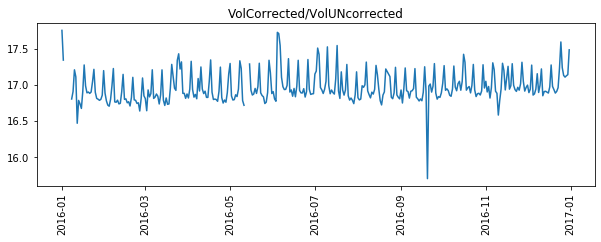

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


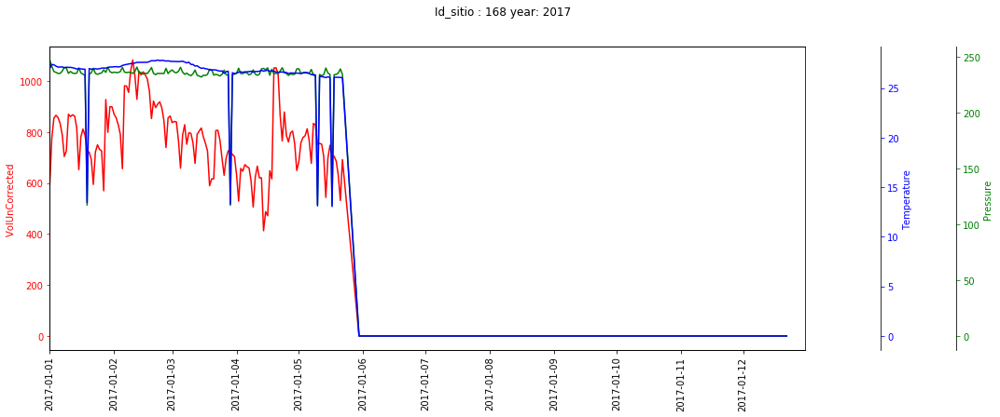

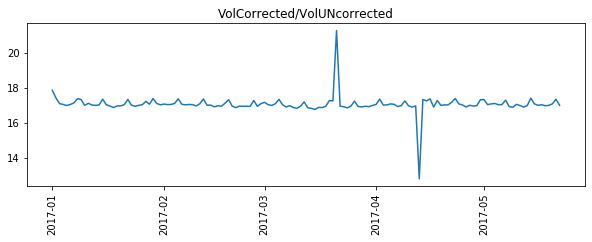

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


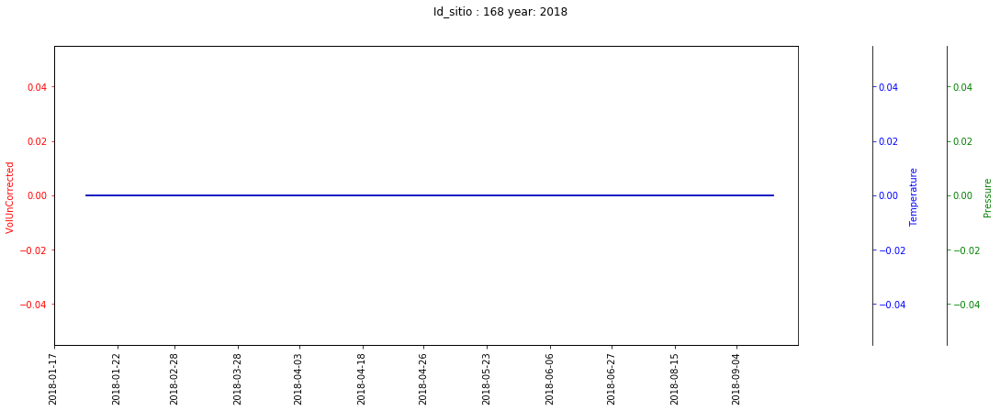

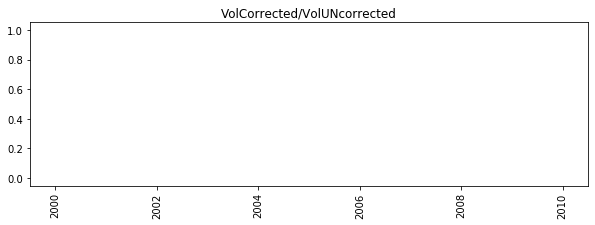

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


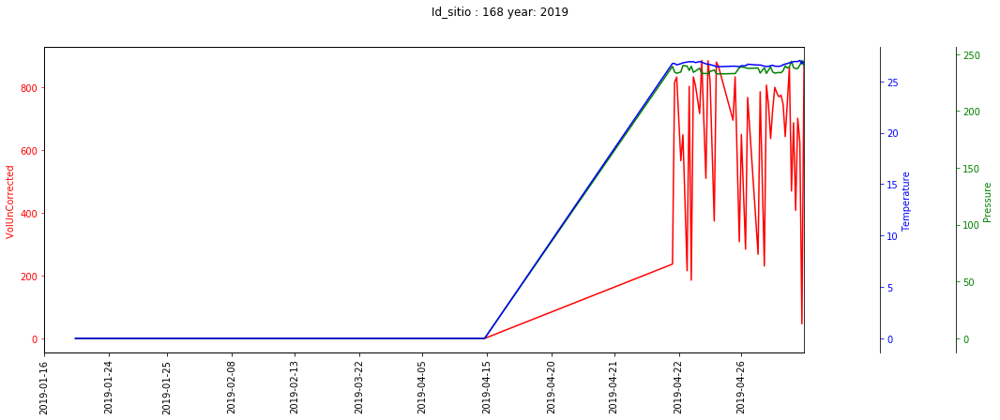

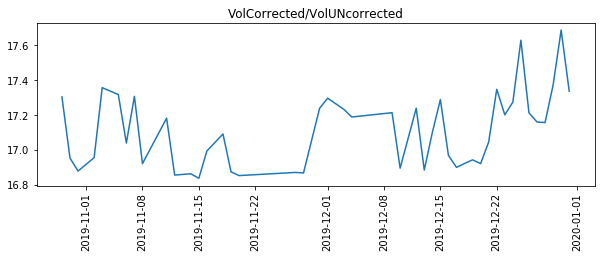

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


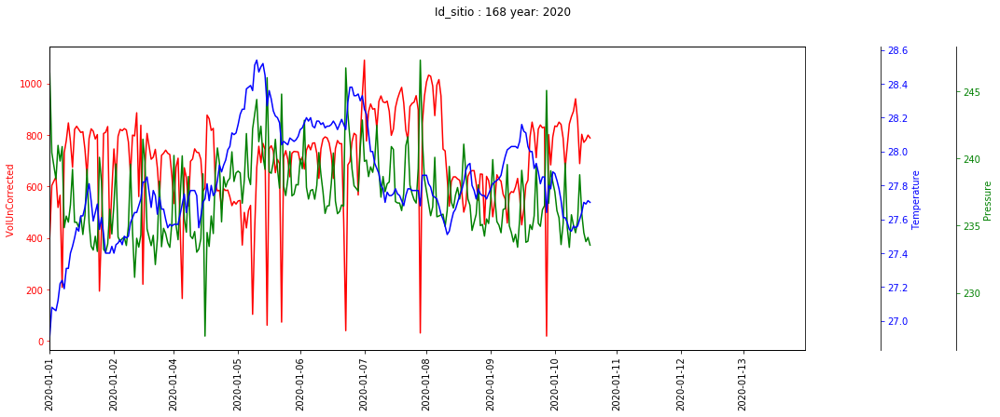

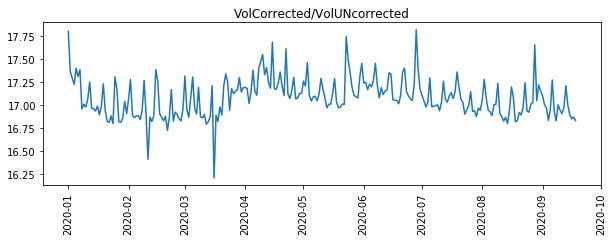

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


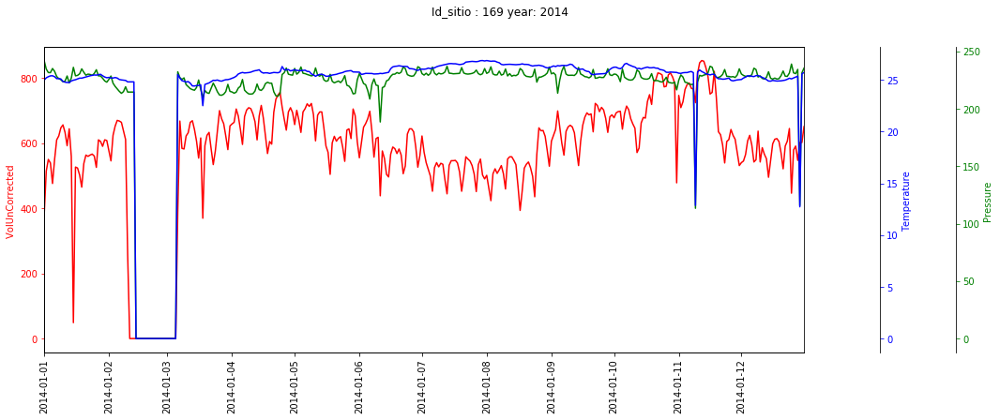

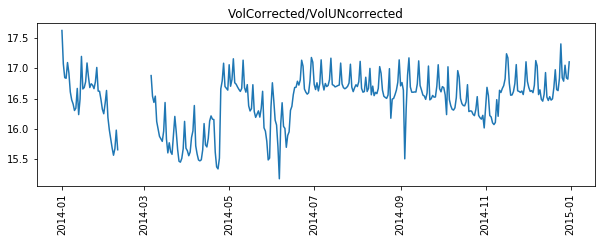

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


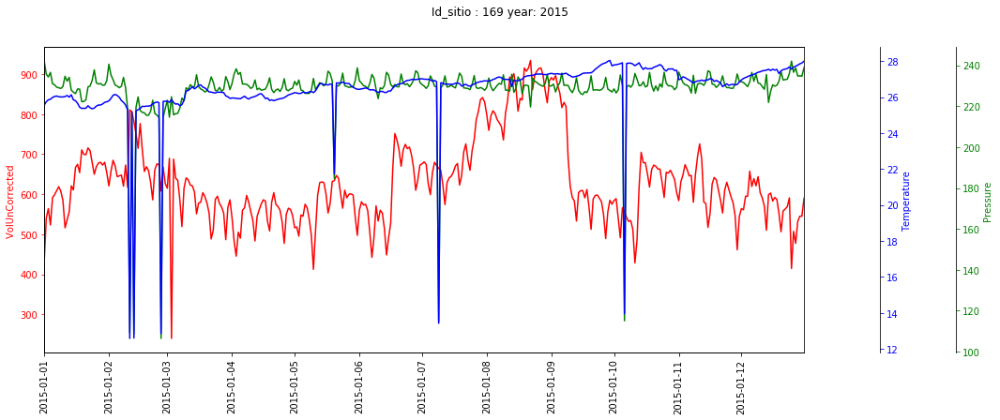

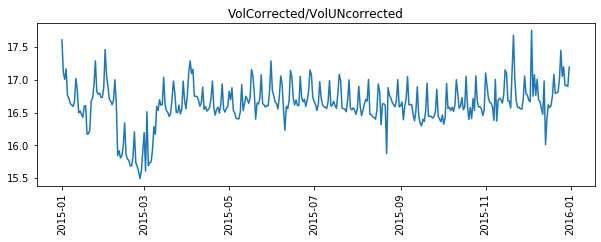

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


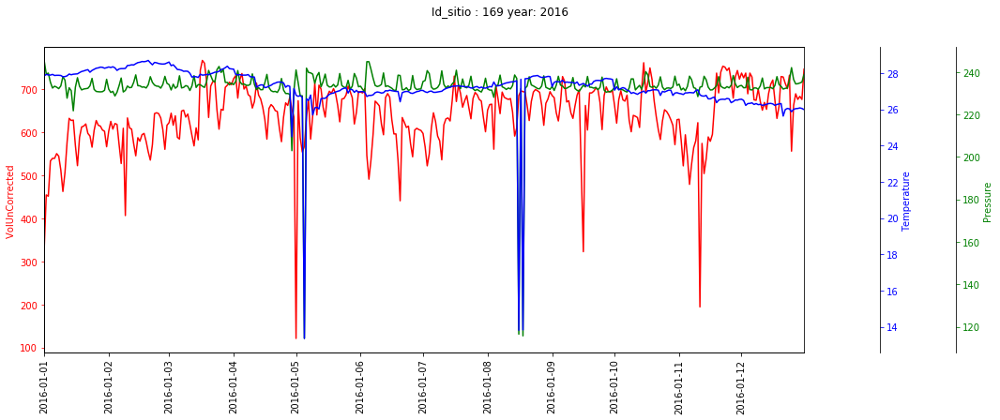

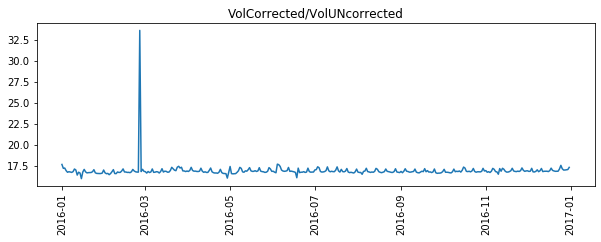

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


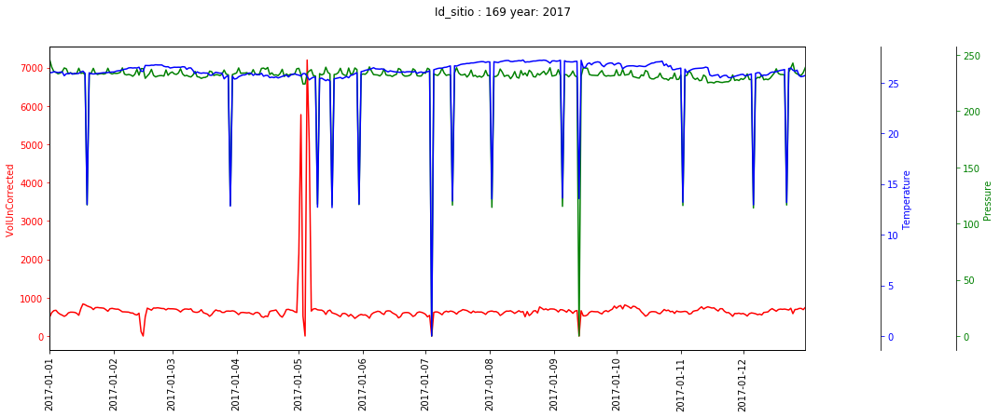

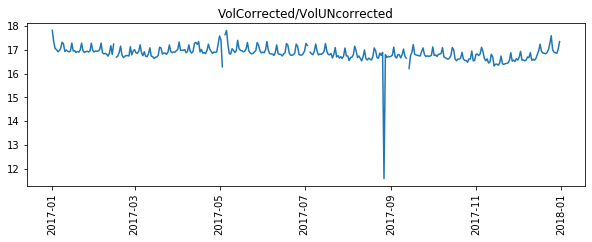

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


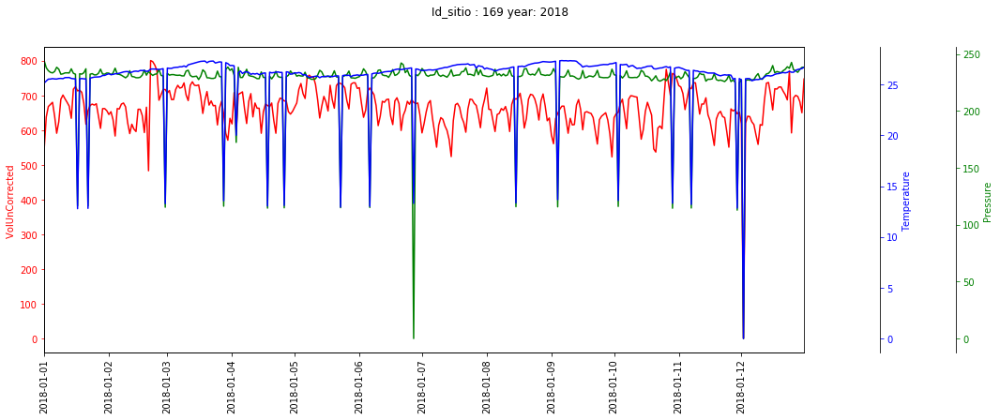

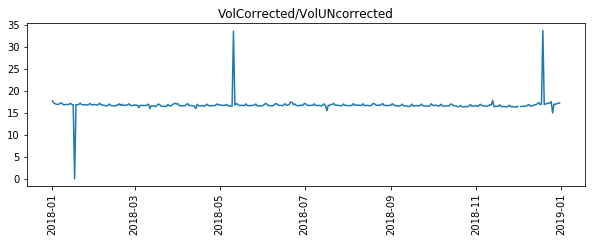

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


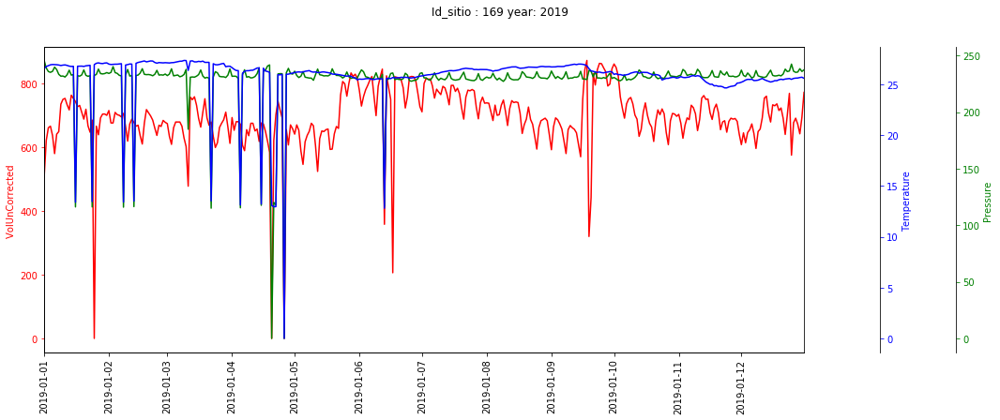

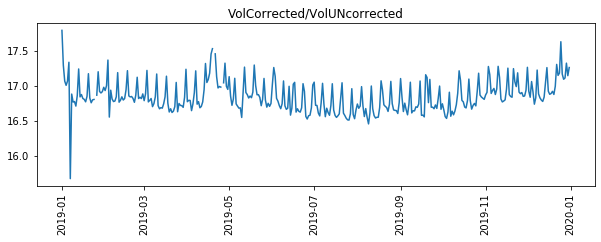

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


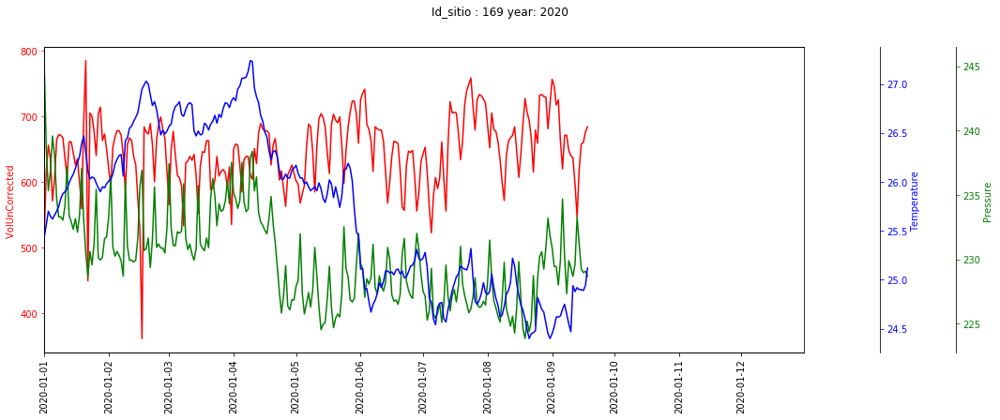

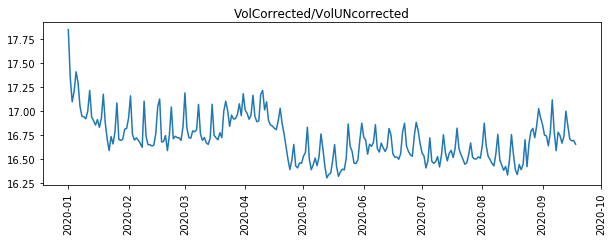

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


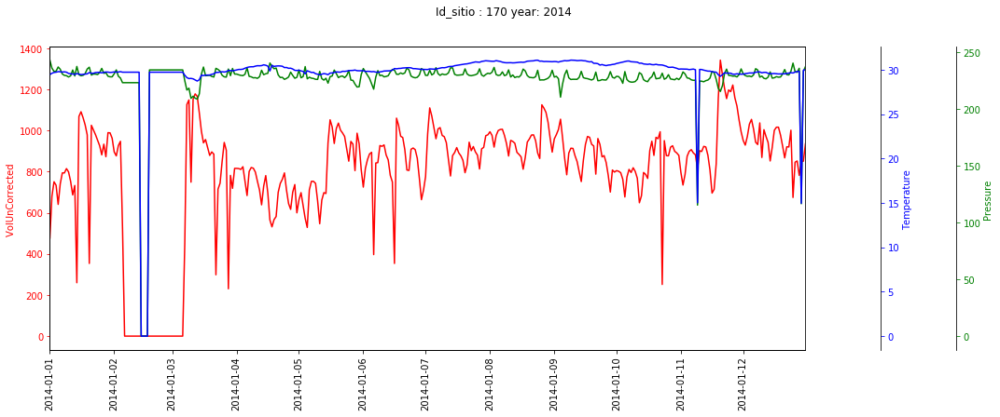

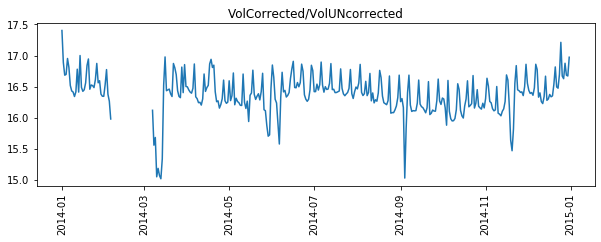

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


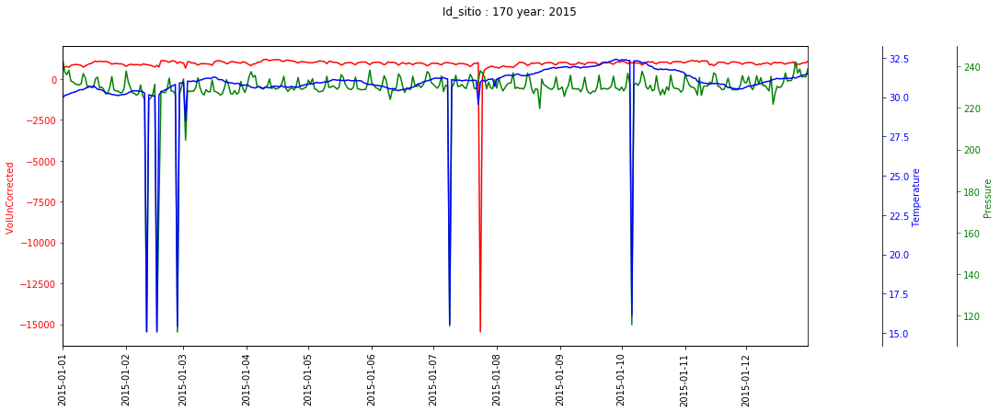

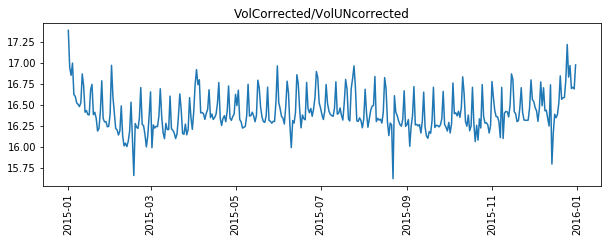

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


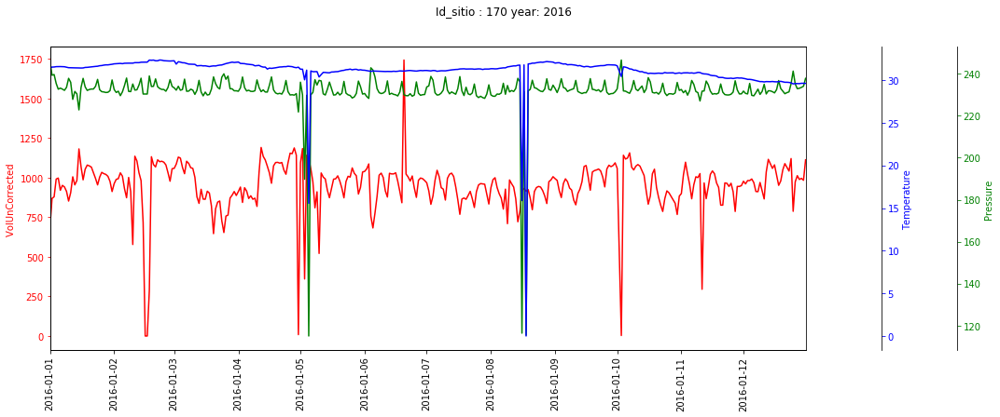

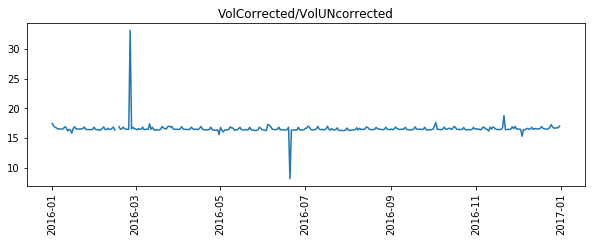

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


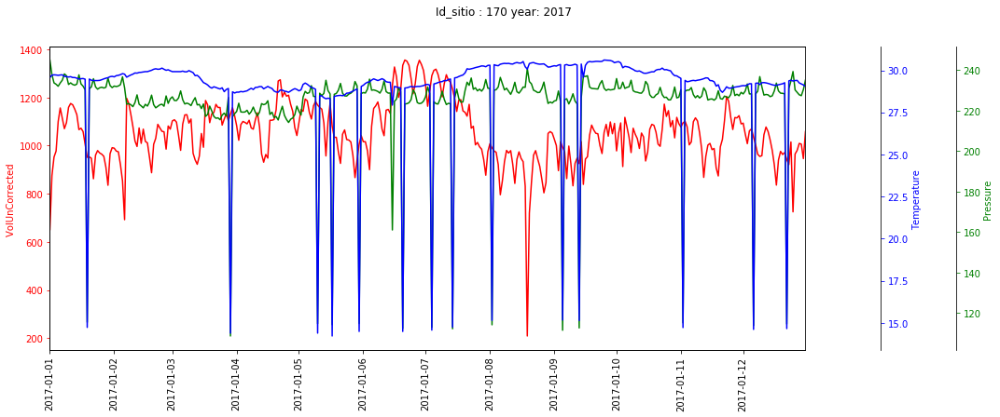

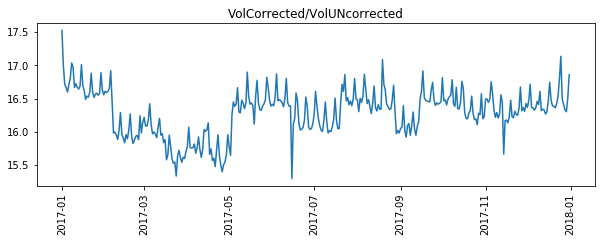

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


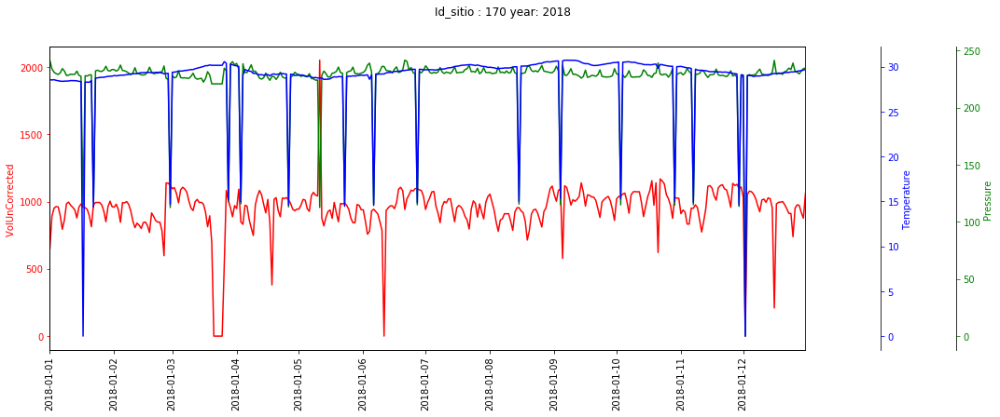

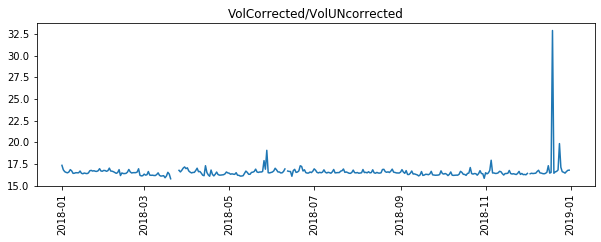

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


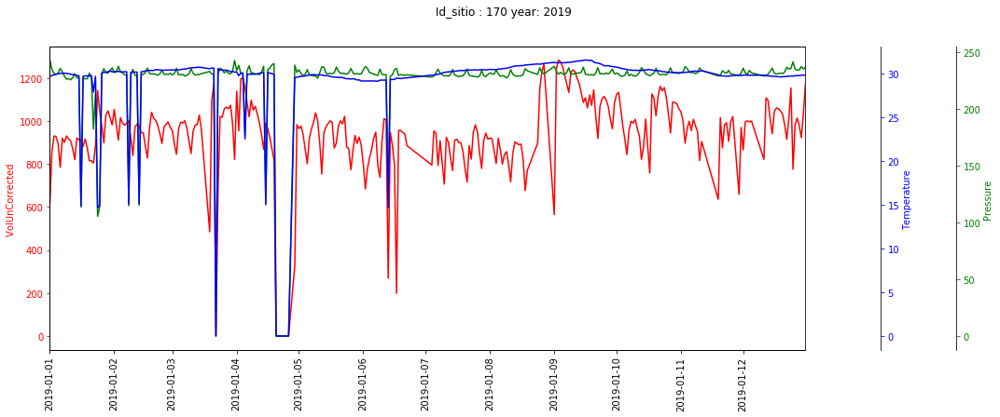

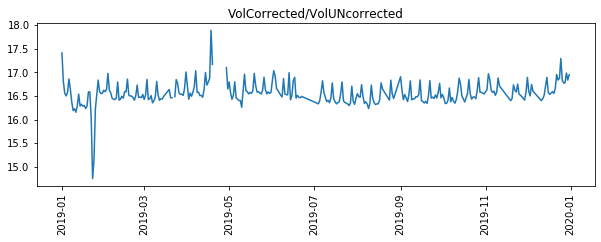

----------------------------------------------------------------------------------------------------
# de valores nulos en la serie VolUnCorrected : 0 VolUnCorrected Series([], Name: VolUnCorrected, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Pressure : 0 Pressure Series([], Name: Pressure, dtype: float64)
----------------------------------------------------------------------------------------------------
# de valores nulos en la serie Temperature : 0 Temperature Series([], Name: Temperature, dtype: float64)


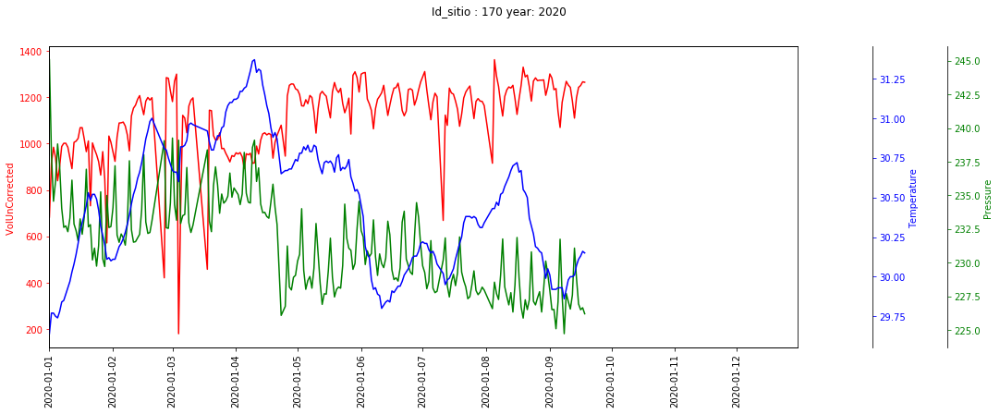

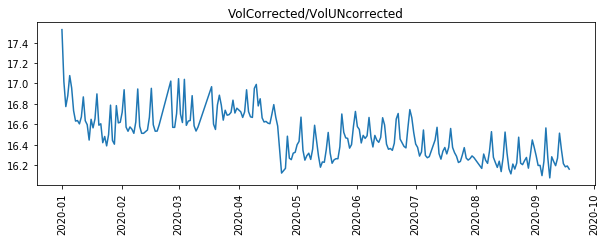

In [27]:
for id_sitio in range(151,171):
    for year in data['Daily_Date'].dt.year.unique():
        todo_en(id_sitio=id_sitio,year = year)

In [28]:
data.columns

Index(['id_sitio', 'corte_evento', 'Daily_Date', 'VolUnCorrected',
       'VolCorrected', 'Pressure', 'Temperature', 'id_RTU', 'Day', 'Year'],
      dtype='object')